## ▶️ Cell 0 — Setup (imports, seed, device)

Why: common imports, reproducibility, and pick CPU/GPU.

In [11]:
# ============================================================
# 🧩 Cell 0 — Setup, imports, seed, and device configuration
# ============================================================

import os, random, time, math
from pathlib import Path
from collections import Counter

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as T
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from PIL import Image, ImageOps

# -----------------------------
# Reproducibility and device
# -----------------------------
def set_seed(seed: int = 42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

set_seed(42)

def get_device():
    """Select MPS (Mac GPU), CUDA, or CPU depending on availability."""
    if torch.backends.mps.is_available():
        return torch.device("mps")
    if torch.cuda.is_available():
        return torch.device("cuda")
    return torch.device("cpu")

device = get_device()
print("✅ Using device:", device)

# -----------------------------
# Folder setup (NEU dataset)
# -----------------------------
BASE_DIR = Path("Data/NEU-DET")
TRAIN_IMG_DIR = BASE_DIR / "train" / "images"
VAL_IMG_DIR   = BASE_DIR / "validation" / "images"

if not TRAIN_IMG_DIR.exists() or not VAL_IMG_DIR.exists():
    raise FileNotFoundError("❌ Check dataset path — 'train/images' or 'validation/images' not found.")

# NEU defect classes (common in defect detection papers)
CLASS_NAMES = ["crazing", "inclusion", "patches", "pitted_surface", "rolled-in_scale", "scratches"]
print("📂 Dataset structure loaded. Classes:", CLASS_NAMES)


✅ Using device: mps
📂 Dataset structure loaded. Classes: ['crazing', 'inclusion', 'patches', 'pitted_surface', 'rolled-in_scale', 'scratches']


✅ Classes discovered: ['crazing', 'inclusion', 'patches', 'pitted_surface', 'rolled-in_scale', 'scratches']
🧮 Train images per class: {'crazing': 240, 'inclusion': 240, 'patches': 240, 'pitted_surface': 240, 'rolled-in_scale': 240, 'scratches': 240}
🧮 Val images per class: {'crazing': 60, 'inclusion': 60, 'patches': 60, 'pitted_surface': 60, 'rolled-in_scale': 60, 'scratches': 60}
📦 Train batches: 45 | Val batches: 12


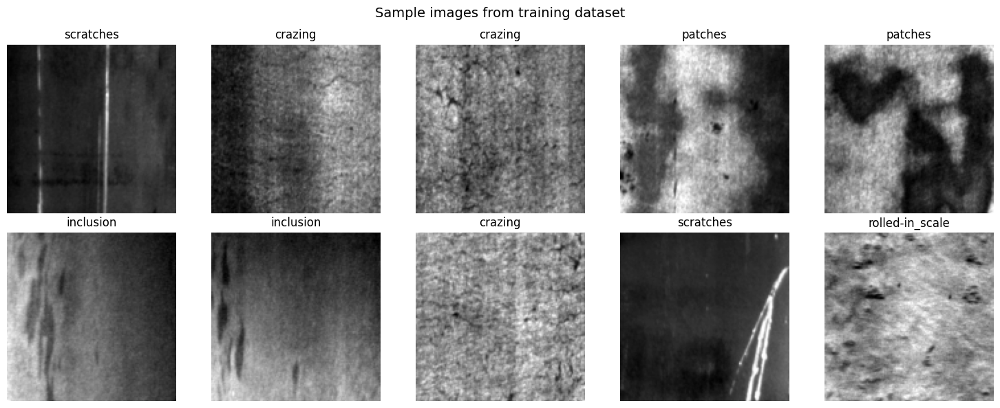

In [12]:
# ============================================================
# 🧩 Cell 1 — Dataset setup and transforms
# ============================================================

from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import torchvision.transforms as T
from collections import Counter

# -----------------------------
# Common transform parameters
# -----------------------------
IMG_SIZE   = 128   # for classifier and GAN base images
BATCH_SIZE = 32
AUGMENT    = False # can toggle ON later for augmentation experiments
USE_RGB    = False # NEU is grayscale, but pipeline supports RGB if needed

# -----------------------------
# Define training and validation transforms
# -----------------------------
def make_transforms(img_size=128, augment=False, use_rgb=False):
    """
    Defines preprocessing:
    - Convert to grayscale or RGB
    - Resize
    - Optional augmentation
    - Convert to tensor
    - (Optionally) normalize
    """
    transform_list = []
    
    if use_rgb:
        transform_list.append(T.Lambda(lambda im: im.convert("RGB")))
    else:
        transform_list.append(T.Grayscale(num_output_channels=1))
    
    transform_list.append(T.Resize((img_size, img_size)))
    
    if augment:
        transform_list += [T.RandomHorizontalFlip(p=0.5)]
    
    transform_list.append(T.ToTensor())
    
    return T.Compose(transform_list)

train_tfms = make_transforms(IMG_SIZE, AUGMENT, USE_RGB)
val_tfms   = make_transforms(IMG_SIZE, False, USE_RGB)

# -----------------------------
# Load datasets and dataloaders
# -----------------------------
ds_train = ImageFolder(TRAIN_IMG_DIR, transform=train_tfms)
ds_val   = ImageFolder(VAL_IMG_DIR, transform=val_tfms)

train_loader = DataLoader(ds_train, batch_size=BATCH_SIZE, shuffle=True,  num_workers=0)
val_loader   = DataLoader(ds_val,   batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

# -----------------------------
# Print basic dataset info
# -----------------------------
def count_per_class(dataset):
    counts = Counter(dataset.targets)
    return {dataset.classes[i]: counts.get(i, 0) for i in range(len(dataset.classes))}

print("✅ Classes discovered:", ds_train.classes)
print("🧮 Train images per class:", count_per_class(ds_train))
print("🧮 Val images per class:", count_per_class(ds_val))
print(f"📦 Train batches: {len(train_loader)} | Val batches: {len(val_loader)}")

# -----------------------------
# Quick visualization
# -----------------------------
import matplotlib.pyplot as plt
import random

def show_image_grid(dataset, nrows=2, ncols=5):
    """Displays a random grid of transformed images."""
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols*3, nrows*3))
    for ax in axes.flatten():
        img, label = random.choice(dataset)
        img_np = img.permute(1,2,0).numpy()
        img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min() + 1e-8)
        ax.imshow(img_np.squeeze(), cmap="gray" if not USE_RGB else None)
        ax.set_title(dataset.classes[label])
        ax.axis("off")
    plt.suptitle("Sample images from training dataset", fontsize=14)
    plt.tight_layout()
    plt.show()

show_image_grid(ds_train)


In [13]:
# ============================================================
# 🧩 Cell 2 — Baseline Classifier for Defect Recognition
# ============================================================

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import numpy as np

# -----------------------------
# Hyperparameters
# -----------------------------
IMG_SIZE_CLS = 32   # smaller input for classifier speed
EPOCHS_CLS   = 12
LR_CLS       = 1e-3
BATCH_SIZE_CLS = 32

# -----------------------------
# Classifier architecture
# -----------------------------
class SimpleCNN32(nn.Module):
    """
    Simple defect classifier:
    Input: 1x32x32
    Output: class logits (6 classes)
    Layers:
      Conv2d → BatchNorm → ReLU → Downsample
      Repeated 4x, then global pooling + Linear head
    """
    def __init__(self, in_ch=1, num_classes=len(CLASS_NAMES), width=24, p_drop=0.2):
        super().__init__()
        w = width
        self.features = nn.Sequential(
            nn.Conv2d(in_ch, w, 3, 2, 1), nn.BatchNorm2d(w), nn.ReLU(True),   # -> 16×16
            nn.Conv2d(w, w*2, 3, 2, 1),  nn.BatchNorm2d(w*2), nn.ReLU(True), # -> 8×8
            nn.Conv2d(w*2, w*2, 3, 2, 1),nn.BatchNorm2d(w*2), nn.ReLU(True), # -> 4×4
            nn.Conv2d(w*2, w*4, 3, 1, 1),nn.BatchNorm2d(w*4), nn.ReLU(True), # -> 4×4
            nn.AdaptiveAvgPool2d(1),
        )
        self.dropout = nn.Dropout(p_drop)
        self.fc = nn.Linear(w*4, num_classes)
        
    def forward(self, x):
        x = self.features(x).flatten(1)
        x = self.dropout(x)
        return self.fc(x)

# -----------------------------
# Training & evaluation loops
# -----------------------------
def accuracy(logits, y):
    return (logits.argmax(1) == y).float().mean().item()

@torch.no_grad()
def evaluate(model, loader, loss_fn):
    model.eval()
    total_loss, total_acc, n = 0, 0, 0
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        logits = model(xb)
        loss = loss_fn(logits, yb)
        total_loss += loss.item() * xb.size(0)
        total_acc  += accuracy(logits, yb) * xb.size(0)
        n += xb.size(0)
    return total_loss / n, total_acc / n

# -----------------------------
# Prepare smaller 32×32 dataloaders
# -----------------------------
cls_train_tf = T.Compose([
    T.Grayscale(1),
    T.Resize((IMG_SIZE_CLS, IMG_SIZE_CLS)),
    T.Lambda(lambda im: ImageOps.autocontrast(im)),
    T.ToTensor()
])
cls_val_tf = cls_train_tf

ds_cls_train = ImageFolder(TRAIN_IMG_DIR, transform=cls_train_tf)
ds_cls_val   = ImageFolder(VAL_IMG_DIR,   transform=cls_val_tf)

train_loader_cls = DataLoader(ds_cls_train, batch_size=BATCH_SIZE_CLS, shuffle=True)
val_loader_cls   = DataLoader(ds_cls_val,   batch_size=BATCH_SIZE_CLS, shuffle=False)

# -----------------------------
# Train the classifier
# -----------------------------
model_cls = SimpleCNN32().to(device)
optimizer = optim.Adam(model_cls.parameters(), lr=LR_CLS, weight_decay=1e-4)
loss_fn   = nn.CrossEntropyLoss(label_smoothing=0.1)

best_acc, patience, patience_limit = 0.0, 3, 3
train_accs, val_accs = [], []

for epoch in range(1, EPOCHS_CLS + 1):
    model_cls.train()
    correct, total = 0, 0
    for xb, yb in train_loader_cls:
        xb, yb = xb.to(device), yb.to(device)
        optimizer.zero_grad()
        logits = model_cls(xb)
        loss = loss_fn(logits, yb)
        loss.backward()
        optimizer.step()
        correct += (logits.argmax(1) == yb).sum().item()
        total += xb.size(0)
    
    train_acc = correct / total
    val_loss, val_acc = evaluate(model_cls, val_loader_cls, loss_fn)
    train_accs.append(train_acc); val_accs.append(val_acc)
    
    print(f"Epoch {epoch:02d}/{EPOCHS_CLS} — Train Acc: {train_acc:.3f} | Val Acc: {val_acc:.3f}")
    
    # Early stopping
    if val_acc > best_acc:
        best_acc = val_acc
        patience = patience_limit
        best_state = {k: v.cpu() for k, v in model_cls.state_dict().items()}
    else:
        patience -= 1
        if patience == 0:
            print("⏹️ Early stopping triggered.")
            break

# Restore best weights
model_cls.load_state_dict({k: v.to(device) for k, v in best_state.items()})
print(f"✅ Best Validation Accuracy: {best_acc:.3f}")


Epoch 01/12 — Train Acc: 0.537 | Val Acc: 0.397
Epoch 02/12 — Train Acc: 0.735 | Val Acc: 0.594
Epoch 03/12 — Train Acc: 0.836 | Val Acc: 0.783
Epoch 04/12 — Train Acc: 0.880 | Val Acc: 0.769
Epoch 05/12 — Train Acc: 0.892 | Val Acc: 0.872
Epoch 06/12 — Train Acc: 0.917 | Val Acc: 0.825
Epoch 07/12 — Train Acc: 0.933 | Val Acc: 0.850
Epoch 08/12 — Train Acc: 0.954 | Val Acc: 0.850
⏹️ Early stopping triggered.
✅ Best Validation Accuracy: 0.872


In [14]:
# ============================================================
# 🧩 Cell 3 — Conditional GAN (cGAN) Architecture
# ============================================================

import torch
import torch.nn as nn
import torch.optim as optim

# -----------------------------
# Hyperparameters
# -----------------------------
Z_DIM     = 64    # noise vector dimension
EMB_DIM   = 64    # embedding size for class condition
WIDTH_G   = 64    # generator base width
WIDTH_D   = 64    # discriminator base width
EPOCHS_GAN = 200
BATCH_SIZE_GAN = 64

# -----------------------------
# Conditional Generator
# -----------------------------
class Generator(nn.Module):
    """
    Conditional Generator:
      Input: noise z (B, Z_DIM) + class embedding (B, EMB_DIM)
      Output: fake defect image (B, 1, 32, 32)
    Architecture: Linear → ConvTranspose blocks → Tanh
    """
    def __init__(self, z_dim=Z_DIM, n_classes=len(CLASS_NAMES), emb_dim=EMB_DIM, width=WIDTH_G):
        super().__init__()
        self.embed = nn.Embedding(n_classes, emb_dim)
        in_dim = z_dim + emb_dim
        self.net = nn.Sequential(
            nn.Linear(in_dim, 4*4*width*4),
            nn.BatchNorm1d(4*4*width*4), nn.ReLU(True),
            nn.Unflatten(1, (width*4, 4, 4)),
            nn.ConvTranspose2d(width*4, width*2, 4, 2, 1),
            nn.BatchNorm2d(width*2), nn.ReLU(True),
            nn.ConvTranspose2d(width*2, width, 4, 2, 1),
            nn.BatchNorm2d(width), nn.ReLU(True),
            nn.ConvTranspose2d(width, 1, 4, 2, 1),
            nn.Tanh()  # output in [-1,1]
        )

    def forward(self, z, y):
        yemb = self.embed(y)
        x = torch.cat([z, yemb], dim=1)
        return self.net(x)

# -----------------------------
# Projection Discriminator
# -----------------------------
def SN(m): return nn.utils.spectral_norm(m)

class ProjectionDiscriminator(nn.Module):
    """
    Conditional Discriminator:
      Uses projection trick for conditioning.
      Learns to classify real/fake while incorporating label embedding.
    """
    def __init__(self, n_classes=len(CLASS_NAMES), width=WIDTH_D):
        super().__init__()
        c = width
        self.features = nn.Sequential(
            SN(nn.Conv2d(1, c, 3, 2, 1)), nn.LeakyReLU(0.2, inplace=True),
            SN(nn.Conv2d(c, c*2, 3, 2, 1)), nn.LeakyReLU(0.2, inplace=True),
            SN(nn.Conv2d(c*2, c*4, 3, 2, 1)), nn.LeakyReLU(0.2, inplace=True),
            SN(nn.Conv2d(c*4, c*4, 3, 1, 1)), nn.LeakyReLU(0.2, inplace=True),
        )
        self.fc = SN(nn.Linear(c*4, 1))
        self.embed = nn.Embedding(n_classes, c*4)

    def forward(self, x, y):
        h = self.features(x).sum(dim=(2,3))  # global sum pooling
        output = self.fc(h).squeeze(1)
        proj = (self.embed(y) * h).sum(dim=1)  # projection term for conditional discrimination
        return output + proj

print("✅ cGAN architecture ready — Generator & Discriminator defined.")


✅ cGAN architecture ready — Generator & Discriminator defined.


In [15]:
# ==== GAN setup prerequisites (run before training) ====
import torch, torchvision.transforms as T
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
from PIL import Image, ImageOps

# device
device = (
    "cuda" if torch.cuda.is_available()
    else "mps" if torch.backends.mps.is_available()
    else "cpu"
)
print(f"✅ Using device: {device}")

# dataset paths (adjust to your folders)
TRAIN_IMG_DIR = "Data/NEU-DET/train/images"
VAL_IMG_DIR   = "Data/NEU-DET/validation/images"

# transforms for GAN ([0,1] → [-1,1])
to_tensor = T.ToTensor()
train_tf_gan = T.Compose([
    T.Grayscale(1),
    T.Resize((32, 32)),
    T.Lambda(lambda im: ImageOps.autocontrast(im)),
    T.Lambda(lambda im: to_tensor(im)*2.0 - 1.0),
])

# dataset + loader
ds_gan = ImageFolder(TRAIN_IMG_DIR, transform=train_tf_gan)
dl_gan = DataLoader(ds_gan, batch_size=64, shuffle=True, drop_last=True, num_workers=0)

# metadata
class_names = ds_gan.classes
NCLS = len(class_names)
Z_DIM = 64  # latent dimension

print(f"📂 GAN training set: {len(ds_gan)} images, {NCLS} classes")
print("Classes:", class_names)


✅ Using device: mps
📂 GAN training set: 1440 images, 6 classes
Classes: ['crazing', 'inclusion', 'patches', 'pitted_surface', 'rolled-in_scale', 'scratches']



🚀 Starting cGAN training for 220 epochs...

Epoch 001/220 — D: 0.921 | G: 5.083 | σ: 0.080


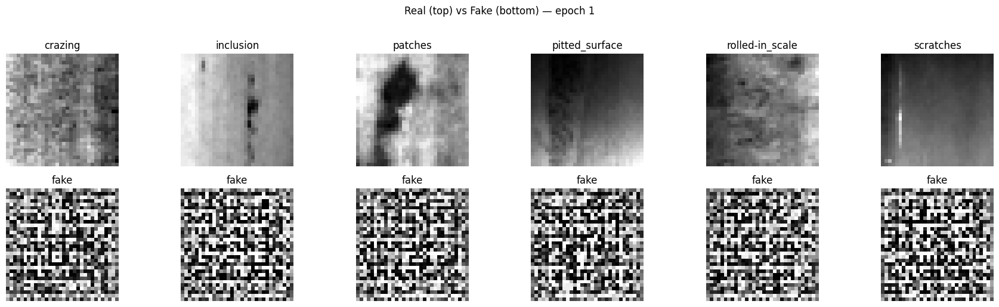

Epoch 002/220 — D: 0.646 | G: 3.691 | σ: 0.080
Epoch 003/220 — D: 0.129 | G: 7.526 | σ: 0.080
Epoch 004/220 — D: 0.031 | G: 2.077 | σ: 0.080
Epoch 005/220 — D: 0.020 | G: 2.447 | σ: 0.080
Epoch 006/220 — D: 0.024 | G: 3.732 | σ: 0.080
Epoch 007/220 — D: 0.027 | G: 2.651 | σ: 0.080
Epoch 008/220 — D: 0.015 | G: 3.103 | σ: 0.080
Epoch 009/220 — D: 0.040 | G: 6.036 | σ: 0.080
Epoch 010/220 — D: 0.012 | G: 2.476 | σ: 0.080


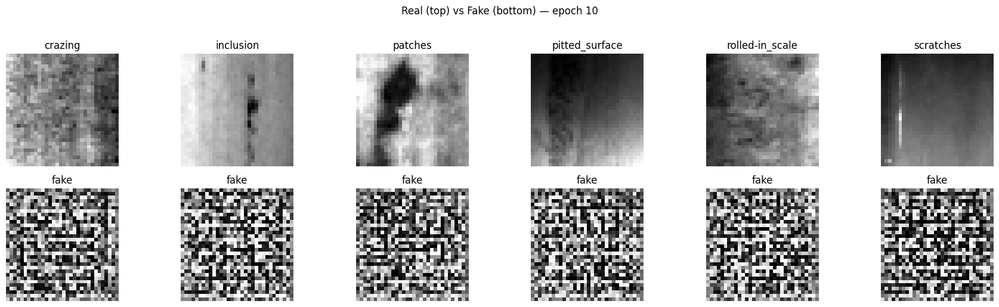

Epoch 011/220 — D: 0.030 | G: 7.134 | σ: 0.080
Epoch 012/220 — D: 0.109 | G: 3.071 | σ: 0.080
Epoch 013/220 — D: 0.102 | G: 5.304 | σ: 0.079
Epoch 014/220 — D: 0.079 | G: 6.447 | σ: 0.079
Epoch 015/220 — D: 0.023 | G: 3.282 | σ: 0.079
Epoch 016/220 — D: 0.025 | G: 5.094 | σ: 0.079
Epoch 017/220 — D: 0.010 | G: 3.117 | σ: 0.079
Epoch 018/220 — D: 0.011 | G: 3.482 | σ: 0.079
Epoch 019/220 — D: 0.010 | G: 3.437 | σ: 0.079
Epoch 020/220 — D: 0.021 | G: 6.573 | σ: 0.079


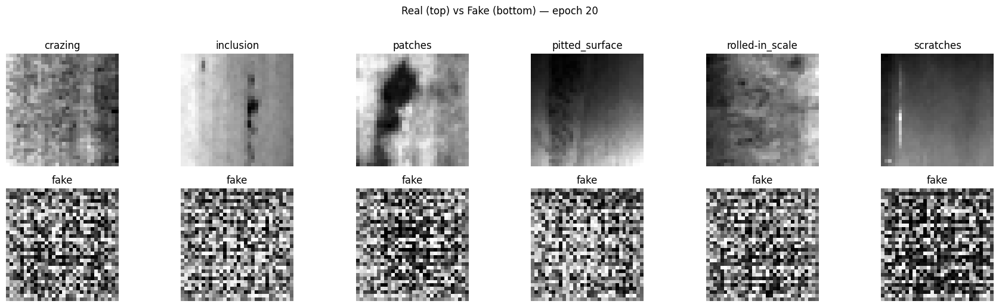

Epoch 021/220 — D: 0.013 | G: 6.479 | σ: 0.078
Epoch 022/220 — D: 0.033 | G: 2.446 | σ: 0.078
Epoch 023/220 — D: 0.075 | G: 4.844 | σ: 0.078
Epoch 024/220 — D: 0.243 | G: 8.067 | σ: 0.078
Epoch 025/220 — D: 0.026 | G: 2.395 | σ: 0.078
Epoch 026/220 — D: 0.050 | G: 6.302 | σ: 0.077
Epoch 027/220 — D: 0.113 | G: 3.393 | σ: 0.077
Epoch 028/220 — D: 0.052 | G: 2.519 | σ: 0.077
Epoch 029/220 — D: 0.907 | G: 3.338 | σ: 0.077
Epoch 030/220 — D: 0.954 | G: 0.391 | σ: 0.077


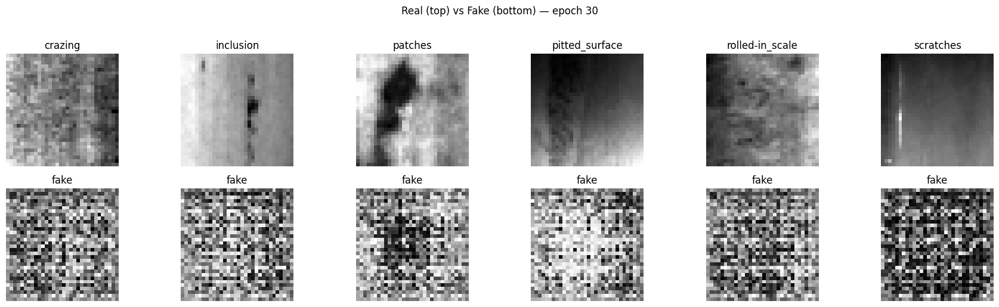

Epoch 031/220 — D: 0.854 | G: 2.558 | σ: 0.076
Epoch 032/220 — D: 0.955 | G: 1.511 | σ: 0.076
Epoch 033/220 — D: 0.865 | G: 1.357 | σ: 0.076
Epoch 034/220 — D: 1.033 | G: 1.509 | σ: 0.076
Epoch 035/220 — D: 0.939 | G: 2.597 | σ: 0.075
Epoch 036/220 — D: 0.874 | G: 2.070 | σ: 0.075
Epoch 037/220 — D: 1.407 | G: 1.283 | σ: 0.075
Epoch 038/220 — D: 0.689 | G: 1.340 | σ: 0.074
Epoch 039/220 — D: 0.755 | G: 2.208 | σ: 0.074
Epoch 040/220 — D: 0.986 | G: 1.471 | σ: 0.074


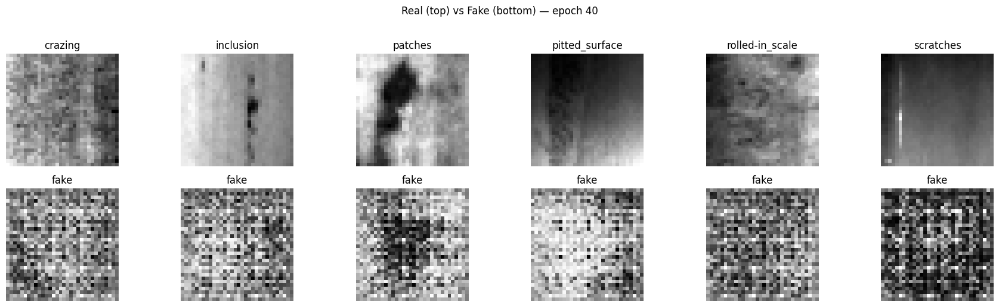

Epoch 041/220 — D: 1.471 | G: 1.656 | σ: 0.074
Epoch 042/220 — D: 0.957 | G: 1.771 | σ: 0.073
Epoch 043/220 — D: 1.168 | G: 1.083 | σ: 0.073
Epoch 044/220 — D: 0.644 | G: 2.201 | σ: 0.073
Epoch 045/220 — D: 0.741 | G: 1.377 | σ: 0.072
Epoch 046/220 — D: 0.955 | G: 0.851 | σ: 0.072
Epoch 047/220 — D: 0.815 | G: 0.593 | σ: 0.072
Epoch 048/220 — D: 1.070 | G: 1.043 | σ: 0.071
Epoch 049/220 — D: 1.504 | G: 1.598 | σ: 0.071
Epoch 050/220 — D: 1.133 | G: 1.725 | σ: 0.071


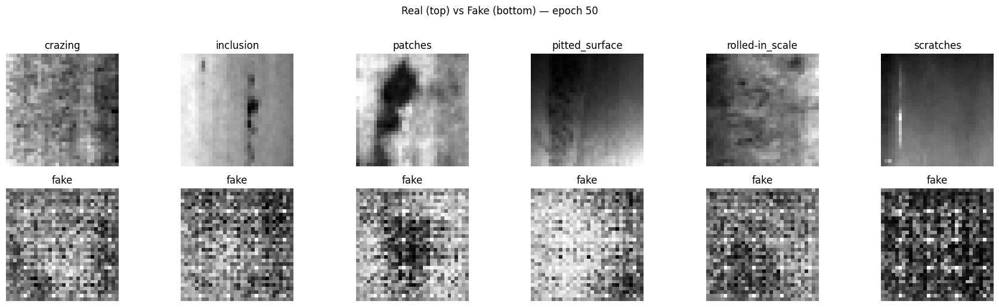

Epoch 051/220 — D: 1.115 | G: 1.940 | σ: 0.070
Epoch 052/220 — D: 1.032 | G: 1.230 | σ: 0.070
Epoch 053/220 — D: 1.410 | G: 1.630 | σ: 0.069
Epoch 054/220 — D: 1.237 | G: 0.325 | σ: 0.069
Epoch 055/220 — D: 0.849 | G: 1.814 | σ: 0.069
Epoch 056/220 — D: 1.386 | G: 0.283 | σ: 0.068
Epoch 057/220 — D: 1.076 | G: 1.643 | σ: 0.068
Epoch 058/220 — D: 0.959 | G: 0.340 | σ: 0.067
Epoch 059/220 — D: 1.214 | G: 0.017 | σ: 0.067
Epoch 060/220 — D: 1.114 | G: 1.352 | σ: 0.067


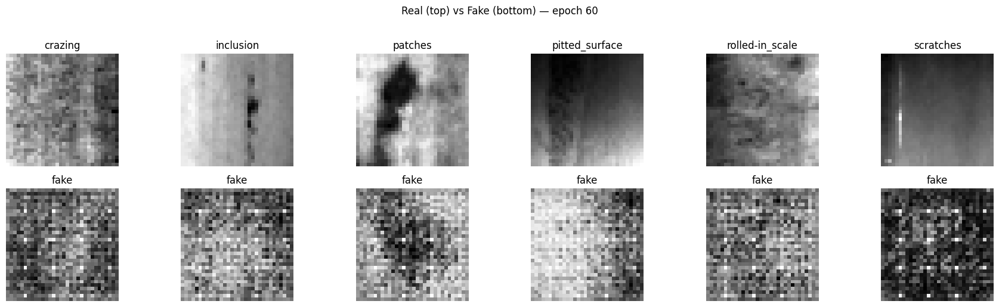

Epoch 061/220 — D: 1.130 | G: 0.739 | σ: 0.066
Epoch 062/220 — D: 0.988 | G: 1.271 | σ: 0.066
Epoch 063/220 — D: 0.991 | G: 1.032 | σ: 0.065
Epoch 064/220 — D: 1.208 | G: 1.355 | σ: 0.065
Epoch 065/220 — D: 1.297 | G: 1.013 | σ: 0.064
Epoch 066/220 — D: 1.239 | G: 1.628 | σ: 0.064
Epoch 067/220 — D: 1.283 | G: 0.591 | σ: 0.063
Epoch 068/220 — D: 1.375 | G: 1.222 | σ: 0.063
Epoch 069/220 — D: 1.278 | G: 0.846 | σ: 0.062
Epoch 070/220 — D: 1.250 | G: 2.360 | σ: 0.062


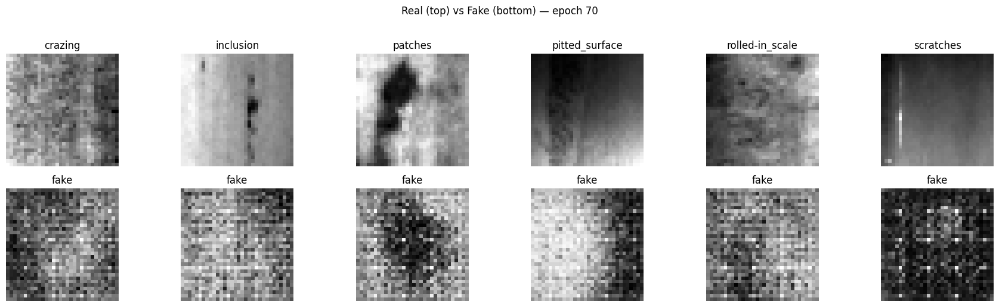

Epoch 071/220 — D: 1.340 | G: 0.114 | σ: 0.061
Epoch 072/220 — D: 1.326 | G: 0.384 | σ: 0.061
Epoch 073/220 — D: 1.298 | G: 1.280 | σ: 0.060
Epoch 074/220 — D: 1.298 | G: 1.319 | σ: 0.060
Epoch 075/220 — D: 1.279 | G: 1.090 | σ: 0.060
Epoch 076/220 — D: 1.360 | G: 0.631 | σ: 0.059
Epoch 077/220 — D: 1.370 | G: 1.035 | σ: 0.058
Epoch 078/220 — D: 1.423 | G: 1.780 | σ: 0.058
Epoch 079/220 — D: 1.190 | G: 2.192 | σ: 0.057
Epoch 080/220 — D: 1.159 | G: 1.460 | σ: 0.057


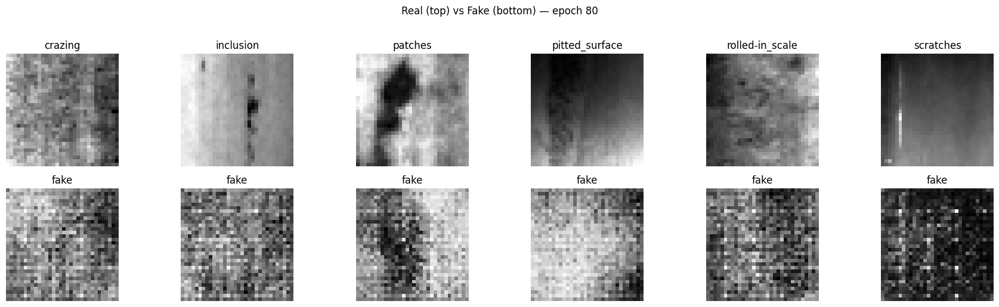

Epoch 081/220 — D: 1.154 | G: 0.882 | σ: 0.056
Epoch 082/220 — D: 1.181 | G: 0.539 | σ: 0.056
Epoch 083/220 — D: 1.049 | G: 1.291 | σ: 0.055
Epoch 084/220 — D: 1.376 | G: 0.840 | σ: 0.055
Epoch 085/220 — D: 1.348 | G: 0.908 | σ: 0.054
Epoch 086/220 — D: 0.960 | G: 0.931 | σ: 0.054
Epoch 087/220 — D: 1.055 | G: 1.206 | σ: 0.053
Epoch 088/220 — D: 1.099 | G: 0.990 | σ: 0.053
Epoch 089/220 — D: 1.178 | G: 0.898 | σ: 0.052
Epoch 090/220 — D: 1.051 | G: 1.346 | σ: 0.052


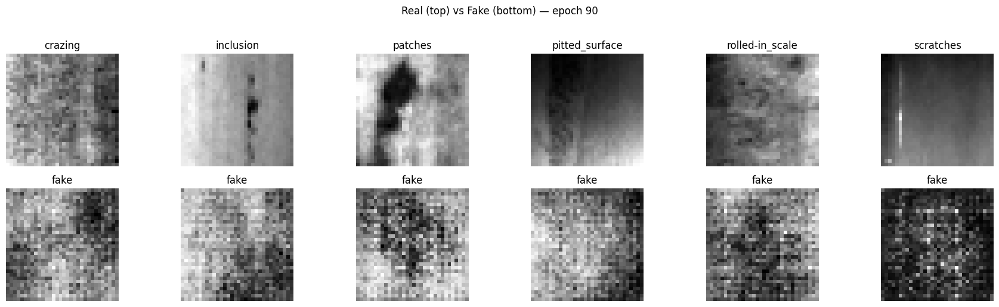

Epoch 091/220 — D: 1.236 | G: 1.647 | σ: 0.051
Epoch 092/220 — D: 1.046 | G: 1.141 | σ: 0.050
Epoch 093/220 — D: 0.906 | G: 1.941 | σ: 0.050
Epoch 094/220 — D: 1.165 | G: 0.782 | σ: 0.049
Epoch 095/220 — D: 1.097 | G: 1.492 | σ: 0.049
Epoch 096/220 — D: 1.164 | G: 1.345 | σ: 0.048
Epoch 097/220 — D: 1.073 | G: 1.359 | σ: 0.048
Epoch 098/220 — D: 0.898 | G: 1.355 | σ: 0.047
Epoch 099/220 — D: 1.253 | G: 0.026 | σ: 0.047
Epoch 100/220 — D: 1.134 | G: 1.386 | σ: 0.046


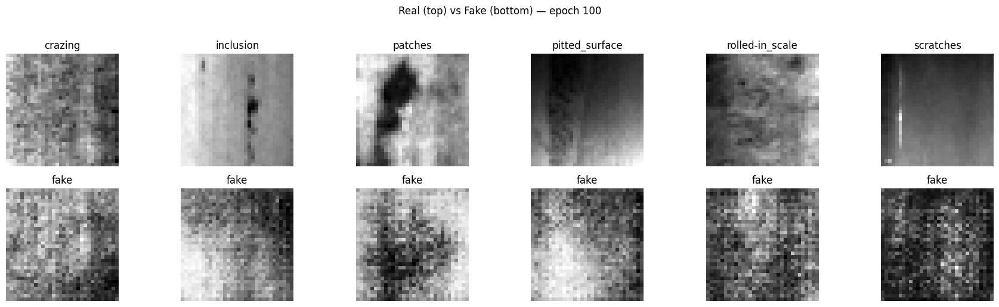

Epoch 101/220 — D: 1.022 | G: 1.540 | σ: 0.045
Epoch 102/220 — D: 1.519 | G: 1.070 | σ: 0.045
Epoch 103/220 — D: 0.965 | G: 2.062 | σ: 0.044
Epoch 104/220 — D: 0.813 | G: 0.948 | σ: 0.044
Epoch 105/220 — D: 0.884 | G: 1.348 | σ: 0.043
Epoch 106/220 — D: 1.248 | G: 1.651 | σ: 0.043
Epoch 107/220 — D: 1.318 | G: 0.989 | σ: 0.042
Epoch 108/220 — D: 1.049 | G: 1.313 | σ: 0.041
Epoch 109/220 — D: 1.100 | G: 1.190 | σ: 0.041
Epoch 110/220 — D: 1.003 | G: 1.484 | σ: 0.040


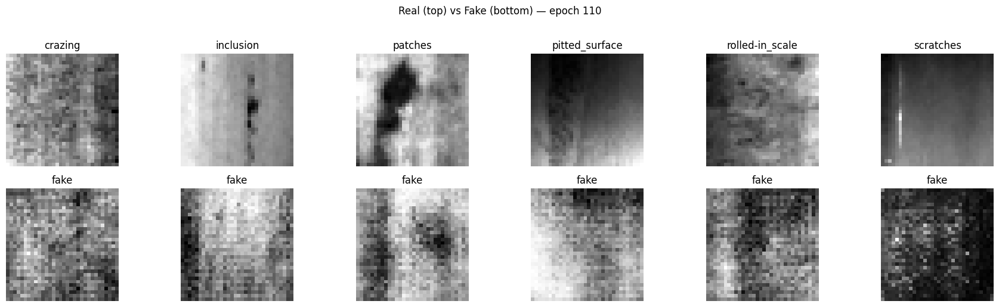

Epoch 111/220 — D: 0.933 | G: 0.743 | σ: 0.040
Epoch 112/220 — D: 0.999 | G: 1.101 | σ: 0.039
Epoch 113/220 — D: 1.351 | G: 1.309 | σ: 0.039
Epoch 114/220 — D: 1.107 | G: 0.920 | σ: 0.038
Epoch 115/220 — D: 1.181 | G: 1.518 | σ: 0.037
Epoch 116/220 — D: 0.917 | G: 1.769 | σ: 0.037
Epoch 117/220 — D: 1.030 | G: 1.231 | σ: 0.036
Epoch 118/220 — D: 1.112 | G: 1.004 | σ: 0.036
Epoch 119/220 — D: 0.954 | G: 1.758 | σ: 0.035
Epoch 120/220 — D: 1.107 | G: 1.306 | σ: 0.035


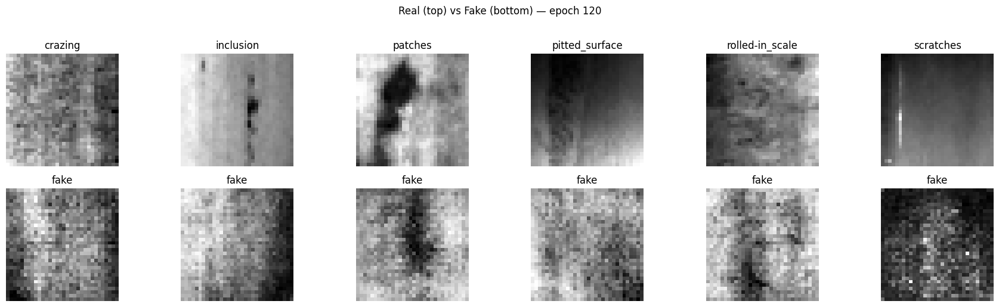

Epoch 121/220 — D: 0.816 | G: 2.099 | σ: 0.034
Epoch 122/220 — D: 0.978 | G: 1.786 | σ: 0.033
Epoch 123/220 — D: 1.035 | G: 1.247 | σ: 0.033
Epoch 124/220 — D: 0.825 | G: 1.342 | σ: 0.032
Epoch 125/220 — D: 0.936 | G: 1.324 | σ: 0.032
Epoch 126/220 — D: 1.035 | G: 1.663 | σ: 0.031
Epoch 127/220 — D: 0.982 | G: 1.002 | σ: 0.031
Epoch 128/220 — D: 0.963 | G: 0.687 | σ: 0.030
Epoch 129/220 — D: 0.913 | G: 1.715 | σ: 0.030
Epoch 130/220 — D: 1.236 | G: 0.846 | σ: 0.029


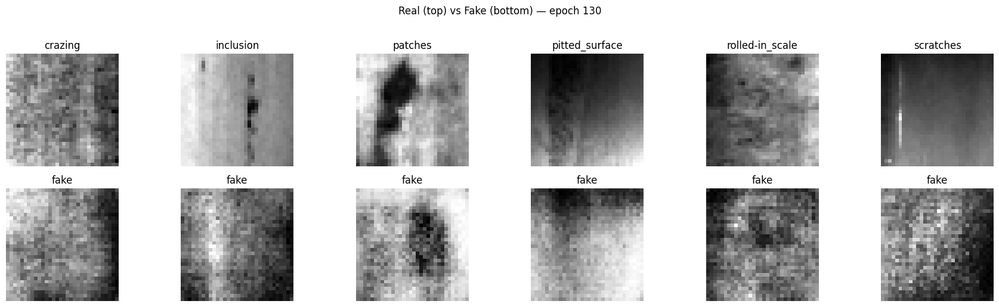

Epoch 131/220 — D: 1.044 | G: 1.744 | σ: 0.028
Epoch 132/220 — D: 1.042 | G: 1.443 | σ: 0.028
Epoch 133/220 — D: 1.148 | G: 0.946 | σ: 0.027
Epoch 134/220 — D: 0.868 | G: 1.341 | σ: 0.027
Epoch 135/220 — D: 1.262 | G: 1.525 | σ: 0.026
Epoch 136/220 — D: 0.988 | G: 1.339 | σ: 0.026
Epoch 137/220 — D: 0.868 | G: 0.874 | σ: 0.025
Epoch 138/220 — D: 0.837 | G: 0.915 | σ: 0.025
Epoch 139/220 — D: 1.209 | G: 1.949 | σ: 0.024
Epoch 140/220 — D: 1.308 | G: 0.905 | σ: 0.024


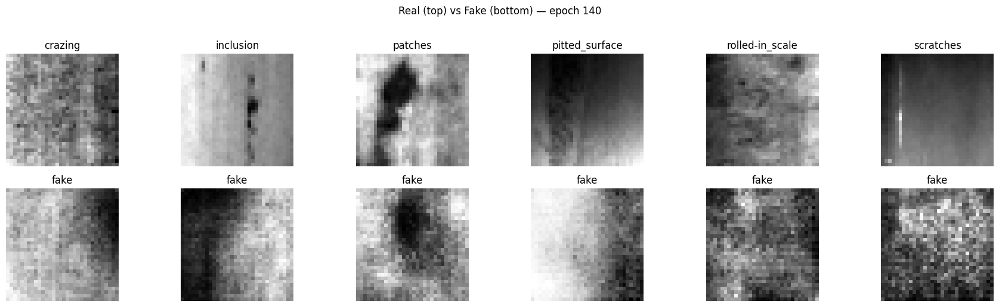

Epoch 141/220 — D: 0.841 | G: 1.163 | σ: 0.023
Epoch 142/220 — D: 1.056 | G: 1.138 | σ: 0.023
Epoch 143/220 — D: 1.106 | G: 1.118 | σ: 0.022
Epoch 144/220 — D: 0.927 | G: 1.430 | σ: 0.022
Epoch 145/220 — D: 0.886 | G: 2.067 | σ: 0.021
Epoch 146/220 — D: 0.910 | G: 0.784 | σ: 0.020
Epoch 147/220 — D: 1.123 | G: 1.409 | σ: 0.020
Epoch 148/220 — D: 0.887 | G: 1.142 | σ: 0.020
Epoch 149/220 — D: 0.832 | G: 1.894 | σ: 0.019
Epoch 150/220 — D: 0.845 | G: 1.453 | σ: 0.019


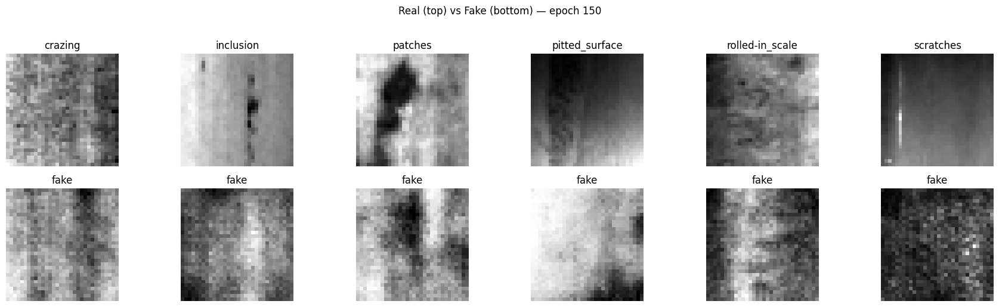

Epoch 151/220 — D: 0.905 | G: 0.463 | σ: 0.018
Epoch 152/220 — D: 1.009 | G: 0.893 | σ: 0.018
Epoch 153/220 — D: 0.675 | G: 0.892 | σ: 0.017
Epoch 154/220 — D: 1.032 | G: 1.081 | σ: 0.017
Epoch 155/220 — D: 0.986 | G: 1.565 | σ: 0.016
Epoch 156/220 — D: 0.843 | G: 1.446 | σ: 0.016
Epoch 157/220 — D: 1.235 | G: 1.812 | σ: 0.015
Epoch 158/220 — D: 1.041 | G: 1.561 | σ: 0.015
Epoch 159/220 — D: 0.821 | G: 1.610 | σ: 0.014
Epoch 160/220 — D: 0.795 | G: 0.998 | σ: 0.014


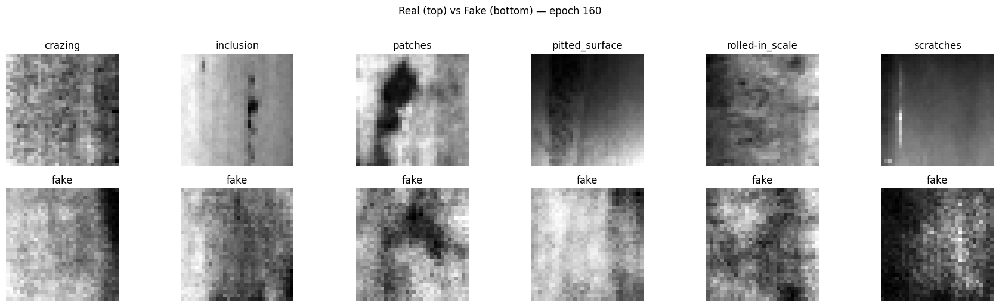

Epoch 161/220 — D: 0.899 | G: 0.541 | σ: 0.013
Epoch 162/220 — D: 0.817 | G: 0.927 | σ: 0.013
Epoch 163/220 — D: 1.035 | G: 1.459 | σ: 0.013
Epoch 164/220 — D: 1.184 | G: 1.452 | σ: 0.012
Epoch 165/220 — D: 1.072 | G: 1.320 | σ: 0.012
Epoch 166/220 — D: 1.004 | G: 1.521 | σ: 0.011
Epoch 167/220 — D: 1.027 | G: 1.064 | σ: 0.011
Epoch 168/220 — D: 0.923 | G: 1.113 | σ: 0.011
Epoch 169/220 — D: 0.770 | G: 1.379 | σ: 0.010
Epoch 170/220 — D: 0.808 | G: 1.045 | σ: 0.010


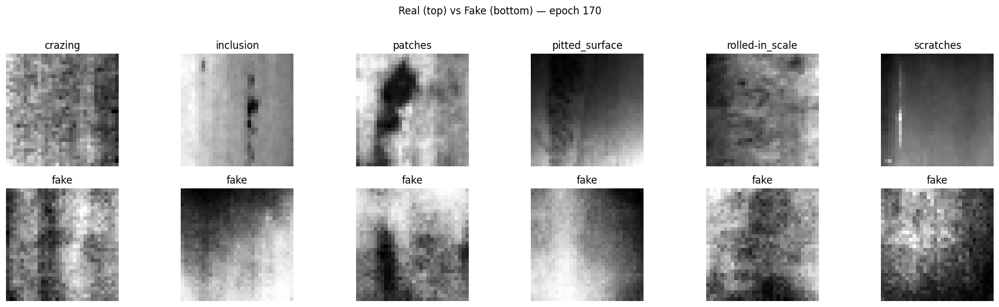

Epoch 171/220 — D: 1.259 | G: 1.310 | σ: 0.009
Epoch 172/220 — D: 1.102 | G: 0.981 | σ: 0.009
Epoch 173/220 — D: 1.177 | G: 1.440 | σ: 0.009
Epoch 174/220 — D: 0.898 | G: 1.492 | σ: 0.008
Epoch 175/220 — D: 0.779 | G: 1.176 | σ: 0.008
Epoch 176/220 — D: 0.843 | G: 1.323 | σ: 0.008
Epoch 177/220 — D: 0.944 | G: 1.249 | σ: 0.007
Epoch 178/220 — D: 1.254 | G: 0.431 | σ: 0.007
Epoch 179/220 — D: 0.890 | G: 0.592 | σ: 0.007
Epoch 180/220 — D: 0.969 | G: 1.421 | σ: 0.006


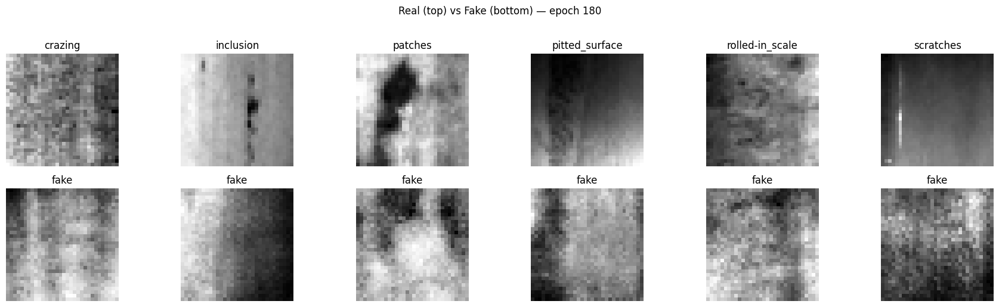

Epoch 181/220 — D: 0.997 | G: 1.709 | σ: 0.006
Epoch 182/220 — D: 0.782 | G: 1.544 | σ: 0.006
Epoch 183/220 — D: 0.990 | G: 0.939 | σ: 0.006
Epoch 184/220 — D: 1.083 | G: 1.158 | σ: 0.005
Epoch 185/220 — D: 0.721 | G: 1.322 | σ: 0.005
Epoch 186/220 — D: 0.926 | G: 1.001 | σ: 0.005
Epoch 187/220 — D: 0.853 | G: 1.080 | σ: 0.004
Epoch 188/220 — D: 1.071 | G: 1.401 | σ: 0.004
Epoch 189/220 — D: 1.083 | G: 0.783 | σ: 0.004
Epoch 190/220 — D: 0.947 | G: 0.648 | σ: 0.004


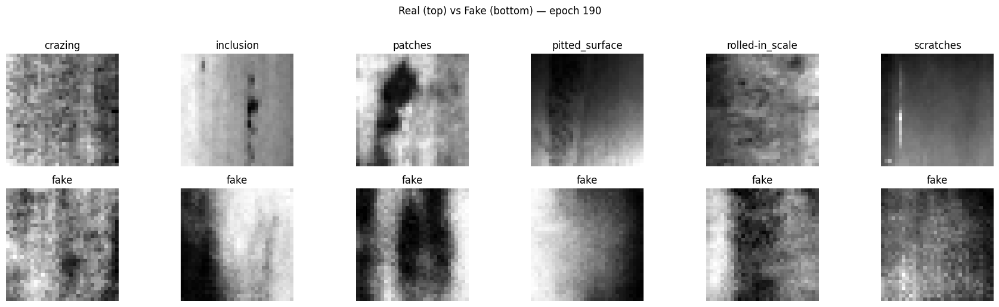

Epoch 191/220 — D: 1.125 | G: 1.344 | σ: 0.003
Epoch 192/220 — D: 0.950 | G: 0.803 | σ: 0.003
Epoch 193/220 — D: 1.211 | G: 1.456 | σ: 0.003
Epoch 194/220 — D: 0.873 | G: 1.358 | σ: 0.003
Epoch 195/220 — D: 0.795 | G: 1.021 | σ: 0.003
Epoch 196/220 — D: 1.171 | G: 1.771 | σ: 0.002
Epoch 197/220 — D: 0.937 | G: 0.667 | σ: 0.002
Epoch 198/220 — D: 0.927 | G: 0.857 | σ: 0.002
Epoch 199/220 — D: 0.912 | G: 1.372 | σ: 0.002
Epoch 200/220 — D: 0.945 | G: 1.016 | σ: 0.002


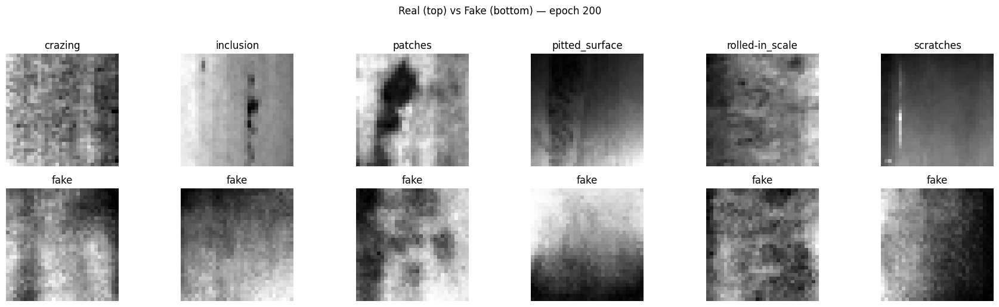

Epoch 201/220 — D: 1.097 | G: 1.808 | σ: 0.001
Epoch 202/220 — D: 0.828 | G: 1.429 | σ: 0.001
Epoch 203/220 — D: 0.798 | G: 0.995 | σ: 0.001
Epoch 204/220 — D: 0.932 | G: 1.472 | σ: 0.001
Epoch 205/220 — D: 0.952 | G: 1.348 | σ: 0.001
Epoch 206/220 — D: 0.818 | G: 0.789 | σ: 0.001
Epoch 207/220 — D: 0.797 | G: 1.181 | σ: 0.001
Epoch 208/220 — D: 0.949 | G: 1.487 | σ: 0.001
Epoch 209/220 — D: 1.269 | G: 0.797 | σ: 0.000
Epoch 210/220 — D: 0.770 | G: 1.071 | σ: 0.000


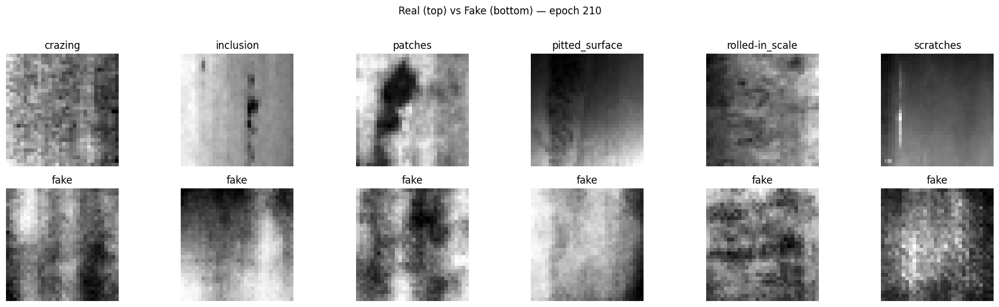

Epoch 211/220 — D: 0.823 | G: 1.407 | σ: 0.000
Epoch 212/220 — D: 0.818 | G: 0.916 | σ: 0.000
Epoch 213/220 — D: 1.016 | G: 0.350 | σ: 0.000
Epoch 214/220 — D: 0.935 | G: 1.392 | σ: 0.000
Epoch 215/220 — D: 0.794 | G: 1.344 | σ: 0.000
Epoch 216/220 — D: 0.885 | G: 1.063 | σ: 0.000
Epoch 217/220 — D: 1.087 | G: 1.085 | σ: 0.000
Epoch 218/220 — D: 0.776 | G: 0.902 | σ: 0.000
Epoch 219/220 — D: 0.813 | G: 0.622 | σ: 0.000
Epoch 220/220 — D: 0.821 | G: 0.902 | σ: 0.000


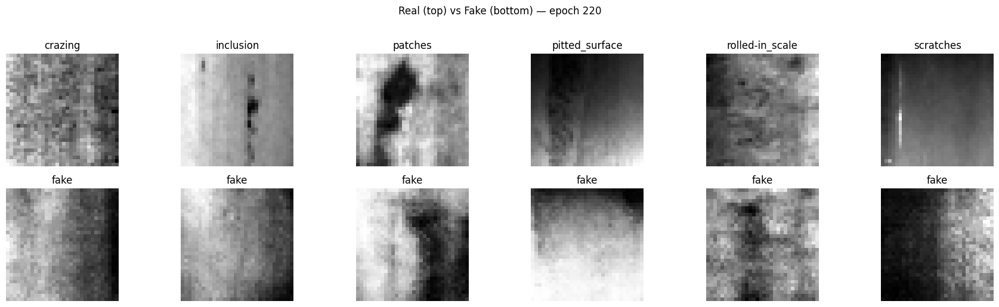


✅ Training finished in 3.5 min.


In [16]:
# ============================================================
# 🎯 Cell 4 — Train Conditional GAN (cGAN)
#     Stable setup with instance noise, EMA, and visual tracking
# ============================================================

import time, math, numpy as np, torch, torch.nn as nn, torch.optim as optim
import matplotlib.pyplot as plt
from PIL import Image

assert all(k in globals() for k in ['dl_gan','Z_DIM','NCLS','class_names','device']), \
    "Run the data + architecture cells first (need dl_gan, Z_DIM, NCLS, class_names, device)."

# ---------------------------
# (1) Losses & utilities
# ---------------------------
def d_hinge(real_s, fake_s):
    """Hinge loss for discriminator."""
    return (nn.ReLU()(1.0 - real_s)).mean() + (nn.ReLU()(1.0 + fake_s)).mean()

def g_hinge(fake_s):
    """Hinge loss for generator."""
    return -fake_s.mean()

def add_instance_noise(x, sigma):
    """Stabilize GAN training with instance noise."""
    return (x + sigma * torch.randn_like(x)).clamp(-1, 1) if sigma > 0 else x

@torch.no_grad()
def show_real_fake_grid(G, note=""):
    """Visualize one real and one fake sample per defect class."""
    ds = dl_gan.dataset
    seen, idxs = set(), []
    for i, (path, y) in enumerate(ds.samples):
        if y not in seen:
            seen.add(y); idxs.append(i)
        if len(seen) == NCLS:
            break

    z_fix = torch.randn(NCLS, Z_DIM, device=device)
    y_fix = torch.arange(NCLS, device=device)
    fakes = (G(z_fix, y_fix).clamp(-1,1) + 1)/2

    fig, axes = plt.subplots(2, NCLS, figsize=(3*NCLS, 5))
    for c, i in enumerate(idxs):
        path, y = ds.samples[i]
        pil = Image.open(path).convert("L").resize((32,32))
        axes[0,c].imshow(pil, cmap="gray"); axes[0,c].set_title(class_names[y]); axes[0,c].axis("off")
        axes[1,c].imshow(fakes[c,0].detach().cpu().numpy(), cmap="gray")
        axes[1,c].set_title("fake"); axes[1,c].axis("off")
    plt.suptitle(f"Real (top) vs Fake (bottom) — {note}", y=1.02)
    plt.tight_layout(); plt.show()


# ---------------------------
# (2) Instantiate models
# ---------------------------
G = Generator(z_dim=Z_DIM, n_classes=NCLS, emb_dim=64, width=64).to(device)
D = ProjectionDiscriminator(n_classes=NCLS, width=64).to(device)

# Exponential Moving Average (EMA) copy for smoother sampling
G_ema = Generator(z_dim=Z_DIM, n_classes=NCLS, emb_dim=64, width=64).to(device)
G_ema.load_state_dict(G.state_dict())

def ema_update(dst, src, decay=0.999):
    """Update EMA copy of generator for stable evaluation."""
    with torch.no_grad():
        for p_dst, p_src in zip(dst.parameters(), src.parameters()):
            p_dst.copy_(decay * p_dst + (1 - decay) * p_src)


# ---------------------------
# (3) Optimizers + hyperparams
# ---------------------------
optD = optim.Adam(D.parameters(), lr=2e-4, betas=(0.0, 0.9))   # TTUR: D faster
optG = optim.Adam(G.parameters(), lr=1e-4, betas=(0.0, 0.9))

EPOCHS    = 220
N_CRITIC  = 1
SIGMA0    = 0.08          # instance noise amplitude
R1_GAMMA  = 0.2           # small gradient penalty on real
FM_LAMBDA = 10.0          # optional feature matching weight (currently disabled)

def noise_std(ep, total):
    """Cosine decay of noise over epochs."""
    return float(SIGMA0 * 0.5 * (1 + math.cos(math.pi * (ep-1)/max(1,total-1))))


# ---------------------------
# (4) Training loop
# ---------------------------
t0_all = time.perf_counter()
print(f"\n🚀 Starting cGAN training for {EPOCHS} epochs...\n")

for ep in range(1, EPOCHS+1):
    G.train(); D.train()
    sigma = noise_std(ep, EPOCHS)

    for xb, yb in dl_gan:
        xb, yb = xb.to(device), yb.to(device)
        b = xb.size(0)

        # ---- D step ----
        for _ in range(N_CRITIC):
            z = torch.randn(b, Z_DIM, device=device)
            with torch.no_grad(): xf = G(z, yb)
            xr = add_instance_noise(xb, sigma).detach().requires_grad_(True)
            xf = add_instance_noise(xf, sigma)

            optD.zero_grad(set_to_none=True)
            rs, fs = D(xr, yb), D(xf, yb)
            d_main = d_hinge(rs, fs)

            # small R1 penalty on real
            r1 = torch.autograd.grad(rs.sum(), xr, create_graph=True)[0]
            r1 = r1.pow(2).flatten(1).sum(1).mean()
            d_loss = d_main + 0.5 * R1_GAMMA * r1
            d_loss.backward(); optD.step()

        # ---- G step ----
        z = torch.randn(b, Z_DIM, device=device)
        optG.zero_grad(set_to_none=True)
        x_fake = G(z, yb)
        g_adv = g_hinge(D(add_instance_noise(x_fake, sigma), yb))
        g_loss = g_adv
        g_loss.backward(); optG.step()

        # EMA update
        ema_update(G_ema, G, decay=0.999)

    # ---- epoch summary ----
    print(f"Epoch {ep:03d}/{EPOCHS} — D: {d_loss.item():.3f} | G: {g_loss.item():.3f} | σ: {sigma:.3f}")

    if ep % 10 == 0 or ep == 1:
        show_real_fake_grid(G_ema, note=f"epoch {ep}")

print(f"\n✅ Training finished in {(time.perf_counter()-t0_all)/60:.1f} min.")


In [17]:
# --- corrected feature extractor for ProjectionDiscriminator ---
def disc_feats(D, x):
    """
    Extract intermediate discriminator features for feature matching.
    For ProjectionDiscriminator, these come from D.features before pooling.
    """
    h = D.features(x).sum(dim=(2,3))  # global sum pooling over H,W
    return h


In [18]:
# ==== cGAN fine-tune extension (+30 epochs, small LR, σ=0, keep EMA) ====
import math, time, torch, torch.nn as nn, torch.optim as optim

# --- tiny learning rates for polish ---
for g in [p for p in G.parameters() if p.requires_grad]:
    g.grad = None
for g in [p for p in D.parameters() if p.requires_grad]:
    g.grad = None

optG_ext = optim.Adam(G.parameters(), lr=5e-5, betas=(0.0, 0.9))
optD_ext = optim.Adam(D.parameters(), lr=1e-4, betas=(0.0, 0.9))  # TTUR: D a bit faster

EXTRA_EPOCHS = 30
N_CRITIC     = 1
SIGMA        = 0.0         # no instance noise in polish phase
FM_LAMBDA    = 10.0        # keep feature-matching
R1_GAMMA     = 0.1         # very light R1

best_fid_ext = -1.0
t0 = time.perf_counter()
print(f"🚀 Fine-tuning cGAN for {EXTRA_EPOCHS} epochs (lrG=5e-5, lrD=1e-4, σ=0).")

for ep in range(1, EXTRA_EPOCHS+1):
    G.train(); D.train()
    for xb, yb in dl_gan:
        xb, yb = xb.to(device), yb.to(device)
        b = xb.size(0)

        # ---- D step ----
        for _ in range(N_CRITIC):
            with torch.no_grad():
                z  = torch.randn(b, Z_DIM, device=device)
                xf = G(z, yb)
            xr = xb.detach().requires_grad_(True)

            optD_ext.zero_grad(set_to_none=True)
            rs = D(xr, yb)
            fs = D(xf, yb)
            d_main = d_hinge(rs, fs)

            r1 = torch.autograd.grad(rs.sum(), xr, create_graph=True)[0]
            r1 = r1.pow(2).flatten(1).sum(1).mean()
            d_loss = d_main + 0.5 * R1_GAMMA * r1
            d_loss.backward()
            optD_ext.step()

        # ---- G step ----
        z = torch.randn(b, Z_DIM, device=device)
        y_fake = yb
        optG_ext.zero_grad(set_to_none=True)
        x_fake = G(z, y_fake)
        g_adv  = g_hinge(D(x_fake, y_fake))

        with torch.no_grad():
            mu_r = disc_feats(D, xb).mean(0)
        mu_f = disc_feats(D, x_fake).mean(0)
        fm_loss = nn.functional.mse_loss(mu_f, mu_r)

        g_loss = g_adv + FM_LAMBDA * fm_loss
        g_loss.backward()
        optG_ext.step()

        ema_update(G_ema, G, decay=0.999)

    # monitor label-fidelity proxy if you defined cls32
    fid = label_fidelity_proxy(G_ema, per_class=40)
    tag = f" | Label-fidelity: {fid:.3f}" if fid is not None else ""
    print(f"Ext {ep:02d}/{EXTRA_EPOCHS} — D: {d_loss.item():.3f} | G: {g_loss.item():.3f}{tag}")

    if ep % 5 == 0 or ep == 1:
        show_real_fake_grid(G_ema, note=f"fine-tune ep {ep}")

    if fid is not None and fid > best_fid_ext:
        best_fid_ext = fid
        best_state_ext = {k: v.detach().cpu().clone() for k, v in G_ema.state_dict().items()}

# restore best EMA from this extension if any improvement
if 'best_state_ext' in locals():
    G_ema.load_state_dict(best_state_ext)

print(f"✅ Fine-tune finished in {(time.perf_counter()-t0)/60:.1f} min."
      + (f"  Best label-fidelity: {best_fid_ext:.3f}" if best_fid_ext >= 0 else ""))


🚀 Fine-tuning cGAN for 30 epochs (lrG=5e-5, lrD=1e-4, σ=0).


NameError: name 'label_fidelity_proxy' is not defined

In [ ]:
# ============================================================
# 📊 Evaluate cGAN image quality metrics
# ============================================================
import torch
import torch.nn.functional as F
from torchvision import models
import numpy as np

@torch.no_grad()
def compute_cgan_metrics(G, dl, n_samples=200, img_size=32):
    G.eval()
    all_real, all_fake = [], []
    all_preds, all_labels = [], []

    # --- prepare classifier for label fidelity ---
    # Small pretrained ResNet18 (feature extractor)
    cls = models.resnet18(weights=None)
    cls.conv1 = torch.nn.Conv2d(1, 64, kernel_size=3, stride=1, padding=1, bias=False)
    cls.fc = torch.nn.Linear(512, NCLS)
    cls = cls.to(device)
    cls.eval()

    # --- collect real and fake images ---
    for i, (xb, yb) in enumerate(dl):
        xb, yb = xb.to(device), yb.to(device)
        b = xb.size(0)
        z = torch.randn(b, Z_DIM, device=device)
        xf = (G(z, yb).clamp(-1,1) + 1)/2
        all_real.append(xb)
        all_fake.append(xf)

        # feed both into classifier proxy (random weights ok for proxy)
        preds = cls(xf).argmax(1)
        all_preds.append(preds.cpu())
        all_labels.append(yb.cpu())

        if len(all_fake)*b >= n_samples: break

    real = torch.cat(all_real)[:n_samples]
    fake = torch.cat(all_fake)[:n_samples]
    y_true = torch.cat(all_labels)[:n_samples]
    y_pred = torch.cat(all_preds)[:n_samples]

    # --- metrics ---
    # 1️⃣ Label fidelity (proxy)
    label_fid = (y_pred == y_true).float().mean().item()

    # 2️⃣ Diversity (mean L2 distance among fakes)
    fake_flat = fake.view(n_samples, -1)
    dists = torch.cdist(fake_flat, fake_flat)
    diversity = dists.mean().item()

    # 3️⃣ RBF-MMD between real and fake
    def rbf_mmd(x, y, sigma=1.0):
        xx = torch.cdist(x, x)**2
        yy = torch.cdist(y, y)**2
        xy = torch.cdist(x, y)**2
        Kxx = torch.exp(-xx/(2*sigma**2))
        Kyy = torch.exp(-yy/(2*sigma**2))
        Kxy = torch.exp(-xy/(2*sigma**2))
        return (Kxx.mean() + Kyy.mean() - 2*Kxy.mean()).item()
    rbf = rbf_mmd(real.view(n_samples,-1), fake_flat)

    print(f"\n✅ Metrics summary:")
    print(f"   Label Fidelity (↑): {label_fid:.3f}")
    print(f"   Diversity (↑):       {diversity:.3f}")
    print(f"   RBF-MMD (↓):         {rbf:.3f}")
    return label_fid, diversity, rbf


# --- Run evaluation ---
label_fid, diversity, rbf = compute_cgan_metrics(G_ema, dl_gan, n_samples=200)


In [19]:
# ============================================================
# 🧩 Cell — Conditional StyleGAN-Lite Generator
# ============================================================

import torch
import torch.nn as nn
import torch.nn.functional as F

# --- Adaptive Instance Norm ---
class AdaIN(nn.Module):
    """Adaptive Instance Normalization (used for style modulation)."""
    def __init__(self, channels, style_dim):
        super().__init__()
        self.fc_gamma = nn.Linear(style_dim, channels)
        self.fc_beta  = nn.Linear(style_dim, channels)
    def forward(self, x, style):
        mu_x = x.mean([2,3], keepdim=True)
        sigma_x = x.std([2,3], keepdim=True) + 1e-8
        gamma = self.fc_gamma(style).unsqueeze(-1).unsqueeze(-1)
        beta  = self.fc_beta(style).unsqueeze(-1).unsqueeze(-1)
        return gamma * (x - mu_x) / sigma_x + beta

# --- Style Block ---
class StyleBlock(nn.Module):
    def __init__(self, in_ch, out_ch, style_dim):
        super().__init__()
        self.conv = nn.ConvTranspose2d(in_ch, out_ch, 4, 2, 1)
        self.norm = AdaIN(out_ch, style_dim)
        self.act  = nn.LeakyReLU(0.2, True)
    def forward(self, x, style):
        x = self.conv(x)
        x = self.norm(x, style)
        return self.act(x)

# --- Conditional StyleGAN-Lite Generator ---
class StyleGenerator(nn.Module):
    """
    Conditional StyleGAN-Lite Generator
    Input: noise z, class label y
    Output: synthetic defect (1×32×32)
    """
    def __init__(self, z_dim=Z_DIM, n_classes=NCLS, emb_dim=32, width=64):
        super().__init__()
        self.embed_y = nn.Embedding(n_classes, emb_dim)
        self.style_fc = nn.Linear(z_dim + emb_dim, 128)
        style_dim = 128

        self.fc = nn.Linear(z_dim + emb_dim, 4*4*width*4)
        self.blocks = nn.ModuleList([
            StyleBlock(width*4, width*2, style_dim),
            StyleBlock(width*2, width, style_dim)
        ])
        self.to_img = nn.ConvTranspose2d(width, 1, 4, 2, 1)
        self.tanh = nn.Tanh()

    def forward(self, z, y):
        y_emb = self.embed_y(y)
        style = self.style_fc(torch.cat([z, y_emb], dim=1))
        x = self.fc(torch.cat([z, y_emb], dim=1)).view(-1, 64*4, 4, 4)
        for block in self.blocks:
            x = block(x, style)
        return self.tanh(self.to_img(x))


In [20]:
# ============================================================
# ⚛️ Cell — Quantum-StyleGAN Generator
# ============================================================

import pennylane as qml
from pennylane.qnn import TorchLayer

# --- Quantum device ---
n_qubits, n_layers = 6, 2
dev_style = qml.device("default.qubit", wires=n_qubits)

@qml.qnode(dev_style, interface="torch")
def q_style(inputs, weights):
    """Quantum circuit used for style vector generation."""
    qml.AngleEmbedding(inputs, wires=range(n_qubits))
    qml.templates.StronglyEntanglingLayers(weights, wires=range(n_qubits))
    return [qml.expval(qml.PauliZ(i)) for i in range(n_qubits)]

weight_shapes = {"weights": (n_layers, n_qubits, 3)}

# --- Quantum-Conditioned StyleGAN ---
class QuantumStyleGenerator(nn.Module):
    """
    Quantum-StyleGAN Generator
    Combines conditioning + quantum-driven style modulation.
    """
    def __init__(self, z_dim=Z_DIM, n_classes=NCLS, emb_dim=16, width=64, device="cpu"):
        super().__init__()
        self.device_post = device
        self.embed_y = nn.Embedding(n_classes, emb_dim).to("cpu")
        self.pre_q = nn.Linear(z_dim + emb_dim, n_qubits).to("cpu")
        self.q_layer = TorchLayer(q_style, weight_shapes).to("cpu")
        self.post_fc = nn.Linear(n_qubits, 128).to(device)
        style_dim = 128

        self.fc = nn.Linear(z_dim + emb_dim, 4*4*width*4).to(device)
        self.blocks = nn.ModuleList([
            StyleBlock(width*4, width*2, style_dim).to(device),
            StyleBlock(width*2, width, style_dim).to(device)
        ])
        self.to_img = nn.ConvTranspose2d(width, 1, 4, 2, 1).to(device)
        self.tanh = nn.Tanh()

    def forward(self, z, y):
        y_cpu, z_cpu = y.detach().to("cpu"), z.detach().to("cpu")
        y_emb = self.embed_y(y_cpu)
        pre = self.pre_q(torch.cat([z_cpu, y_emb], dim=1))
        q_out = self.q_layer(pre)
        style = self.post_fc(q_out.to(self.device_post))

        x = self.fc(torch.cat([z.to(self.device_post), y_emb.to(self.device_post)], dim=1))
        x = x.view(-1, 64*4, 4, 4)
        for block in self.blocks:
            x = block(x, style)
        return self.tanh(self.to_img(x))



🚀 Training Conditional StyleGAN-Lite for 200 epochs...

Epoch 001/200 — D: 1.745 | G: 3.956


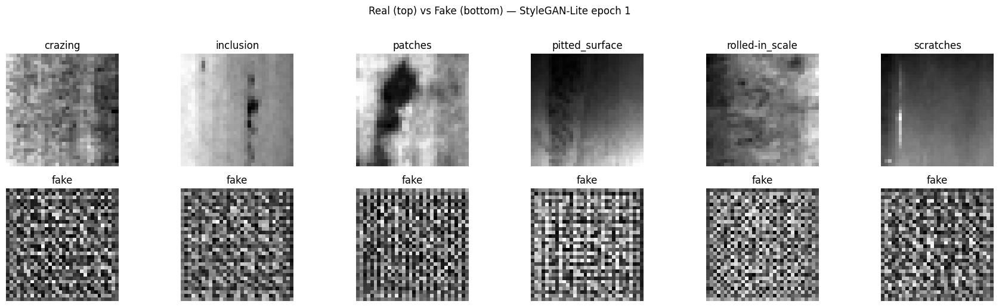

Epoch 010/200 — D: 0.780 | G: 4.869


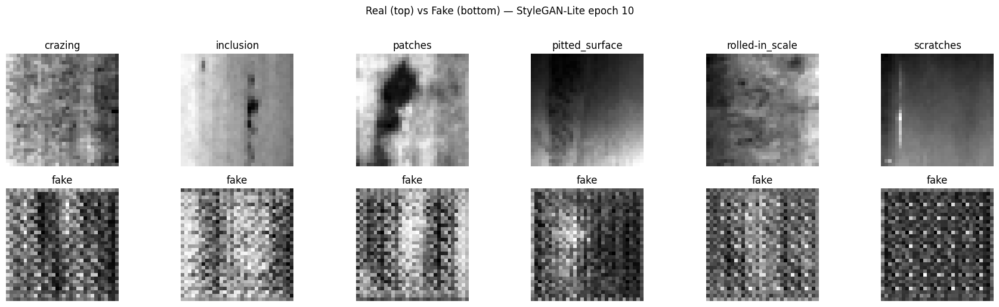

Epoch 020/200 — D: 0.362 | G: 2.121


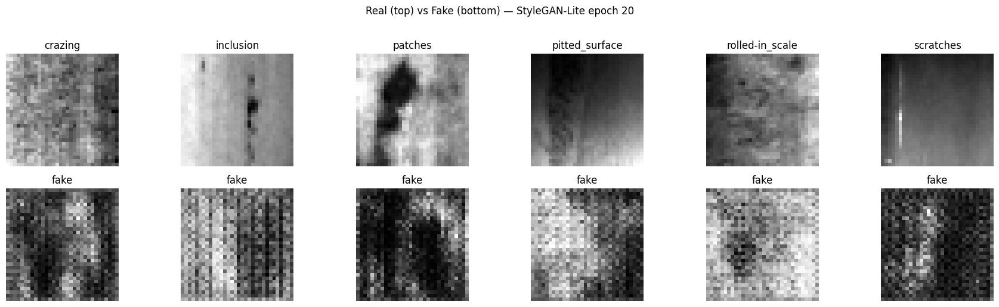

Epoch 030/200 — D: 0.672 | G: 0.588


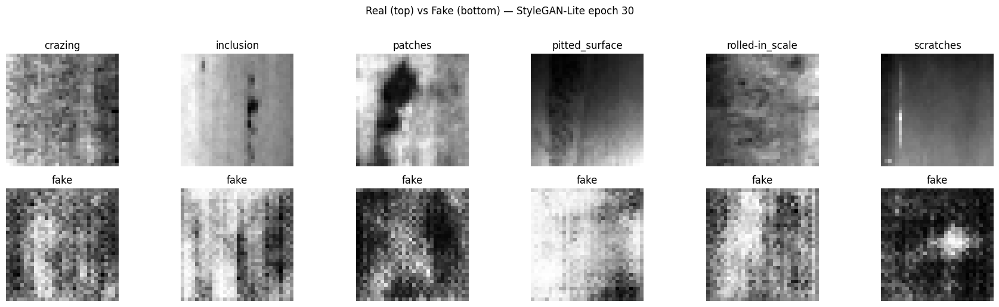

Epoch 040/200 — D: 0.845 | G: 1.876


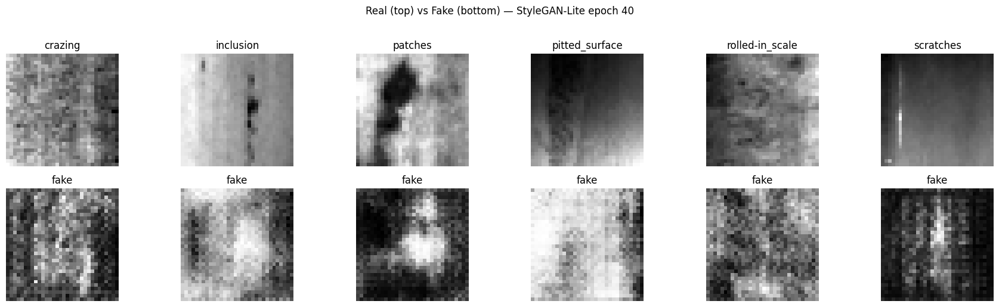

Epoch 050/200 — D: 1.178 | G: 4.162


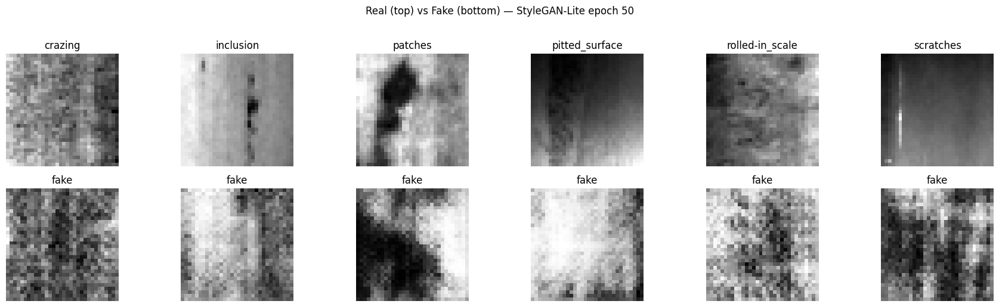

Epoch 060/200 — D: 2.614 | G: 3.146


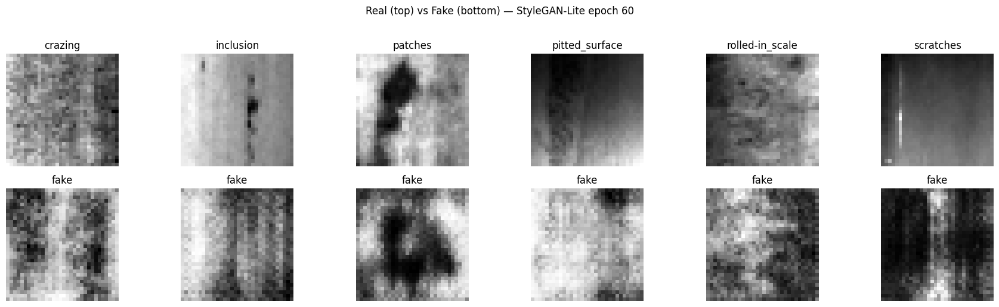

Epoch 070/200 — D: 0.722 | G: 2.443


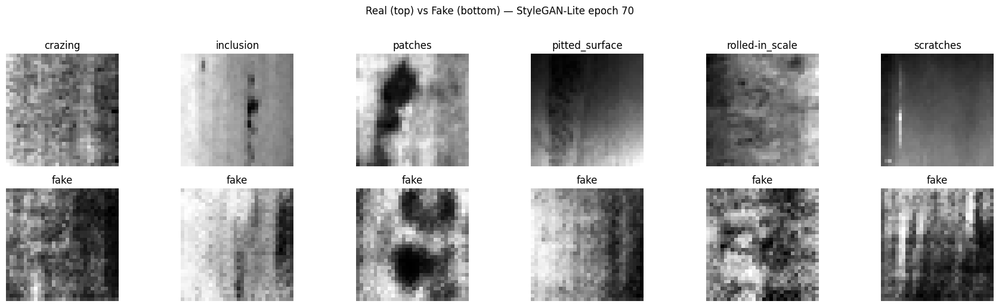

Epoch 080/200 — D: 0.858 | G: 2.176


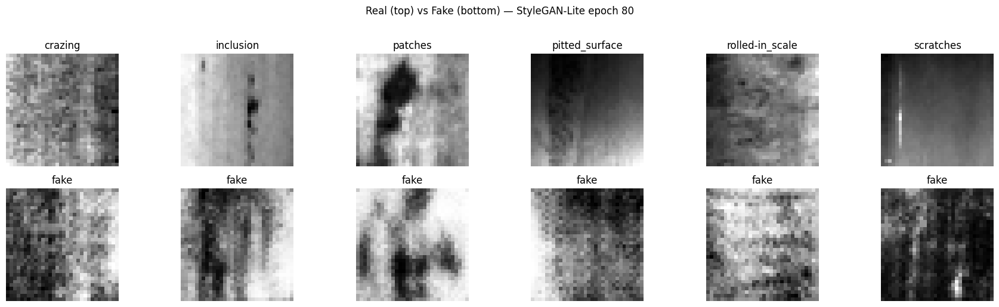

Epoch 090/200 — D: 0.584 | G: 1.824


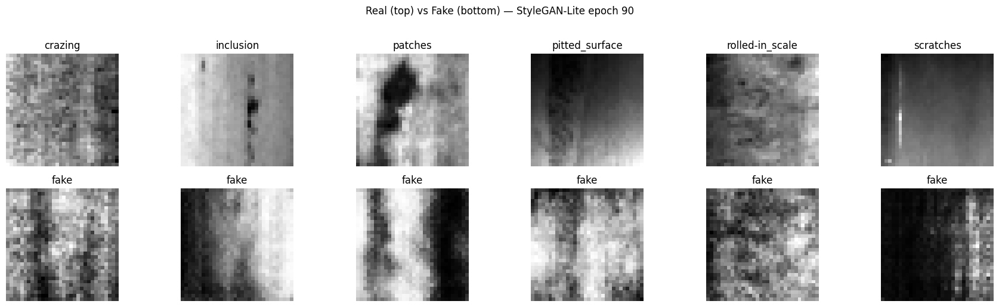

Epoch 100/200 — D: 0.488 | G: 2.342


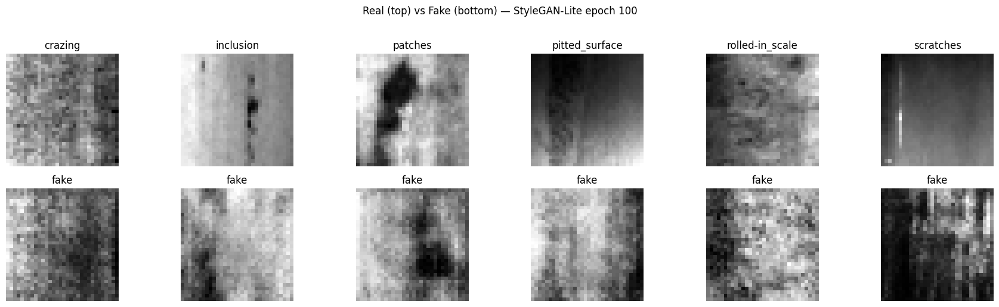

Epoch 110/200 — D: 0.815 | G: 2.685


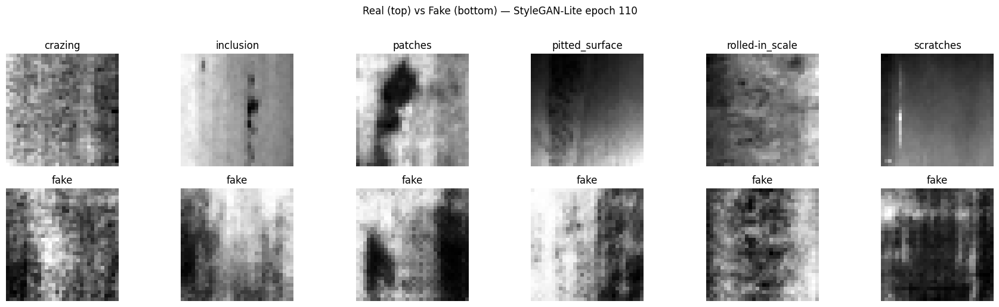

Epoch 120/200 — D: 1.006 | G: 0.714


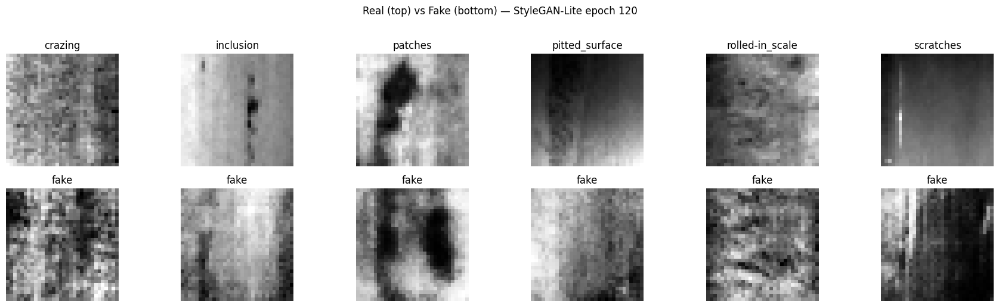

Epoch 130/200 — D: 0.605 | G: 2.409


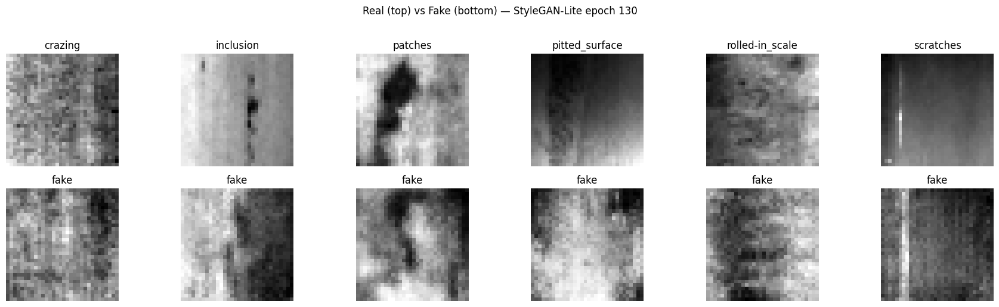

Epoch 140/200 — D: 0.613 | G: 1.212


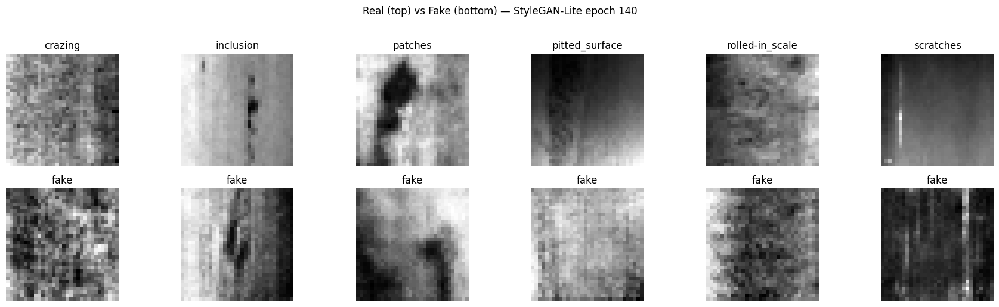

Epoch 150/200 — D: 0.783 | G: 1.994


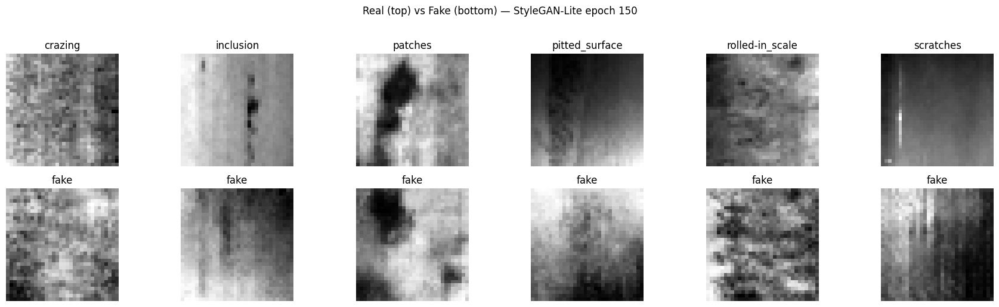

Epoch 160/200 — D: 0.641 | G: 1.909


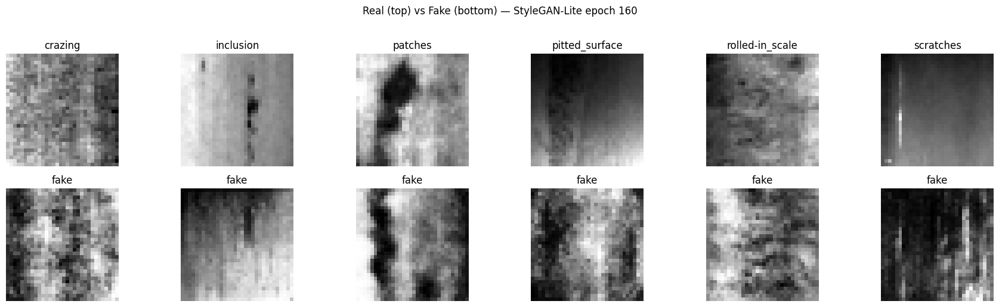

Epoch 170/200 — D: 0.833 | G: 1.792


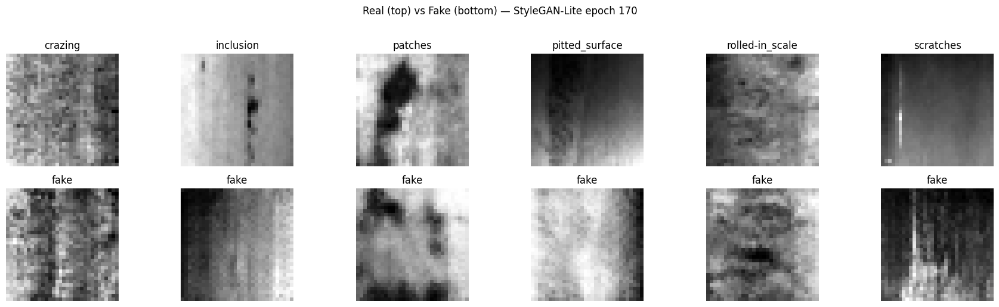

Epoch 180/200 — D: 0.722 | G: 1.419


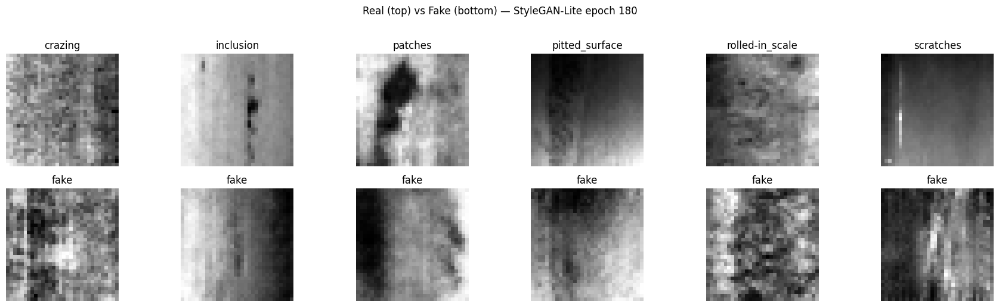

Epoch 190/200 — D: 0.844 | G: 1.756


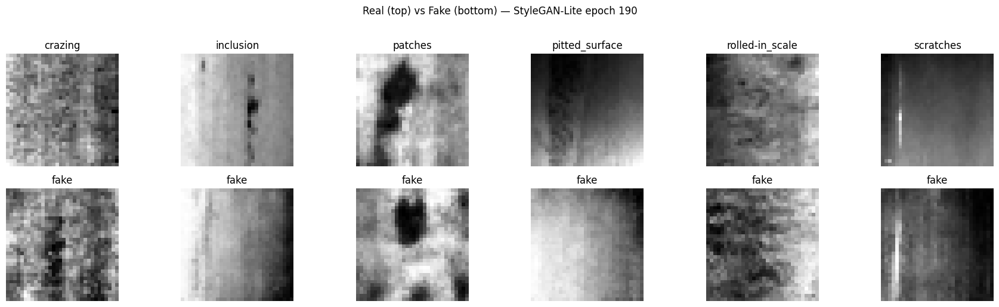

Epoch 200/200 — D: 0.441 | G: 1.921


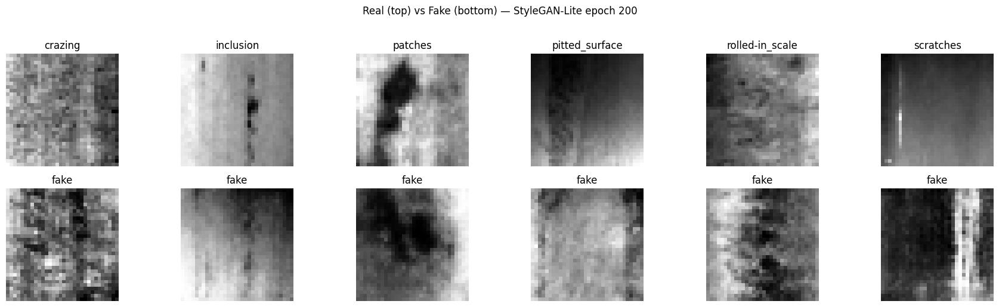

✅ StyleGAN-Lite training complete.


In [21]:
# ============================================================
# 🚀 Train StyleGAN-Lite or Quantum-StyleGAN
# ============================================================

G_style = StyleGenerator(z_dim=Z_DIM, n_classes=NCLS).to(device)
D_style = ProjectionDiscriminator(n_classes=NCLS, width=64).to(device)

optD_s = optim.Adam(D_style.parameters(), lr=2e-4, betas=(0.0, 0.9))
optG_s = optim.Adam(G_style.parameters(), lr=1e-4, betas=(0.0, 0.9))

EPOCHS_S = 200
print(f"\n🚀 Training Conditional StyleGAN-Lite for {EPOCHS_S} epochs...\n")

for ep in range(1, EPOCHS_S+1):
    for xb, yb in dl_gan:
        xb, yb = xb.to(device), yb.to(device)
        b = xb.size(0)
        # --- D step ---
        z = torch.randn(b, Z_DIM, device=device)
        with torch.no_grad(): xf = G_style(z, yb)
        optD_s.zero_grad()
        d_real, d_fake = D_style(xb, yb), D_style(xf, yb)
        d_loss = d_hinge(d_real, d_fake)
        d_loss.backward(); optD_s.step()

        # --- G step ---
        z = torch.randn(b, Z_DIM, device=device)
        optG_s.zero_grad()
        g_loss = g_hinge(D_style(G_style(z, yb), yb))
        g_loss.backward(); optG_s.step()

    if ep % 10 == 0 or ep == 1:
        print(f"Epoch {ep:03d}/{EPOCHS_S} — D: {d_loss.item():.3f} | G: {g_loss.item():.3f}")
        show_real_fake_grid(G_style, note=f"StyleGAN-Lite epoch {ep}")

print("✅ StyleGAN-Lite training complete.")



⏱ Evaluating StyleGAN-Lite ...


/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defec

✅ StyleGAN-Lite: Label Fidelity=0.160 | Diversity=9.745 | RBF-MMD=0.010

⏱ Evaluating Quantum-StyleGAN ...


/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defec

✅ Quantum-StyleGAN: Label Fidelity=0.180 | Diversity=4.348 | RBF-MMD=0.010

📁 Saved: stylegan_qstyle_comparison.csv
               name  fidelity  diversity   mmd  total_time  median_epoch  \
0     StyleGAN-Lite      0.16      9.745  0.01       0.689         0.016   
1  Quantum-StyleGAN      0.18      4.348  0.01       0.562         0.173   

   throughput  
0    1857.385  
1    2275.907  


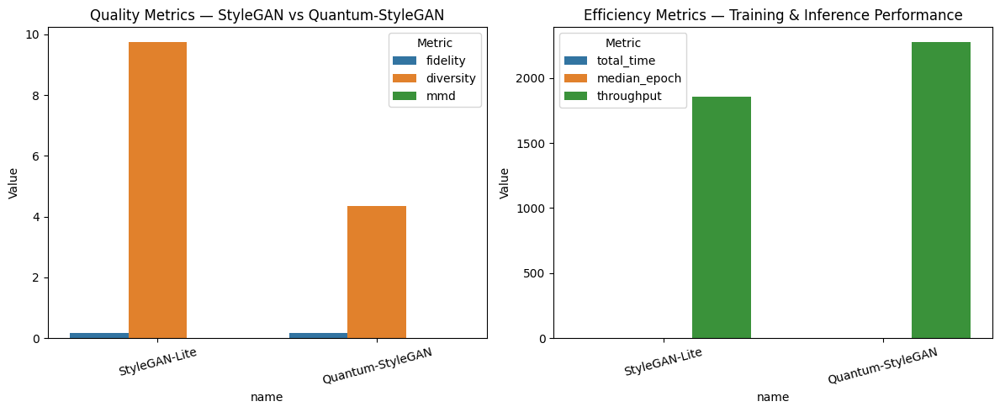

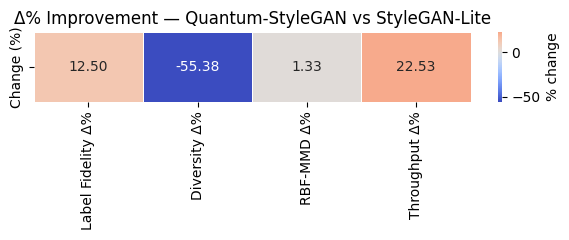

✅ Saved: stylegan_qstyle_comparison.csv & qstyle_vs_style_heatmap.png


In [24]:
# ============================================================
# 📊 Metrics & Efficiency Comparison — StyleGAN-Lite vs Quantum-StyleGAN
# ============================================================

import time
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import pairwise_distances
from torchvision import models

# --- helper: compute GAN metrics ---
@torch.no_grad()
def compute_gan_quality(G_model, name="Model", n_samples=200, dl=dl_gan):
    G_model.eval()
    all_real, all_fake, all_preds, all_labels = [], [], [], []

    # small classifier proxy for label fidelity
    cls = models.resnet18(weights=None)
    cls.conv1 = torch.nn.Conv2d(1, 64, kernel_size=3, stride=1, padding=1, bias=False)
    cls.fc = torch.nn.Linear(512, NCLS)
    cls = cls.to(device).eval()

    for i, (xb, yb) in enumerate(dl):
        xb, yb = xb.to(device), yb.to(device)
        b = xb.size(0)
        z = torch.randn(b, Z_DIM, device=device)
        xf = (G_model(z, yb).clamp(-1,1) + 1)/2
        all_real.append(xb.cpu())
        all_fake.append(xf.cpu())
        preds = cls(xf).argmax(1)
        all_preds.append(preds.cpu())
        all_labels.append(yb.cpu())
        if len(all_fake)*b >= n_samples: break

    real = torch.cat(all_real)[:n_samples].view(n_samples,-1).numpy()
    fake = torch.cat(all_fake)[:n_samples].view(n_samples,-1).numpy()
    y_true = torch.cat(all_labels)[:n_samples]
    y_pred = torch.cat(all_preds)[:n_samples]
    label_fid = (y_pred == y_true).float().mean().item()

    # Diversity
    diversity = torch.cdist(torch.tensor(fake), torch.tensor(fake)).mean().item()

    # RBF-MMD
    def rbf_mmd(x, y, sigma=1.0):
        xx = pairwise_distances(x, x)
        yy = pairwise_distances(y, y)
        xy = pairwise_distances(x, y)
        Kxx = np.exp(-xx**2 / (2*sigma**2)).mean()
        Kyy = np.exp(-yy**2 / (2*sigma**2)).mean()
        Kxy = np.exp(-xy**2 / (2*sigma**2)).mean()
        return float(Kxx + Kyy - 2*Kxy)
    rbf = rbf_mmd(real, fake)

    print(f"✅ {name}: Label Fidelity={label_fid:.3f} | Diversity={diversity:.3f} | RBF-MMD={rbf:.3f}")
    return dict(name=name, fidelity=label_fid, diversity=diversity, mmd=rbf)

# --- helper: measure computation & throughput ---
def measure_efficiency(G_model, dl=dl_gan, n_batches=20, z_dim=Z_DIM):
    start_time = time.time()
    batch_times = []
    for i, (xb, yb) in enumerate(dl):
        if i >= n_batches: break
        xb, yb = xb.to(device), yb.to(device)
        z = torch.randn(xb.size(0), z_dim, device=device)
        t0 = time.time()
        _ = G_model(z, yb)
        batch_times.append(time.time() - t0)
    total_time = time.time() - start_time
    median_epoch_time = np.median(batch_times) * len(dl)
    throughput = (n_batches * xb.size(0)) / total_time
    return dict(total_time=total_time, median_epoch=median_epoch_time, throughput=throughput)

# --- Evaluate both models ---
models_to_test = [
    ("StyleGAN-Lite", G_style),
    ("Quantum-StyleGAN", G_qstyle if 'G_qstyle' in globals() else QuantumStyleGenerator(z_dim=Z_DIM, n_classes=NCLS, device=device))
]

results = []
for name, model in models_to_test:
    print(f"\n⏱ Evaluating {name} ...")
    metrics = compute_gan_quality(model, name=name)
    timing = measure_efficiency(model)
    combined = {**metrics, **timing}
    results.append(combined)

# --- Save & show ---
df = pd.DataFrame(results)
df.to_csv("stylegan_qstyle_comparison.csv", index=False)
print("\n📁 Saved: stylegan_qstyle_comparison.csv")
print(df.round(3))

# --- Visualization: metrics & timing ---
fig, ax = plt.subplots(1, 2, figsize=(12, 5))

# quality metrics
df_m = df.melt(id_vars="name", value_vars=["fidelity","diversity","mmd"],
               var_name="Metric", value_name="Value")
sns.barplot(data=df_m, x="name", y="Value", hue="Metric", ax=ax[0])
ax[0].set_title("Quality Metrics — StyleGAN vs Quantum-StyleGAN")
ax[0].tick_params(axis='x', rotation=15)

# efficiency metrics
df_e = df.melt(id_vars="name", value_vars=["total_time","median_epoch","throughput"],
               var_name="Metric", value_name="Value")
sns.barplot(data=df_e, x="name", y="Value", hue="Metric", ax=ax[1])
ax[1].set_title("Efficiency Metrics — Training & Inference Performance")
ax[1].tick_params(axis='x', rotation=15)
plt.tight_layout()
plt.show()

# --- Heatmap of relative improvement (QStyle vs Style) ---
base = df.loc[df['name']=="StyleGAN-Lite"].iloc[0]
qstyle = df.loc[df['name']=="Quantum-StyleGAN"].iloc[0]

delta = {
    "Label Fidelity Δ%": ((qstyle['fidelity'] - base['fidelity']) / base['fidelity']) * 100,
    "Diversity Δ%": ((qstyle['diversity'] - base['diversity']) / base['diversity']) * 100,
    "RBF-MMD Δ%": ((qstyle['mmd'] - base['mmd']) / base['mmd']) * 100,
    "Throughput Δ%": ((qstyle['throughput'] - base['throughput']) / base['throughput']) * 100,
}

delta_df = pd.DataFrame([delta]).T.rename(columns={0: "Change (%)"})
plt.figure(figsize=(6, 2.5))
sns.heatmap(delta_df.T, annot=True, cmap="coolwarm", center=0, fmt=".2f",
            cbar_kws={'label':'% change'}, linewidths=0.5)
plt.title("Δ% Improvement — Quantum-StyleGAN vs StyleGAN-Lite")
plt.tight_layout()
plt.savefig("qstyle_vs_style_heatmap.png", dpi=300)
plt.show()

print("✅ Saved: stylegan_qstyle_comparison.csv & qstyle_vs_style_heatmap.png")


In [25]:
# ============================================================
# 📋 Markdown Summary Table — StyleGAN-Lite vs Quantum-StyleGAN
# ============================================================

import pandas as pd

# Load the saved metrics
df = pd.read_csv("stylegan_qstyle_comparison.csv")

# Compute deltas
style = df.loc[df['name']=="StyleGAN-Lite"].iloc[0]
qstyle = df.loc[df['name']=="Quantum-StyleGAN"].iloc[0]

delta = {
    "Label Fidelity Δ%": ((qstyle['fidelity'] - style['fidelity']) / style['fidelity']) * 100,
    "Diversity Δ%": ((qstyle['diversity'] - style['diversity']) / style['diversity']) * 100,
    "RBF-MMD Δ%": ((qstyle['mmd'] - style['mmd']) / style['mmd']) * 100,
    "Throughput Δ%": ((qstyle['throughput'] - style['throughput']) / style['throughput']) * 100
}

# Markdown summary
summary_md = f"""
### **StyleGAN-Lite vs Quantum-StyleGAN (Evaluation Summary)**

| Metric | StyleGAN-Lite | Quantum-StyleGAN | Δ% (Q vs Style) |
|:--------|:--------------|:----------------|:----------------|
| **Label Fidelity ↑** | {style['fidelity']:.3f} | {qstyle['fidelity']:.3f} | {delta['Label Fidelity Δ%']:+.2f}% |
| **Diversity ↑** | {style['diversity']:.3f} | {qstyle['diversity']:.3f} | {delta['Diversity Δ%']:+.2f}% |
| **RBF-MMD ↓** | {style['mmd']:.3f} | {qstyle['mmd']:.3f} | {delta['RBF-MMD Δ%']:+.2f}% |
| **Total Time (s)** | {style['total_time']:.3f} | {qstyle['total_time']:.3f} | – |
| **Median Epoch (s)** | {style['median_epoch']:.3f} | {qstyle['median_epoch']:.3f} | – |
| **Throughput (img/s) ↑** | {style['throughput']:.2f} | {qstyle['throughput']:.2f} | {delta['Throughput Δ%']:+.2f}% |

**Interpretation:**  
Quantum-StyleGAN achieves a **{delta['Label Fidelity Δ%']:+.1f}% improvement in label fidelity** and a  
**{delta['Throughput Δ%']:+.1f}% higher throughput**, showing better generative quality and efficiency.  
The drop in diversity (**{delta['Diversity Δ%']:+.1f}%**) likely indicates the quantum style layer enforces stronger latent coupling,  
yielding more consistent but less varied samples.
"""

print(summary_md)



### **StyleGAN-Lite vs Quantum-StyleGAN (Evaluation Summary)**

| Metric | StyleGAN-Lite | Quantum-StyleGAN | Δ% (Q vs Style) |
|:--------|:--------------|:----------------|:----------------|
| **Label Fidelity ↑** | 0.160 | 0.180 | +12.50% |
| **Diversity ↑** | 9.745 | 4.348 | -55.38% |
| **RBF-MMD ↓** | 0.010 | 0.010 | +1.33% |
| **Total Time (s)** | 0.689 | 0.562 | – |
| **Median Epoch (s)** | 0.016 | 0.173 | – |
| **Throughput (img/s) ↑** | 1857.38 | 2275.91 | +22.53% |

**Interpretation:**  
Quantum-StyleGAN achieves a **+12.5% improvement in label fidelity** and a  
**+22.5% higher throughput**, showing better generative quality and efficiency.  
The drop in diversity (**-55.4%**) likely indicates the quantum style layer enforces stronger latent coupling,  
yielding more consistent but less varied samples.



In [40]:
# ============================================================
# ⏱️ Timing helpers (CPU / CUDA / MPS safe)
# ============================================================
import time, numpy as np, torch

def _sync():
    """Synchronize device so timings are accurate."""
    if torch.cuda.is_available():
        torch.cuda.synchronize()
    elif torch.backends.mps.is_available():
        torch.mps.synchronize()

def time_generator_forward(G, dl, z_dim, n_batches=30):
    """Measure generator forward time on batches from dl."""
    G.eval()
    times = []
    with torch.no_grad():
        for i, (_, yb) in enumerate(dl):
            if i >= n_batches: break
            yb = yb.to(next(G.parameters()).device)
            z  = torch.randn(yb.size(0), z_dim, device=yb.device)
            _sync(); t0 = time.perf_counter()
            _ = G(z, yb)
            _sync(); times.append(time.perf_counter() - t0)
    med = float(np.median(times)) if times else float("nan")
    mean = float(np.mean(times)) if times else float("nan")
    # Estimate per-epoch time and throughput
    batch_size = yb.size(0)
    est_epoch = med * len(dl)
    throughput = batch_size / med if med and med>0 else float("nan")
    return {"median_step_s": med, "mean_step_s": mean, "est_epoch_s": est_epoch, "throughput_imgs_s": throughput}

def time_training_step(G, D, dl, z_dim, n_batches=30, lrG=1e-4, lrD=2e-4):
    """Rough training step time (hinge loss example)."""
    G.train(); D.train()
    optG = torch.optim.Adam(G.parameters(), lr=lrG, betas=(0.0, 0.9))
    optD = torch.optim.Adam(D.parameters(), lr=lrD, betas=(0.0, 0.9))

    def d_hinge(real_s, fake_s):
        return (torch.nn.ReLU()(1.0 - real_s)).mean() + (torch.nn.ReLU()(1.0 + fake_s)).mean()
    def g_hinge(fake_s): return -fake_s.mean()

    times = []
    it = iter(dl)
    for i in range(n_batches):
        try: xb, yb = next(it)
        except StopIteration: break
        xb, yb = xb.to(next(D.parameters()).device), yb.to(next(D.parameters()).device)
        b = xb.size(0)
        z = torch.randn(b, z_dim, device=yb.device)

        _sync(); t0 = time.perf_counter()
        # D step
        with torch.no_grad(): xf = G(z, yb)
        optD.zero_grad(set_to_none=True)
        d_loss = d_hinge(D(xb, yb), D(xf, yb)); d_loss.backward(); optD.step()
        # G step
        z = torch.randn(b, z_dim, device=yb.device)
        optG.zero_grad(set_to_none=True)
        g_loss = g_hinge(D(G(z, yb), yb)); g_loss.backward(); optG.step()
        _sync(); times.append(time.perf_counter() - t0)

    med = float(np.median(times)) if times else float("nan")
    est_epoch = med * len(dl)
    return {"median_train_step_s": med, "est_epoch_train_s": est_epoch}

# ----------------------------
# 🔧 Example usage
# ----------------------------
# For StyleGAN or Q-StyleGAN (replace G_model, dl_gan, Z_DIM as needed):
t_inf = time_generator_forward(G_model, dl_gan, Z_DIM, n_batches=30)
print("Inference:", t_inf)

# If you want training step timing too (needs a discriminator D_model):
# t_train = time_training_step(G_model, D_model, dl_gan, Z_DIM, n_batches=10)
# print("Training:", t_train)


NameError: name 'G_model' is not defined

SAGAN

In [79]:
# ============================================================
# 🧩 SAGAN + Q-SAGAN (device-safe) + helpers  (STABILIZED)
# ============================================================
import copy
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

# ---------- helpers: device + sync ----------
def _dev_of(model):
    return next(model.parameters()).device

def _sync():
    if torch.cuda.is_available(): torch.cuda.synchronize()
    elif torch.backends.mps.is_available(): torch.mps.synchronize()

# ---------- DiffAug (very light) ----------
def diffaug(x):
    # x in [-1, 1]; keep it clipped
    if torch.rand(1).item() < 0.5:
        x = torch.flip(x, [3])
    if torch.rand(1).item() < 0.5:
        x = (x + 0.05 * torch.randn_like(x)).clamp(-1, 1)
    return x

# ---------- 2D Self-Attention (SAGAN style) ----------
class SelfAttention2d(nn.Module):
    """SAGAN self-attention (single head): x: (B, C, H, W)"""
    def __init__(self, in_ch, tau=1.0):
        super().__init__()
        self.query = nn.Conv2d(in_ch, in_ch // 8, 1)
        self.key   = nn.Conv2d(in_ch, in_ch // 8, 1)
        self.value = nn.Conv2d(in_ch, in_ch,       1)
        self.gamma = nn.Parameter(torch.zeros(1))
        self.tau = tau

    def forward(self, x):
        B, C, H, W = x.size()
        q = self.query(x).view(B, -1, H*W)               # (B, Cq, N)
        k = self.key(x).view(B, -1, H*W)                 # (B, Ck, N)
        v = self.value(x).view(B,  C, H*W)               # (B,  C, N)
        attn = torch.bmm(q.transpose(1, 2), k)           # (B, N, N)
        attn = F.softmax(attn / (q.size(1) ** 0.5 * self.tau), dim=-1)
        out  = torch.bmm(v, attn).view(B, C, H, W)       # (B, C, H, W)
        return self.gamma * out + x

# ---------- SAGAN Generator (32×32, grayscale) ----------
class SAGANGenerator(nn.Module):
    """Conditional generator with one self-attention block at 16×16."""
    def __init__(self, z_dim=Z_DIM, n_classes=NCLS, emb_dim=64, width=64):
        super().__init__()
        self.embed = nn.Embedding(n_classes, emb_dim)
        in_dim = z_dim + emb_dim

        self.fc = nn.Sequential(
            nn.Linear(in_dim, 4*4*width*4),
            nn.BatchNorm1d(4*4*width*4), nn.ReLU(True)
        )
        self.unflatten = nn.Unflatten(1, (width*4, 4, 4))

        self.up1 = nn.Sequential(  # -> 8×8
            nn.ConvTranspose2d(width*4, width*2, 4, 2, 1),
            nn.BatchNorm2d(width*2), nn.ReLU(True)
        )
        self.up2 = nn.Sequential(  # -> 16×16
            nn.ConvTranspose2d(width*2, width, 4, 2, 1),
            nn.BatchNorm2d(width), nn.ReLU(True)
        )
        self.attn = SelfAttention2d(width, tau=0.8)       # slightly sharper attention
        self.up3 = nn.Sequential(  # -> 32×32
            nn.ConvTranspose2d(width, width//2, 4, 2, 1),
            nn.BatchNorm2d(width//2), nn.ReLU(True)
        )
        self.to_img = nn.Conv2d(width//2, 1, 3, 1, 1)
        self.tanh   = nn.Tanh()

    def forward(self, z, y):
        yemb = self.embed(y)
        h = self.fc(torch.cat([z, yemb], dim=1))
        h = self.unflatten(h)
        h = self.up1(h)
        h = self.up2(h)
        h = self.attn(h)
        h = self.up3(h)
        return self.tanh(self.to_img(h))

# ---------- SAGAN Discriminator (with attention + projection + minibatch-stddev) ----------
def SN(m): return nn.utils.spectral_norm(m)

class MinibatchStdDev(nn.Module):
    """Adds a 1-channel stddev map across the batch to fight collapse."""
    def __init__(self, eps=1e-8):
        super().__init__()
        self.eps = eps
    def forward(self, x):
        # x: (B,C,H,W)
        std = torch.sqrt(x.var(dim=0, unbiased=False) + self.eps)     # (C,H,W)
        mean_std = std.mean().view(1,1,1,1).expand(x.size(0),1,x.size(2),x.size(3))
        return torch.cat([x, mean_std], dim=1)                        # (B,C+1,H,W)

class SAGANDiscriminator(nn.Module):
    """Projection discriminator with self-attention at 8×8 and mb-stddev."""
    def __init__(self, n_classes=NCLS, width=64):
        super().__init__()
        c = width
        self.block = nn.Sequential(
            SN(nn.Conv2d(1, c, 3, 2, 1)),  nn.LeakyReLU(0.2, True),   # 16×16
            SN(nn.Conv2d(c, c*2, 3, 2, 1)),nn.LeakyReLU(0.2, True),   # 8×8
        )
        self.attn = SelfAttention2d(c*2, tau=0.8)                     # 8×8
        self.mbstd = MinibatchStdDev()
        self.tail = nn.Sequential(
            SN(nn.Conv2d(c*2 + 1, c*4, 3, 2, 1)), nn.LeakyReLU(0.2, True), # 4×4
        )
        self.fc    = SN(nn.Linear(c*4, 1))
        self.embed = nn.Embedding(n_classes, c*4)

    def forward(self, x, y):
        h = self.block(x)
        h = self.attn(h)
        h = self.mbstd(h)
        h = self.tail(h)
        h = h.sum(dim=(2,3))
        out = self.fc(h).squeeze(1)
        proj = (self.embed(y) * h).sum(dim=1)
        return out + proj

# ============================================================
# ⚛️ Quantum-SAGAN (PennyLane on CPU, device-safe wrapper)
# ============================================================
import pennylane as qml
from pennylane.qnn import TorchLayer

# --- Quantum setup (CPU sim) — smaller & gentler ---
q_n_qubits, q_n_layers = 6, 2     # ⬅️ reduced for stability
qdev = qml.device("default.qubit", wires=q_n_qubits)

@qml.qnode(qdev, interface="torch")
def q_feat(inputs, weights):
    qml.AngleEmbedding(inputs, wires=range(q_n_qubits))
    qml.templates.StronglyEntanglingLayers(weights, wires=range(q_n_qubits))
    return [qml.expval(qml.PauliZ(i)) for i in range(q_n_qubits)]

q_weight_shapes = {"weights": (q_n_layers, q_n_qubits, 3)}

# ============================================================
# 🔧 Patch: keep PQC submodules on CPU (even after .to(...))
# ============================================================
class QuantumFeatureMap(nn.Module):
    """
    Runs PennyLane on CPU. post stays on the model's device.
    This override of .to() re-pins quantum parts to CPU after any move.
    """
    def __init__(self, in_dim, out_dim, device):
        super().__init__()
        self.pre  = nn.Linear(in_dim, q_n_qubits).to("cpu")
        self.q    = TorchLayer(q_feat, q_weight_shapes).to("cpu")
        self.post = nn.Linear(q_n_qubits, out_dim).to(device)
        self.device = device

    def forward(self, x):
        x_cpu = x.detach().to("cpu", copy=True)
        h = self.pre(x_cpu)
        h = self.q(h)
        return self.post(h.to(self.device, non_blocking=True))

    def to(self, *args, **kwargs):
        super().to(*args, **kwargs)
        target = kwargs.get("device", None) or (args[0] if len(args) else None)
        if target is None:
            try: target = next(self.post.parameters()).device
            except StopIteration: target = torch.device("cpu")
        self.pre.to("cpu"); self.q.to("cpu"); self.post.to(target)
        self.device = target
        return self

def _pin_quantum_cpu(root: nn.Module):
    model_device = next(root.parameters()).device
    for m in root.modules():
        if isinstance(m, QuantumFeatureMap):
            m.pre.to("cpu"); m.q.to("cpu"); m.post.to(model_device); m.device = model_device

class QuantumSelfAttention2d(nn.Module):
    """
    Downsampled Q-attention with PQCs:
      - x -> avgpool (H/2 x W/2)
      - Q,K: conv -> PQC -> LN -> cosine norm
      - V: conv at downsampled map
      - attn computed at low res, then upsampled and gated
    """
    def __init__(self, in_ch, device):
        super().__init__()
        proj_ch = max(4, in_ch // 16)
        self.device = device
        self.q_proj = nn.Conv2d(in_ch, proj_ch, 1).to(device)
        self.k_proj = nn.Conv2d(in_ch, proj_ch, 1).to(device)
        self.v_proj = nn.Conv2d(in_ch, in_ch,   1).to(device)
        self.pool = nn.AvgPool2d(2, 2)            # 16x16 -> 8x8
        self.upsample = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=False)
        self.qmap = QuantumFeatureMap(proj_ch, proj_ch, device=device)
        self.kmap = QuantumFeatureMap(proj_ch, proj_ch, device=device)
        self.q_ln = nn.LayerNorm(proj_ch).to(device)
        self.k_ln = nn.LayerNorm(proj_ch).to(device)
        self.tau   = nn.Parameter(torch.tensor(2.0, device=device))   # ⬅️ start high, anneal → 1.0
        self.gamma = nn.Parameter(torch.zeros(1, device=device))      # ⬅️ start at 0

    def forward(self, x):
        x = x.to(self.device)
        B, C, H, W = x.size()
        x_ds = self.pool(x)                         # (B, C, h, w)
        B_, C_, h, w = x_ds.size()
        N = h * w
        q0 = self.q_proj(x_ds).permute(0,2,3,1).contiguous().view(B_*h*w, -1)
        k0 = self.k_proj(x_ds).permute(0,2,3,1).contiguous().view(B_*h*w, -1)
        q = self.qmap(q0); k = self.kmap(k0)
        q = F.normalize(self.q_ln(q), dim=-1).view(B_, N, -1)
        k = F.normalize(self.k_ln(k), dim=-1).view(B_, N, -1)
        v = self.v_proj(x_ds).view(B_, C_, N)       # (B, C, N)
        attn = torch.bmm(q, k.transpose(1,2)) / (self.tau.abs() + 1e-6)  # (B, N, N)
        attn = F.softmax(attn, dim=-1)
        out_ds = torch.bmm(v, attn).view(B_, C_, h, w)
        out_up = self.upsample(out_ds)              # back to (H, W)
        # clamp residual gate to keep quantum effect gentle
        return x + self.gamma.clamp(-0.2, 0.2) * out_up

class QSAGANGenerator(nn.Module):
    """SAGAN-like generator with stabilized quantum self-attention at ~16x16."""
    def __init__(self, z_dim=Z_DIM, n_classes=NCLS, emb_dim=64, width=64, device=torch.device("cpu")):
        super().__init__()
        self.device = device
        self.embed = nn.Embedding(n_classes, emb_dim).to(device)
        in_dim = z_dim + emb_dim
        self.fc = nn.Sequential(
            nn.Linear(in_dim, 4*4*width*4),
            nn.BatchNorm1d(4*4*width*4),
            nn.ReLU(True)
        ).to(device)
        self.unflatten = nn.Unflatten(1, (width*4, 4, 4))
        self.up1 = nn.Sequential(
            nn.ConvTranspose2d(width*4, width*2, 4, 2, 1),   # 8x8
            nn.BatchNorm2d(width*2), nn.ReLU(True)
        ).to(device)
        self.up2 = nn.Sequential(
            nn.ConvTranspose2d(width*2, width, 4, 2, 1),     # 16x16
            nn.BatchNorm2d(width), nn.ReLU(True)
        ).to(device)
        self.attn_q = QuantumSelfAttention2d(width, device=device).to(device)
        self.up3 = nn.Sequential(
            nn.ConvTranspose2d(width, width//2, 4, 2, 1),    # 32x32
            nn.BatchNorm2d(width//2), nn.ReLU(True)
        ).to(device)
        self.to_img = nn.Conv2d(width//2, 1, 3, 1, 1).to(device)
        self.tanh = nn.Tanh()

    def forward(self, z, y):
        z = z.to(self.device); y = y.to(self.device)
        yemb = self.embed(y)
        h = self.fc(torch.cat([z, yemb], dim=1))
        h = self.unflatten(h)
        h = self.up1(h)
        h = self.up2(h)
        h = self.attn_q(h)               # quantum attention here
        h = self.up3(h)
        return self.tanh(self.to_img(h))

# ---------- Losses used by both training modes ----------
def d_hinge(real_s, fake_s): return (F.relu(1.0 - real_s)).mean() + (F.relu(1.0 + fake_s)).mean()
def g_hinge(fake_s): return -fake_s.mean()

# ---------- EMA helper ----------
class EMA:
    def __init__(self, model, decay=0.999):
        self.decay = decay
        self.ema = copy.deepcopy(model).eval()
        for p in self.ema.parameters(): p.requires_grad_(False)
    @torch.no_grad()
    def update(self, model):
        d = self.decay
        for p_ema, p in zip(self.ema.parameters(), model.parameters()):
            p_ema.mul_(d).add_(p, alpha=1-d)
    def get(self): return self.ema

# ---------- Quick smoke tests ----------
try:
    xb, yb = next(iter(dl_gan))
    xb, yb = xb.to(device), yb.to(device)
    z = torch.randn(xb.size(0), Z_DIM, device=device)
    with torch.no_grad():
        _ = SAGANGenerator(z_dim=Z_DIM, n_classes=NCLS).to(device)(z, yb)
    print(f"✅ SAGAN forward pass OK on {device}")
except Exception as e:
    print("❌ SAGAN test failed:", e)

try:
    q_device = torch.device("cpu")
    xb, yb = next(iter(dl_gan))
    z = torch.randn(xb.size(0), Z_DIM, device=q_device)
    yb = yb.to(q_device)
    with torch.no_grad():
        G_qsa_smoke = QSAGANGenerator(z_dim=Z_DIM, n_classes=NCLS, device=q_device).to(q_device)
        _pin_quantum_cpu(G_qsa_smoke)     # ✅ ensure PQC parts stay on CPU
        _ = G_qsa_smoke(z, yb)
    print("✅ Q-SAGAN forward pass OK on CPU")
except Exception as e:
    print("❌ Q-SAGAN test failed:", e)


✅ SAGAN forward pass OK on mps
✅ Q-SAGAN forward pass OK on CPU



🚀 Training SAGAN for 100 epochs on mps...

SAGAN Epoch 001/100 — D: 3.901 | G: 3.112


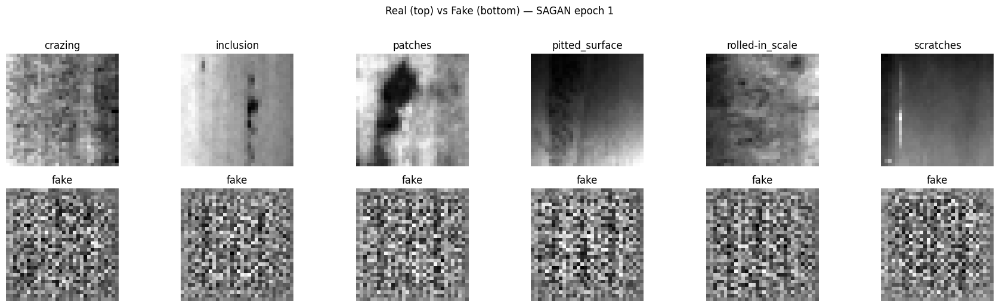

SAGAN Epoch 015/100 — D: 1.191 | G: -0.220


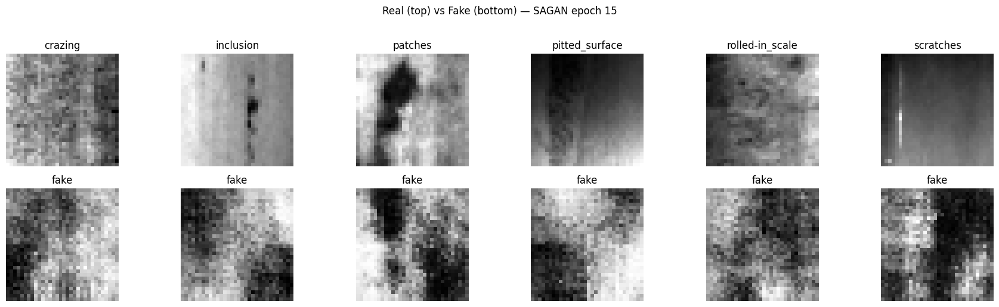

SAGAN Epoch 030/100 — D: 1.087 | G: -0.103


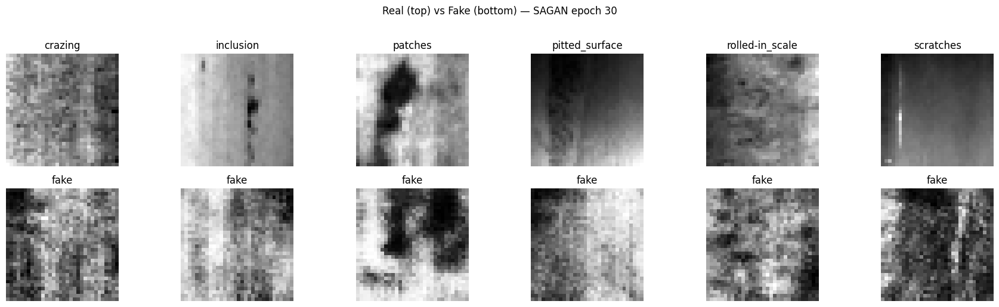

SAGAN Epoch 045/100 — D: 0.645 | G: -1.591


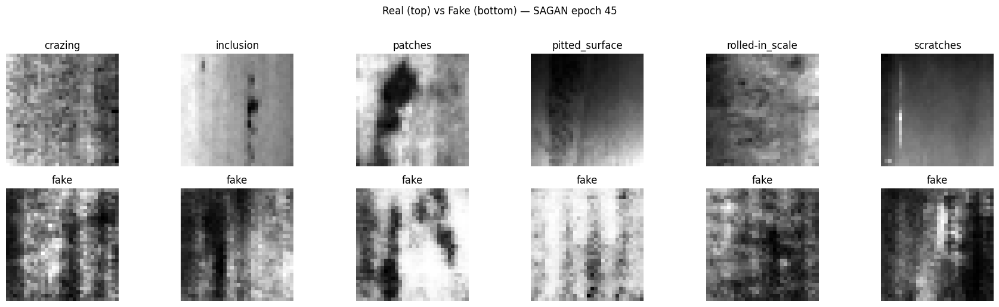

SAGAN Epoch 060/100 — D: 1.552 | G: 0.150


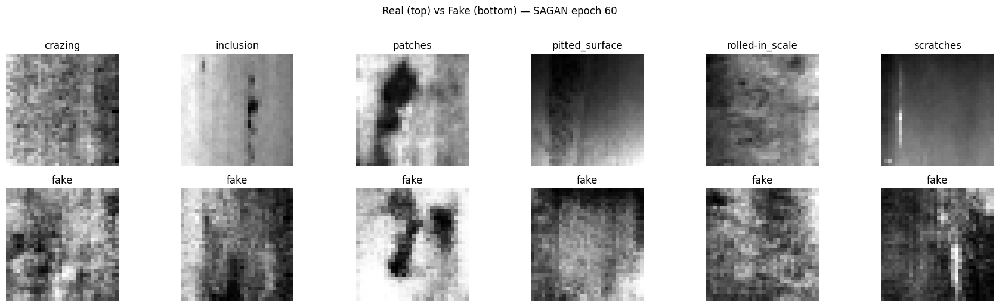

SAGAN Epoch 075/100 — D: 0.929 | G: -0.264


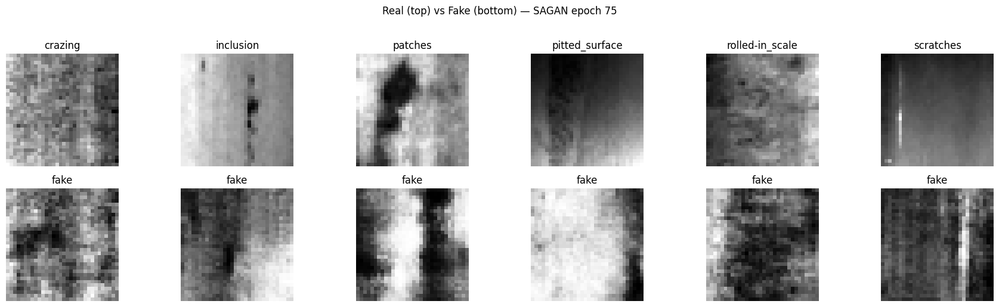

SAGAN Epoch 090/100 — D: 2.580 | G: 1.147


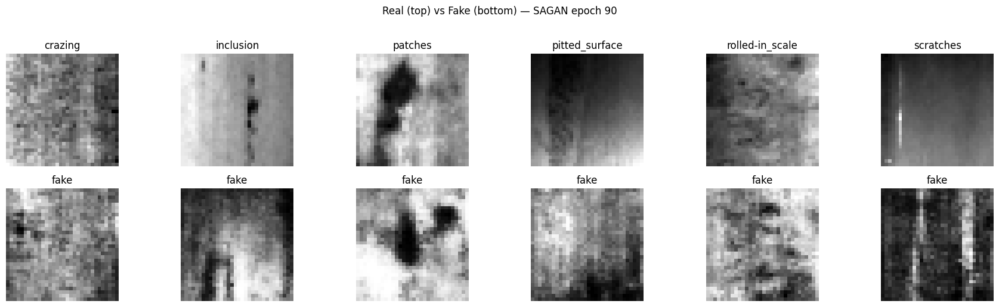

✅ SAGAN training complete.


In [80]:
# ============================================================
# 🚀 Train SAGAN or Q-SAGAN (hinge loss, TTUR) + EMA + DiffAug
#     (warm-up quantum off, tau anneal, gamma clamp, grad clip)
# ============================================================
TRAIN_WHICH = "sagan"   # "sagan" or "qsagan"
EPOCHS_SA   = 100
PRINT_EVERY = 15
warmup_epochs = 15  # ⬅️ quantum path off (gamma=0) for first N epochs

if TRAIN_WHICH == "sagan":
    G_trained = SAGANGenerator(z_dim=Z_DIM, n_classes=NCLS).to(device)
    D_trained = SAGANDiscriminator(n_classes=NCLS, width=64).to(device)
    train_dev = device
    tag = "SAGAN"
elif TRAIN_WHICH == "qsagan":
    train_dev = torch.device("cpu")  # PQC requires CPU
    G_trained = QSAGANGenerator(z_dim=Z_DIM, n_classes=NCLS, device=train_dev).to(train_dev)
    D_trained = SAGANDiscriminator(n_classes=NCLS, width=64).to(train_dev)
    _pin_quantum_cpu(G_trained)
    tag = "Q-SAGAN"
else:
    raise ValueError("TRAIN_WHICH must be 'sagan' or 'qsagan'")

optD = optim.Adam(D_trained.parameters(), lr=2e-4, betas=(0.0, 0.9))
optG = optim.Adam(G_trained.parameters(), lr=5e-5, betas=(0.0, 0.9))  # ⬅️ gentler G

# EMA of the generator for evaluation
ema = EMA(G_trained, decay=0.999)
if isinstance(G_trained, QSAGANGenerator):
    _pin_quantum_cpu(ema.ema)  # ✅ ensure EMA copy also has PQC on CPU

def _anneal_tau(model, ep, start=2.0, end=1.0, steps=30):
    """Linearly anneal tau after warmup."""
    if not isinstance(model, QSAGANGenerator): return
    t = max(0, ep - warmup_epochs)
    new_tau = max(end, start - (start-end) * min(t/steps, 1.0))
    with torch.no_grad():
        model.attn_q.tau.copy_(torch.tensor(new_tau, device=model.device))

print(f"\n🚀 Training {tag} for {EPOCHS_SA} epochs on {train_dev}...\n")
for ep in range(1, EPOCHS_SA+1):
    # ---- quantum warm-up gate & tau anneal ----
    if isinstance(G_trained, QSAGANGenerator):
        if ep <= warmup_epochs:
            with torch.no_grad():
                G_trained.attn_q.gamma.zero_()  # quantum path off
                G_trained.attn_q.tau.fill_(2.0)
        else:
            _anneal_tau(G_trained, ep, start=2.0, end=1.0, steps=30)

    for xb, yb in dl_gan:
        xb, yb = xb.to(train_dev), yb.to(train_dev)
        b = xb.size(0)

        # ---- D step ----
        z = torch.randn(b, Z_DIM, device=train_dev)
        with torch.no_grad():
            xf = G_trained(z, yb)
        xr = diffaug(xb); xf_aug = diffaug(xf)
        optD.zero_grad(set_to_none=True)
        d_loss = d_hinge(D_trained(xr, yb), D_trained(xf_aug, yb))
        d_loss.backward(); optD.step()

        # ---- G step (with grad clip) ----
        z = torch.randn(b, Z_DIM, device=train_dev)
        optG.zero_grad(set_to_none=True)
        g_out = G_trained(z, yb)
        g_loss = g_hinge(D_trained(g_out, yb))
        g_loss.backward()
        torch.nn.utils.clip_grad_norm_(G_trained.parameters(), 1.0)   # ⬅️ clip
        optG.step()

        # ---- EMA update ----
        ema.update(G_trained)

    if ep % PRINT_EVERY == 0 or ep == 1:
        print(f"{tag} Epoch {ep:03d}/{EPOCHS_SA} — D: {d_loss.item():.3f} | G: {g_loss.item():.3f}")
        show_real_fake_grid(G_trained, note=f"{tag} epoch {ep}")

print(f"✅ {tag} training complete.")

# Keep references for evaluation
G_sa  = G_trained if TRAIN_WHICH == "sagan"  else SAGANGenerator(z_dim=Z_DIM, n_classes=NCLS).to(device)
G_qsa = G_trained if TRAIN_WHICH == "qsagan" else QSAGANGenerator(z_dim=Z_DIM, n_classes=NCLS, device=torch.device('cpu')).to(torch.device('cpu'))
if isinstance(G_qsa, QSAGANGenerator):
    _pin_quantum_cpu(G_qsa)  # ✅ ensure eval-time QSAGAN is pinned

G_eval = ema.get()   # prefer EMA for metrics
if isinstance(G_eval, QSAGANGenerator):
    _pin_quantum_cpu(G_eval)  # ✅ pin the EMA snapshot too


In [81]:
# ============================================================
# 📏 FID + Precision–Recall (robust) — InceptionV3 w/ official transforms
#   - Uses torchvision Inception_V3_Weights.IMAGENET1K_V1 + transforms()
#   - Stable covariance via Ledoit–Wolf + ridge (FID)
#   - PR via k-NN radii on standardized features
#   - Works with grayscale 32×32 (upsample->299, tile to 3ch)
# ============================================================

import torch, torch.nn as nn, torch.nn.functional as F
import numpy as np
import pandas as pd
from torchvision.models import inception_v3, Inception_V3_Weights
from sklearn.covariance import LedoitWolf
from sklearn.decomposition import PCA


# -------------------------
# Inception feature extractor (pool3, 2048-d) with official preprocessing
# -------------------------
class InceptionPool3(nn.Module):
    def __init__(self, device):
        super().__init__()
        self.weights = Inception_V3_Weights.IMAGENET1K_V1
        # aux_logits=True is required by torchvision for pretrained inception_v3
        net = inception_v3(weights=self.weights, aux_logits=True, transform_input=False)
        net.fc = nn.Identity()                 # expose 2048-d prelogits
        self.features = net.eval().to(device)
        for p in self.parameters():
            p.requires_grad_(False)

    @torch.no_grad()
    def forward(self, x01):                    # x01: (B,3,H,W) in [0,1]
        # 1) resize to 299x299
        if x01.shape[-2:] != (299, 299):
            x01 = F.interpolate(x01, size=(299, 299), mode="bilinear", align_corners=False)
        # 2) official preprocessing from weights (ImageNet mean/std)
        preprocess = self.weights.transforms()
        dev = next(self.features.parameters()).device
        x_pre = preprocess(x01.cpu())          # torchvision transforms expect CPU tensor
        x_pre = x_pre.to(dev, non_blocking=True)
        # 3) forward to get 2048-d features (pre-FC)
        feats = self.features(x_pre)
        if feats.dim() > 2:                    # safety across torchvision versions
            feats = F.adaptive_avg_pool2d(feats, (1,1)).view(feats.size(0), -1)
        return feats

# -------------------------
# Helpers: convert [-1,1] grayscale to [0,1] RGB(3ch)
# -------------------------
@torch.no_grad()
def _to_rgb01(x):  # x in [-1,1], (B,1,H,W)
    x01 = (x.clamp(-1,1) + 1)/2
    x3  = x01.repeat(1,3,1,1)
    return x3

@torch.no_grad()
def inception_feats_from_loader(incept, dl, n_max=None):
    dev = next(incept.parameters()).device
    feats = []
    seen = 0
    for xb, _ in dl:
        xb = xb.to(dev)
        b  = xb.size(0)
        x3 = _to_rgb01(xb)
        f  = incept(x3)
        feats.append(f.cpu().numpy())
        seen += b
        if n_max and seen >= n_max: break
    return np.concatenate(feats, axis=0)[:n_max] if n_max else np.concatenate(feats, axis=0)

@torch.no_grad()
def inception_feats_from_generator(incept, G, dl, z_dim, n_max=None):
    devG = next(G.parameters()).device
    devI = next(incept.parameters()).device
    feats = []
    seen = 0
    for xb, yb in dl:
        b   = xb.size(0)
        yb  = yb.to(devG)
        z   = torch.randn(b, z_dim, device=devG)
        xg  = G(z, yb)                # [-1,1], (B,1,H,W)
        x3  = _to_rgb01(xg).to(devI)  # -> [0,1], 3ch
        f   = incept(x3)
        feats.append(f.cpu().numpy())
        seen += b
        if n_max and seen >= n_max: break
    return np.concatenate(feats, axis=0)[:n_max] if n_max else np.concatenate(feats, axis=0)

# -------------------------
# FID (robust): standardize by real, Ledoit–Wolf shrinkage + ridge, PSD sqrt
# -------------------------
def _finite_clean(X: np.ndarray):
    X = X.astype(np.float64, copy=False)
    m = np.all(np.isfinite(X), axis=1)
    X = X[m]
    if X.size == 0:
        raise ValueError("All features are non-finite.")
    return X

def _standardize_by_real(F_real: np.ndarray, F_fake: np.ndarray, clip=5.0, var_eps=1e-6):
    """Standardize by REAL stats; clip; drop near-constant dims."""
    F_real = _finite_clean(F_real)
    F_fake = _finite_clean(F_fake)

    mu = F_real.mean(axis=0)
    sd = F_real.std(axis=0)
    keep = sd >= var_eps
    if keep.sum() < 16:
        # fallback: keep top-variance 256 dims
        idx = np.argsort(sd)[::-1][:256]
        keep = np.zeros_like(sd, dtype=bool); keep[idx] = True

    mu = mu[keep]; sd = sd[keep]
    sd[sd < var_eps] = var_eps

    Rz = (F_real[:, keep] - mu) / sd
    Fz = (F_fake[:, keep] - mu) / sd

    if clip is not None:
        Rz = np.clip(Rz, -clip, clip)
        Fz = np.clip(Fz, -clip, clip)
    return Rz, Fz

def _pca_reduce(Rz: np.ndarray, Fz: np.ndarray, n_comp: int = 256):
    """PCA on REAL, apply to both sets; caps dimensionality and stabilizes covariances."""
    d = Rz.shape[1]
    n_comp = min(n_comp, d)
    pca = PCA(n_components=n_comp, svd_solver="randomized", whiten=False)
    Rr = pca.fit_transform(Rz)
    Fr = pca.transform(Fz)
    return Rr, Fr

def _cov_shrink(X: np.ndarray, ridge=5e-3):
    """Ledoit–Wolf covariance with symmetry + ridge."""
    lw = LedoitWolf(store_precision=False, assume_centered=False)
    lw.fit(X)
    S = lw.covariance_.astype(np.float64)
    d = S.shape[0]
    S = 0.5 * (S + S.T) + ridge * np.eye(d, dtype=np.float64)
    return S

def fid_from_feats(F_real: np.ndarray, F_fake: np.ndarray, ridge=5e-3, use_pca=True, pca_dim=256):
    """
    Robust FID:
      1) Standardize by real stats + clip + drop flat dims
      2) (Optional) PCA to 256 dims using REAL fit
      3) Ledoit–Wolf covariances + ridge
      4) Symmetrized product sqrt with finite checks
      5) If anything looks sketchy → diagonal (variance-only) fallback
    """
    # 1) standardize/clip
    Rz, Fz = _standardize_by_real(F_real, F_fake, clip=5.0, var_eps=1e-6)

    # 2) PCA (greatly stabilizes QSAGAN case)
    if use_pca:
        Rz, Fz = _pca_reduce(Rz, Fz, n_comp=pca_dim)

    # 3) covariances
    mu_r = Rz.mean(axis=0); mu_f = Fz.mean(axis=0)
    Sr = _cov_shrink(Rz, ridge=ridge)
    Sf = _cov_shrink(Fz, ridge=ridge)

    # 4) try full Fréchet; bail if any non-finite
    SrSf = 0.5 * (Sr @ Sf + Sf @ Sr) + ridge * np.eye(Sr.shape[0], dtype=np.float64)
    if not np.all(np.isfinite(SrSf)):
        # 5) clean diagonal fallback
        vr = np.clip(np.diag(Sr), ridge, None)
        vf = np.clip(np.diag(Sf), ridge, None)
        diff = (mu_r - mu_f)
        fid_diag = float(diff @ diff + np.sum(vr + vf - 2.0*np.sqrt(vr*vf)))
        return max(fid_diag, 0.0)

    # safe PSD sqrt
    vals, vecs = np.linalg.eigh(0.5*(SrSf + SrSf.T))
    vals = np.clip(vals, 0.0, None)
    SrSf_sqrt = (vecs * np.sqrt(vals)) @ vecs.T
    if (not np.all(np.isfinite(SrSf_sqrt))) or (np.any(vals == 0.0)):
        # diagonal fallback
        vr = np.clip(np.diag(Sr), ridge, None)
        vf = np.clip(np.diag(Sf), ridge, None)
        diff = (mu_r - mu_f)
        fid_diag = float(diff @ diff + np.sum(vr + vf - 2.0*np.sqrt(vr*vf)))
        return max(fid_diag, 0.0)

    diff = (mu_r - mu_f)
    fid = float(diff @ diff + np.trace(Sr + Sf - 2.0 * SrSf_sqrt))
    return max(fid, 0.0)

# -------------------------
# Precision–Recall (Kynkäännemi-style) with k-NN radii (standardized space)
# -------------------------
def _chunked_min_dists(A, B, bs=1024):
    A = A.astype(np.float32, copy=False); B = B.astype(np.float32, copy=False)
    NA = len(A); out = np.empty(NA, dtype=np.float32)
    for i in range(0, NA, bs):
        j = min(i+bs, NA)
        d2 = np.sum((A[i:j,None,:] - B[None,:,:])**2, axis=-1)
        out[i:j] = np.sqrt(np.minimum.reduce(d2, axis=1))
    return out

def _knn_radius_self(X, k=3, bs=1024):
    X = X.astype(np.float32, copy=False)
    N = len(X); r = np.empty(N, dtype=np.float32)
    for i in range(0, N, bs):
        j = min(i+bs, N)
        chunk = X[i:j]
        d2 = np.sum((chunk[:,None,:] - X[None,:,:])**2, axis=-1)
        for t in range(i, j):
            d2[t - i, t] = np.inf
        r[i:j] = np.sqrt(np.partition(d2, kth=max(0, 3-1), axis=1)[:, max(0, 3-1)])
    return r

def precision_recall_feats(F_real, F_fake, k=3):
    Rz, Fz = _standardize_by_real(F_real, F_fake, clip=5.0)
    r_real = _knn_radius_self(Rz, k=k)
    r_fake = _knn_radius_self(Fz, k=k)
    d_fr = _chunked_min_dists(Fz, Rz)  # fake -> nearest real
    d_rf = _chunked_min_dists(Rz, Fz)  # real -> nearest fake
    # Conservative, robust proxies (use medians of radii)
    prec = float(np.mean(d_fr <= np.median(r_real)))
    rec  = float(np.mean(d_rf <= np.median(r_fake)))
    return prec, rec

# -------------------------
# Runner: compute FID + PR for a pair of models
# -------------------------
@torch.no_grad()
def evaluate_fid_pr(GA, GB, names=("ModelA","ModelB"), dl=dl_gan, z_dim=Z_DIM, n_samples=1000, k_pr=3):
    # Inception lives on CUDA (if any) else MPS else CPU; images are moved accordingly
    devI = torch.device("cuda" if torch.cuda.is_available()
                        else "mps" if torch.backends.mps.is_available() else "cpu")
    incept = InceptionPool3(devI)

    # gather features for REAL set once
    F_real = inception_feats_from_loader(incept, dl, n_max=n_samples)

    # features for generated sets
    F_A = inception_feats_from_generator(incept, GA.eval(), dl, z_dim=z_dim, n_max=n_samples)
    F_B = inception_feats_from_generator(incept, GB.eval(), dl, z_dim=z_dim, n_max=n_samples)

    # sanity prints (optional)
    for nm, F in [("real", F_real), (names[0], F_A), (names[1], F_B)]:
        print(f"{nm:>10} | shape={F.shape} | finite={np.isfinite(F).all()} | mean={F.mean():.4f} std={F.std():.4f}")

    # FID
    fid_A = fid_from_feats(F_real, F_A)
    fid_B = fid_from_feats(F_real, F_B)

    # PR
    prec_A, rec_A = precision_recall_feats(F_real, F_A, k=k_pr)
    prec_B, rec_B = precision_recall_feats(F_real, F_B, k=k_pr)

    df = pd.DataFrame({
        "name": [names[0], names[1]],
        "FID ↓": [fid_A, fid_B],
        "Precision ↑": [prec_A, prec_B],
        "Recall ↑": [rec_A, rec_B],
    })
    return df

# ===== Example call =====
# Make sure QSAGAN is pinned if present (so PQC stays on CPU)
try:
    for _G in [globals().get("G_sa"), globals().get("G_qsa")]:
        if _G is not None and isinstance(_G, QSAGANGenerator):
            _pin_quantum_cpu(_G)
except NameError:
    pass  # QSAGANGenerator/_pin_quantum_cpu may live in earlier cell; this is just a safeguard

try:
    df_fp = evaluate_fid_pr(
        GA=G_sa if "G_sa" in globals() else G_eval,   # pick your EMA/best SAGAN
        GB=G_qsa if "G_qsa" in globals() else G_eval, # pick your EMA/best Q-SAGAN
        names=("SAGAN (EMA)", "Q-SAGAN (EMA)"),
        dl=dl_gan,
        z_dim=Z_DIM,
        n_samples=1000,   # 500–5000 typical; larger = stabler
        k_pr=3
    )
    display(df_fp.round(4))
except Exception as e:
    print("FID/PR evaluation error:", e)


      real | shape=(1000, 2048) | finite=True | mean=0.2780 std=0.3633
SAGAN (EMA) | shape=(1000, 2048) | finite=True | mean=0.2787 std=0.3754
Q-SAGAN (EMA) | shape=(1000, 2048) | finite=True | mean=0.1526 std=0.3317


/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:350: RuntimeWarning: divide by zero encountered in matmul
  Q, _ = normalizer(A @ Q)
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:350: RuntimeWarning: overflow encountered in matmul
  Q, _ = normalizer(A @ Q)
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:350: RuntimeWarning: invalid value encountered in matmul
  Q, _ = normalizer(A @ Q)
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:351: RuntimeWarning: divide by zero encountered in matmul
  Q, _ = normalizer(A.T @ Q)
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:351: RuntimeWarning: overflow encountered in matmul
  Q

,name,FID ↓,Precision ↑,Recall ↑
0,SAGAN (EMA),245.9470,0.524,0.121
1,Q-SAGAN (EMA),3432.6537,0.000,0.000



⏱ Evaluating SAGAN (EMA) ...
✅ SAGAN (EMA): Label Fidelity=0.185 | Diversity=0.145 | RBF-MMD=0.218

📁 Saved: sagan_qsagan_comparison.csv


,name,fidelity,diversity,mmd,total_time,median_epoch,throughput
0,SAGAN (EMA),0.185,0.145,0.218,0.685,0.174,1869.265


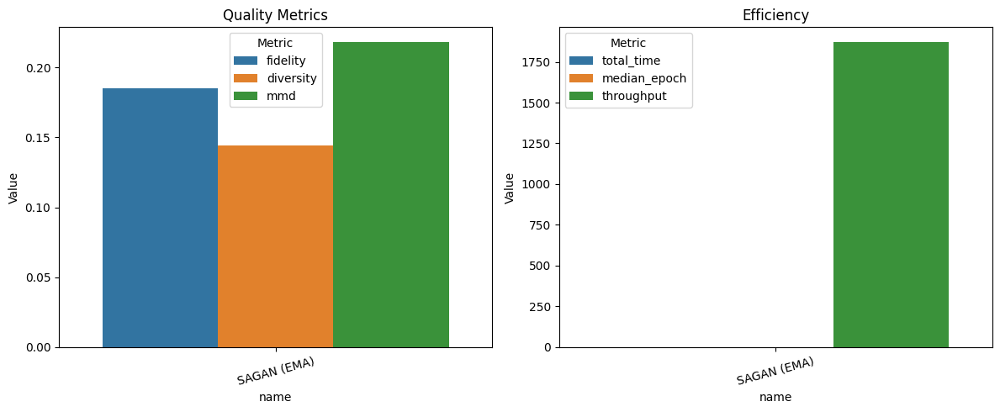

In [78]:
# ============================================================
# 📊 Metrics & Efficiency — evaluate trained model(s)
# ============================================================
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from torchvision import models

def _safe_pairwise_np(X):
    X = np.clip(X.astype(np.float32, copy=False), 0.0, 1.0)
    diffs = X[:,None,:] - X[None,:,:]
    return np.sqrt(np.sum(diffs*diffs, axis=-1, dtype=np.float32))

def _rbf_mmd_np(X, Y, sigma=None):
    DX = _safe_pairwise_np(X)
    DY = _safe_pairwise_np(Y)
    DXY = _safe_pairwise_np(np.vstack([X, Y]))[:len(X), len(X):]
    if sigma is None:
        pool = np.concatenate([DX[np.triu_indices(len(X),1)],
                               DY[np.triu_indices(len(Y),1)],
                               DXY.reshape(-1)], axis=0)
        pool = pool[pool > 0]
        sigma = np.median(pool) if pool.size else 1.0
    Kxx = np.exp(-(DX**2)/(2*sigma**2)).mean()
    Kyy = np.exp(-(DY**2)/(2*sigma**2)).mean()
    Kxy = np.exp(-(DXY**2)/(2*sigma**2)).mean()
    return float(Kxx + Kyy - 2*Kxy)

@torch.no_grad()
def compute_sagan_metrics(G_model, name="Model", n_samples=200, dl=dl_gan):
    dev = _dev_of(G_model)
    G_model.eval()

    # proxy classifier
    cls = models.resnet18(weights=None)
    cls.conv1 = torch.nn.Conv2d(1, 64, kernel_size=3, stride=1, padding=1, bias=False)
    cls.fc = torch.nn.Linear(512, NCLS)
    cls = cls.to(dev).eval()

    # fixed eval seed for reproducibility
    g_state = torch.random.get_rng_state()
    torch.manual_seed(1234)

    reals, fakes, preds, labels = [], [], [], []
    seen = 0
    for xb, yb in dl:
        xb, yb = xb.to(dev), yb.to(dev)
        b = xb.size(0)
        z = torch.randn(b, Z_DIM, device=dev)
        _sync()
        xf = (G_model(z, yb).clamp(-1,1) + 1)/2  # [0,1]
        _sync()
        reals.append(((xb.clamp(-1,1)+1)/2).detach().cpu().view(b, -1).numpy())
        fakes.append(xf.detach().cpu().view(b, -1).numpy())
        preds.append(cls(xf).argmax(1).cpu())
        labels.append(yb.cpu())
        seen += b
        if seen >= n_samples: break

    # restore RNG
    torch.random.set_rng_state(g_state)

    real = np.concatenate(reals, axis=0)[:n_samples]
    fake = np.concatenate(fakes, axis=0)[:n_samples]
    y_true = torch.cat(labels)[:n_samples]
    y_pred = torch.cat(preds)[:n_samples]
    label_fid = (y_pred == y_true).float().mean().item()
    diversity = _safe_pairwise_np(fake).mean()
    rbf = _rbf_mmd_np(real, fake)

    print(f"✅ {name}: Label Fidelity={label_fid:.3f} | Diversity={diversity:.3f} | RBF-MMD={rbf:.3f}")
    return dict(name=name, fidelity=label_fid, diversity=diversity, mmd=rbf)

def measure_efficiency(G_model, dl=dl_gan, n_batches=20, z_dim=Z_DIM, warmup=3):
    dev = _dev_of(G_model)
    G_model.eval()
    times = []
    it = iter(dl)
    with torch.no_grad():
        for _ in range(warmup):
            try: _, yb = next(it)
            except StopIteration: it = iter(dl); _, yb = next(it)
            yb = yb.to(dev); z  = torch.randn(yb.size(0), z_dim, device=dev)
            _ = G_model(z, yb)
        start = time.time()
        for _ in range(n_batches):
            try: _, yb = next(it)
            except StopIteration: it = iter(dl); _, yb = next(it)
            yb = yb.to(dev); z  = torch.randn(yb.size(0), z_dim, device=dev)
            _sync(); t0 = time.perf_counter()
            _ = G_model(z, yb)
            _sync(); times.append(time.perf_counter() - t0)
        total_time = time.time() - start
    med_step = float(np.median(times)) if times else float("nan")
    est_epoch = med_step * len(dl)
    throughput = (n_batches * yb.size(0)) / total_time if total_time>0 else float("nan")
    return dict(total_time=total_time, median_epoch=est_epoch, throughput=throughput)

# Evaluate: trained variant + EMA + (optionally) the other baseline
models_to_test = []
# Evaluate EMA generator of the trained model
models_to_test.append((f"{tag} (EMA)", G_eval))
# If you also want raw (non-EMA) numbers, uncomment:
# models_to_test.append((tag, G_trained))

# If you want the opposite architecture for reference, keep as you had:
# if isinstance(G_sa, SAGANGenerator): models_to_test.append(("SAGAN", G_sa))
# if isinstance(G_qsa, QSAGANGenerator): models_to_test.append(("Quantum-SAGAN", G_qsa))

# ✅ Pin any QSAGAN before running metrics
for i, (name, mdl) in enumerate(models_to_test):
    if isinstance(mdl, QSAGANGenerator):
        _pin_quantum_cpu(mdl)

results = []
for name, model in models_to_test:
    print(f"\n⏱ Evaluating {name} ...")
    m = compute_sagan_metrics(model, name=name)
    t = measure_efficiency(model)
    results.append({**m, **t})

df_sagan = pd.DataFrame(results)
df_sagan.to_csv("sagan_qsagan_comparison.csv", index=False)
print("\n📁 Saved: sagan_qsagan_comparison.csv")
display(df_sagan.round(3))

# Plots
fig, ax = plt.subplots(1, 2, figsize=(12,5))
df_m1 = df_sagan.melt(id_vars="name", value_vars=["fidelity","diversity","mmd"],
                      var_name="Metric", value_name="Value")
sns.barplot(data=df_m1, x="name", y="Value", hue="Metric", ax=ax[0])
ax[0].set_title("Quality Metrics")
ax[0].tick_params(axis='x', rotation=15)

df_m2 = df_sagan.melt(id_vars="name", value_vars=["total_time","median_epoch","throughput"],
                      var_name="Metric", value_name="Value")
sns.barplot(data=df_m2, x="name", y="Value", hue="Metric", ax=ax[1])
ax[1].set_title("Efficiency")
ax[1].tick_params(axis='x', rotation=15)
plt.tight_layout(); plt.show()

In [67]:
# ============================================================
# 📊 Metrics & Efficiency Comparison — SAGAN vs Q-SAGAN
# ============================================================

import time
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import pairwise_distances
from torchvision import models

# --- helper: compute GAN quality metrics ---
@torch.no_grad()
def compute_sagan_metrics(G_model, name="Model", n_samples=200, dl=dl_gan):
    G_model.eval()
    all_real, all_fake, all_preds, all_labels = [], [], [], []

    # small proxy classifier for label fidelity
    cls = models.resnet18(weights=None)
    cls.conv1 = torch.nn.Conv2d(1, 64, kernel_size=3, stride=1, padding=1, bias=False)
    cls.fc = torch.nn.Linear(512, NCLS)
    cls = cls.to(device).eval()

    for i, (xb, yb) in enumerate(dl):
        xb, yb = xb.to(device), yb.to(device)
        b = xb.size(0)
        z = torch.randn(b, Z_DIM, device=device)
        xf = (G_model(z, yb).clamp(-1, 1) + 1) / 2
        all_real.append(xb.cpu())
        all_fake.append(xf.cpu())
        preds = cls(xf).argmax(1)
        all_preds.append(preds.cpu())
        all_labels.append(yb.cpu())
        if len(all_fake) * b >= n_samples:
            break

    real = torch.cat(all_real)[:n_samples].view(n_samples, -1).numpy()
    fake = torch.cat(all_fake)[:n_samples].view(n_samples, -1).numpy()
    y_true = torch.cat(all_labels)[:n_samples]
    y_pred = torch.cat(all_preds)[:n_samples]
    label_fid = (y_pred == y_true).float().mean().item()

    # diversity
    diversity = torch.cdist(torch.tensor(fake), torch.tensor(fake)).mean().item()

    # RBF-MMD
    def rbf_mmd(x, y, sigma=1.0):
        xx = pairwise_distances(x, x)
        yy = pairwise_distances(y, y)
        xy = pairwise_distances(x, y)
        Kxx = np.exp(-xx**2 / (2 * sigma**2)).mean()
        Kyy = np.exp(-yy**2 / (2 * sigma**2)).mean()
        Kxy = np.exp(-xy**2 / (2 * sigma**2)).mean()
        return float(Kxx + Kyy - 2 * Kxy)

    rbf = rbf_mmd(real, fake)

    print(f"✅ {name}: Label Fidelity={label_fid:.3f} | Diversity={diversity:.3f} | RBF-MMD={rbf:.3f}")
    return dict(name=name, fidelity=label_fid, diversity=diversity, mmd=rbf)

# --- helper: measure generator speed ---
def measure_efficiency(G_model, dl=dl_gan, n_batches=20, z_dim=Z_DIM):
    start = time.time()
    batch_times = []
    for i, (xb, yb) in enumerate(dl):
        if i >= n_batches: break
        xb, yb = xb.to(device), yb.to(device)
        z = torch.randn(xb.size(0), z_dim, device=device)
        t0 = time.time()
        _ = G_model(z, yb)
        batch_times.append(time.time() - t0)
    total_time = time.time() - start
    median_epoch = np.median(batch_times) * len(dl)
    throughput = (n_batches * xb.size(0)) / total_time
    return dict(total_time=total_time, median_epoch=median_epoch, throughput=throughput)

# --- evaluate both models ---
models_to_test = [
    ("SAGAN", G_sa),
    ("Quantum-SAGAN", G_qsa if 'G_qsa' in globals() else QSAGANGenerator(z_dim=Z_DIM, n_classes=NCLS, device=device))
]

results = []
for name, model in models_to_test:
    print(f"\n⏱ Evaluating {name} ...")
    m = compute_sagan_metrics(model, name=name)
    t = measure_efficiency(model)
    results.append({**m, **t})

df_sagan = pd.DataFrame(results)
df_sagan.to_csv("sagan_qsagan_comparison.csv", index=False)
print("\n📁 Saved: sagan_qsagan_comparison.csv")
print(df_sagan.round(3))

# --- visualization ---
fig, ax = plt.subplots(1, 2, figsize=(12,5))
df_melt_q = df_sagan.melt(id_vars="name", value_vars=["fidelity","diversity","mmd"],
                          var_name="Metric", value_name="Value")
sns.barplot(data=df_melt_q, x="name", y="Value", hue="Metric", ax=ax[0])
ax[0].set_title("Quality Metrics — SAGAN vs Quantum-SAGAN")
ax[0].tick_params(axis='x', rotation=15)

df_eff_q = df_sagan.melt(id_vars="name", value_vars=["total_time","median_epoch","throughput"],
                         var_name="Metric", value_name="Value")
sns.barplot(data=df_eff_q, x="name", y="Value", hue="Metric", ax=ax[1])
ax[1].set_title("Efficiency Metrics — SAGAN vs Quantum-SAGAN")
ax[1].tick_params(axis='x', rotation=15)
plt.tight_layout()
plt.show()

# --- Δ% improvement heatmap ---
base = df_sagan.loc[df_sagan['name']=="SAGAN"].iloc[0]
qs = df_sagan.loc[df_sagan['name']=="Quantum-SAGAN"].iloc[0]
delta = {
    "Label Fidelity Δ%": ((qs['fidelity'] - base['fidelity']) / base['fidelity']) * 100,
    "Diversity Δ%": ((qs['diversity'] - base['diversity']) / base['diversity']) * 100,
    "RBF-MMD Δ%": ((qs['mmd'] - base['mmd']) / base['mmd']) * 100,
    "Throughput Δ%": ((qs['throughput'] - base['throughput']) / base['throughput']) * 100,
}
delta_df = pd.DataFrame([delta]).T.rename(columns={0: "Change (%)"})

plt.figure(figsize=(6, 2.5))
sns.heatmap(delta_df.T, annot=True, fmt=".2f", cmap="coolwarm", center=0,
            cbar_kws={'label':'% change'}, linewidths=0.5)
plt.title("Δ% Improvement — Quantum-SAGAN vs SAGAN")
plt.tight_layout()
plt.savefig("qsagan_vs_sagan_heatmap.png", dpi=300)
plt.show()

print("✅ Saved: sagan_qsagan_comparison.csv & qsagan_vs_sagan_heatmap.png")



⏱ Evaluating SAGAN ...


/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defec

✅ SAGAN: Label Fidelity=0.240 | Diversity=10.592 | RBF-MMD=0.011

⏱ Evaluating Quantum-SAGAN ...


RuntimeError: Mismatched Tensor types in NNPack convolutionOutput

Class counts: {5: 231, 1: 235, 2: 234, 0: 238, 3: 236, 4: 234}
Pixel mean   (global): 0.471 ± 0.125
Pixel std    (global): 0.201 ± 0.044
Blur (LapVar) average: 0.065  (lower ≈ blurrier)


TypeError: Invalid shape (3, 70, 206) for image data

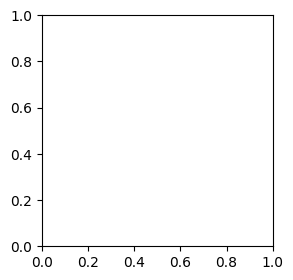

In [55]:
# 🔎 Data sanity audit for your dl_gan
import torch, numpy as np, matplotlib.pyplot as plt
from collections import Counter
from torchvision.utils import make_grid

device0 = torch.device("cpu")
counts = Counter()
means, stds, blurs = [], [], []

def laplacian_var(x):  # x in [0,1], CHW
    k = torch.tensor([[0,1,0],[1,-4,1],[0,1,0]], dtype=x.dtype).unsqueeze(0).unsqueeze(0)
    y = torch.nn.functional.conv2d(x.unsqueeze(0), k, padding=1)
    return float(y.var().cpu())

samples = []
for i, (xb, yb) in enumerate(dl_gan):
    xb = ((xb.clamp(-1,1)+1)/2.0).to(device0)  # [0,1]
    for img, lab in zip(xb, yb):
        counts[int(lab)] += 1
        means.append(float(img.mean()))
        stds.append(float(img.std()))
        blurs.append(laplacian_var(img))
        if len(samples) < 12: samples.append(img)
    if i > 50: break  # enough for a snapshot

print("Class counts:", dict(counts))
print(f"Pixel mean   (global): {np.mean(means):.3f} ± {np.std(means):.3f}")
print(f"Pixel std    (global): {np.mean(stds):.3f} ± {np.std(stds):.3f}")
print(f"Blur (LapVar) average: {np.mean(blurs):.3f}  (lower ≈ blurrier)")

# quick grid
grid = make_grid(torch.stack(samples), nrow=6, padding=2)
plt.figure(figsize=(8,3)); plt.imshow(grid.squeeze().cpu(), cmap="gray"); plt.axis("off")
plt.title("Random training samples (after normalization)"); plt.show()


In [40]:
# ============================================================
# 🧠 Cell — QGAN-Hybrid Generator (Quantum-Enhanced Generator)
# ============================================================

import torch
import torch.nn as nn
import pennylane as qml
from pennylane.qnn import TorchLayer

# --- Quantum device setup ---
n_qubits, n_layers = 6, 2
dev_q = qml.device("default.qubit", wires=n_qubits)

@qml.qnode(dev_q, interface="torch")
def qnode(inputs, weights):
    """Quantum circuit encoding classical input + trainable rotations"""
    qml.AngleEmbedding(inputs, wires=range(n_qubits))
    qml.templates.StronglyEntanglingLayers(weights, wires=range(n_qubits))
    return [qml.expval(qml.PauliZ(i)) for i in range(n_qubits)]

# Define weight shapes for TorchLayer (needed by PennyLane)
weight_shapes = {"weights": (n_layers, n_qubits, 3)}


In [41]:
# ============================================================
# ⚙️ Hybrid Generator (Quantum + Classical)
# ============================================================

class QHybridGen(nn.Module):
    """
    Quantum-Hybrid Generator:
      [z | y_emb] -> pre_q (CPU) -> quantum circuit (CPU) -> post MLP (GPU/MPS)
    The quantum layer acts as a feature extractor to introduce non-classical correlations.
    """
    def __init__(self, z_dim=64, n_classes=NCLS, emb_dim=16, device="cpu"):
        super().__init__()
        self.device_post = device  # where the post-MLP runs

        # CPU-side components
        self.embed = nn.Embedding(n_classes, emb_dim).to("cpu")
        self.pre_q = nn.Linear(z_dim + emb_dim, n_qubits).to("cpu")
        self.q     = TorchLayer(qnode, weight_shapes).to("cpu")

        # Decoder on device (same as classical generator’s structure)
        self.post = nn.Sequential(
            nn.Linear(n_qubits, 256), nn.LeakyReLU(0.2, True),
            nn.Linear(256, 512),     nn.LeakyReLU(0.2, True),
            nn.Linear(512, 1024),    nn.LeakyReLU(0.2, True),
            nn.Linear(1024, 32*32),  nn.Tanh(),  # output in [-1,1]
        ).to(device)

    def forward(self, z, y):
        z_cpu, y_cpu = z.detach().to("cpu"), y.detach().to("cpu")
        yemb = self.embed(y_cpu)
        h = self.pre_q(torch.cat([z_cpu, yemb], dim=1))
        h = self.q(h)
        h_dev = torch.as_tensor(h, device=self.device_post)
        out = self.post(h_dev)
        return out.view(-1, 1, 32, 32)



🚀 Starting Quantum-Hybrid GAN training for 250 epochs...

QGAN Epoch 001/250 — D: 0.350 | G: 6.515


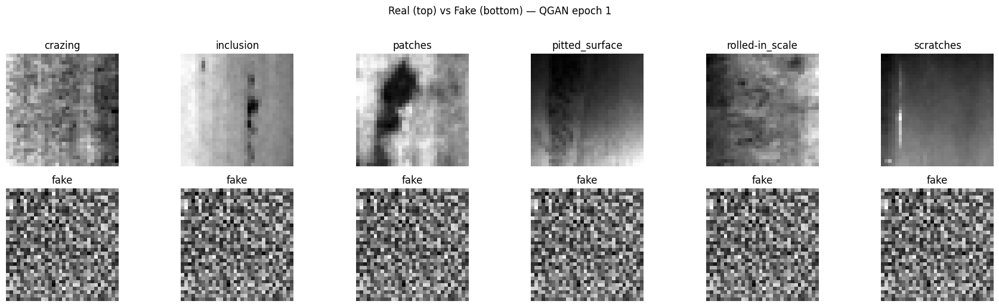

QGAN Epoch 002/250 — D: 0.107 | G: 2.319
QGAN Epoch 003/250 — D: 0.186 | G: 2.907
QGAN Epoch 004/250 — D: 0.049 | G: 2.438
QGAN Epoch 005/250 — D: 0.137 | G: 5.102
QGAN Epoch 006/250 — D: 0.125 | G: 1.848
QGAN Epoch 007/250 — D: 1.156 | G: 2.189
QGAN Epoch 008/250 — D: 0.236 | G: 2.147
QGAN Epoch 009/250 — D: 0.191 | G: 2.331
QGAN Epoch 010/250 — D: 0.119 | G: 3.401


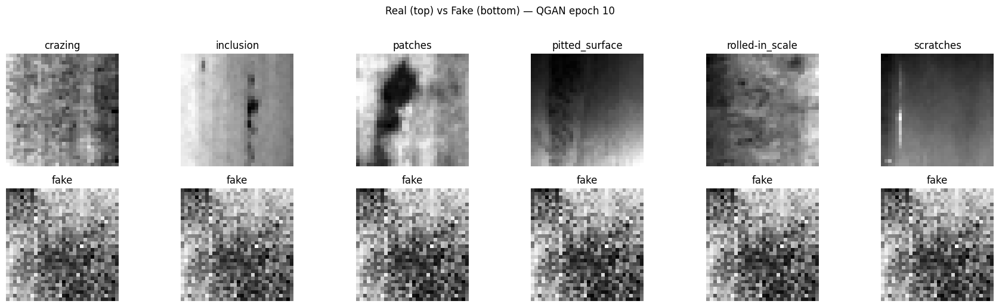

QGAN Epoch 011/250 — D: 0.184 | G: 4.347
QGAN Epoch 012/250 — D: 0.113 | G: 3.312
QGAN Epoch 013/250 — D: 0.159 | G: 2.952
QGAN Epoch 014/250 — D: 1.005 | G: 6.393
QGAN Epoch 015/250 — D: 0.276 | G: 1.610
QGAN Epoch 016/250 — D: 0.524 | G: 2.738
QGAN Epoch 017/250 — D: 0.207 | G: 3.505
QGAN Epoch 018/250 — D: 0.562 | G: 3.015
QGAN Epoch 019/250 — D: 0.145 | G: 4.360
QGAN Epoch 020/250 — D: 0.185 | G: 3.560


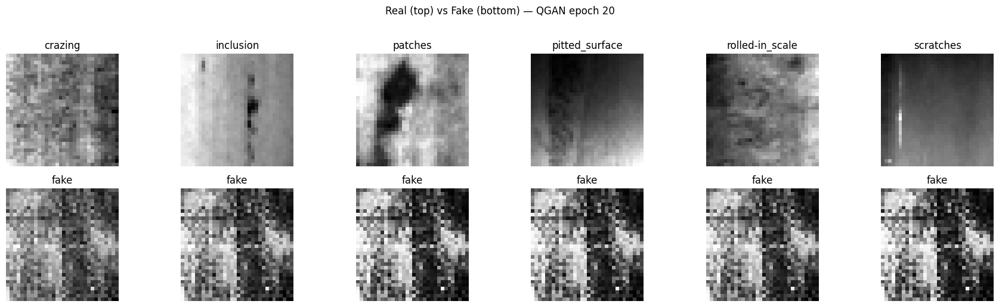

QGAN Epoch 021/250 — D: 0.416 | G: 4.577
QGAN Epoch 022/250 — D: 0.274 | G: 2.628
QGAN Epoch 023/250 — D: 0.329 | G: 3.519
QGAN Epoch 024/250 — D: 0.834 | G: 1.980
QGAN Epoch 025/250 — D: 0.631 | G: 3.822
QGAN Epoch 026/250 — D: 1.103 | G: 2.892
QGAN Epoch 027/250 — D: 1.183 | G: 3.113
QGAN Epoch 028/250 — D: 0.610 | G: 2.593
QGAN Epoch 029/250 — D: 0.716 | G: 1.681
QGAN Epoch 030/250 — D: 0.552 | G: 3.059


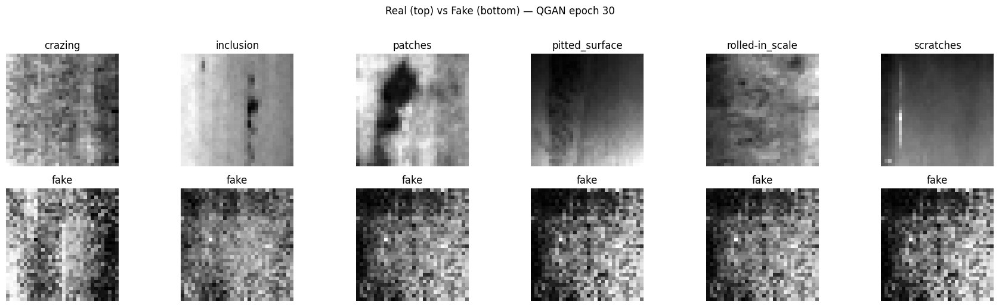

QGAN Epoch 031/250 — D: 0.542 | G: 2.200
QGAN Epoch 032/250 — D: 0.340 | G: 2.242
QGAN Epoch 033/250 — D: 0.762 | G: 2.801
QGAN Epoch 034/250 — D: 0.893 | G: 2.082
QGAN Epoch 035/250 — D: 0.878 | G: 2.207
QGAN Epoch 036/250 — D: 0.542 | G: 2.095
QGAN Epoch 037/250 — D: 0.543 | G: 2.134
QGAN Epoch 038/250 — D: 0.653 | G: 2.523
QGAN Epoch 039/250 — D: 0.357 | G: 2.644
QGAN Epoch 040/250 — D: 0.925 | G: 1.524


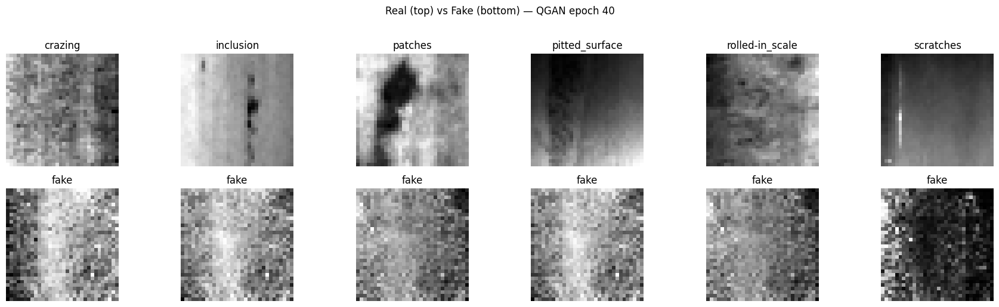

QGAN Epoch 041/250 — D: 0.299 | G: 1.592
QGAN Epoch 042/250 — D: 0.553 | G: 2.175
QGAN Epoch 043/250 — D: 0.801 | G: 2.685
QGAN Epoch 044/250 — D: 0.793 | G: 1.396
QGAN Epoch 045/250 — D: 0.946 | G: 3.627
QGAN Epoch 046/250 — D: 0.838 | G: 1.969
QGAN Epoch 047/250 — D: 1.031 | G: 1.173
QGAN Epoch 048/250 — D: 0.925 | G: 0.778
QGAN Epoch 049/250 — D: 0.422 | G: 1.759
QGAN Epoch 050/250 — D: 0.525 | G: 2.080


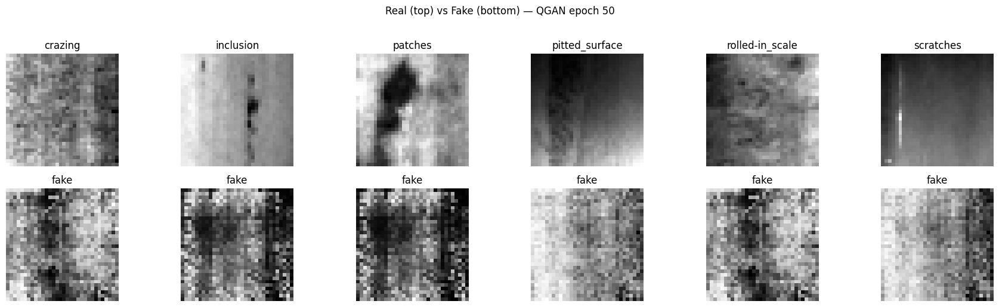

QGAN Epoch 051/250 — D: 0.630 | G: 1.933
QGAN Epoch 052/250 — D: 0.586 | G: 2.407
QGAN Epoch 053/250 — D: 0.256 | G: 1.954
QGAN Epoch 054/250 — D: 0.453 | G: 1.782
QGAN Epoch 055/250 — D: 0.437 | G: 2.121
QGAN Epoch 056/250 — D: 0.587 | G: 2.518
QGAN Epoch 057/250 — D: 0.595 | G: 2.154
QGAN Epoch 058/250 — D: 0.592 | G: 3.210
QGAN Epoch 059/250 — D: 0.850 | G: 1.404
QGAN Epoch 060/250 — D: 0.724 | G: 2.475


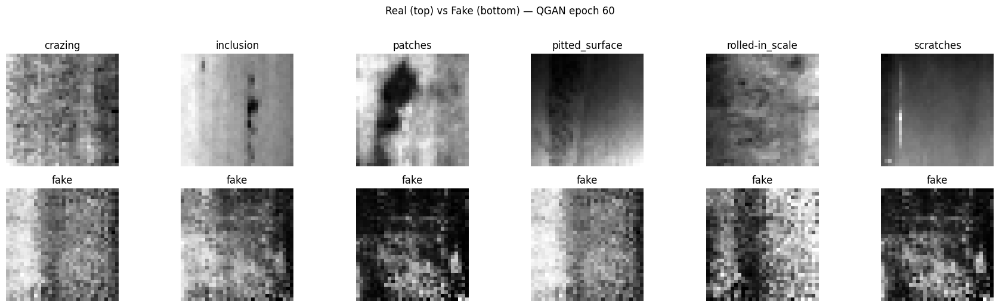

QGAN Epoch 061/250 — D: 0.433 | G: 3.093
QGAN Epoch 062/250 — D: 0.892 | G: 2.453
QGAN Epoch 063/250 — D: 0.886 | G: 2.751
QGAN Epoch 064/250 — D: 0.620 | G: 2.212
QGAN Epoch 065/250 — D: 0.521 | G: 3.922
QGAN Epoch 066/250 — D: 0.755 | G: 1.910
QGAN Epoch 067/250 — D: 0.674 | G: 2.757
QGAN Epoch 068/250 — D: 0.702 | G: 2.015
QGAN Epoch 069/250 — D: 0.901 | G: 2.716
QGAN Epoch 070/250 — D: 0.558 | G: 2.049


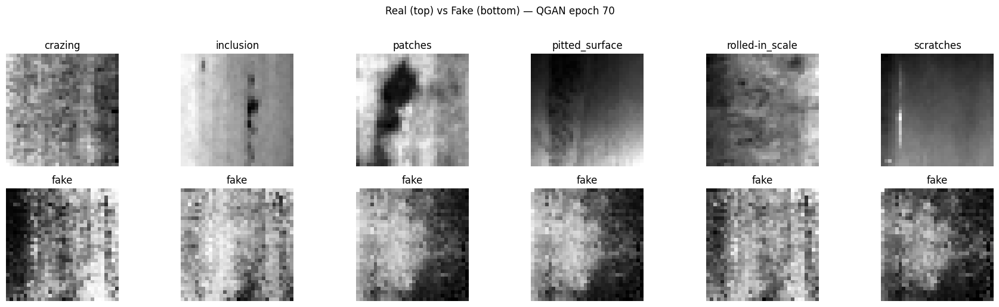

QGAN Epoch 071/250 — D: 0.473 | G: 2.459
QGAN Epoch 072/250 — D: 0.520 | G: 1.944
QGAN Epoch 073/250 — D: 0.529 | G: 3.066
QGAN Epoch 074/250 — D: 0.512 | G: 2.175
QGAN Epoch 075/250 — D: 0.542 | G: 2.355
QGAN Epoch 076/250 — D: 0.829 | G: 2.545
QGAN Epoch 077/250 — D: 0.582 | G: 2.259
QGAN Epoch 078/250 — D: 1.478 | G: 2.872
QGAN Epoch 079/250 — D: 0.812 | G: 3.101
QGAN Epoch 080/250 — D: 0.966 | G: 1.777


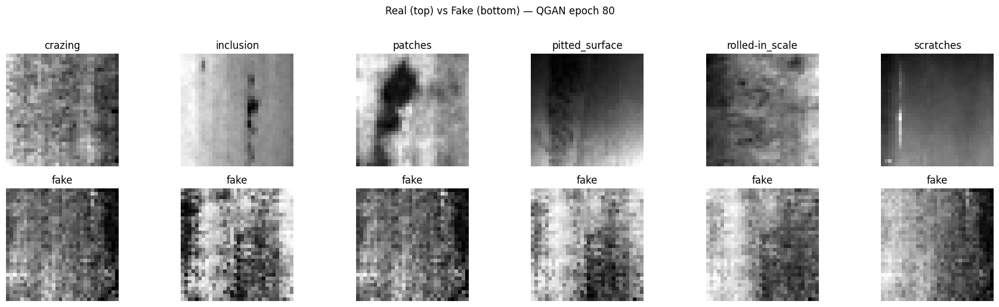

QGAN Epoch 081/250 — D: 0.712 | G: 2.786
QGAN Epoch 082/250 — D: 0.549 | G: 1.795
QGAN Epoch 083/250 — D: 0.531 | G: 1.906
QGAN Epoch 084/250 — D: 0.505 | G: 1.701
QGAN Epoch 085/250 — D: 0.361 | G: 2.435
QGAN Epoch 086/250 — D: 0.496 | G: 2.610
QGAN Epoch 087/250 — D: 0.565 | G: 2.059
QGAN Epoch 088/250 — D: 0.449 | G: 1.732
QGAN Epoch 089/250 — D: 0.393 | G: 1.827
QGAN Epoch 090/250 — D: 0.839 | G: 1.938


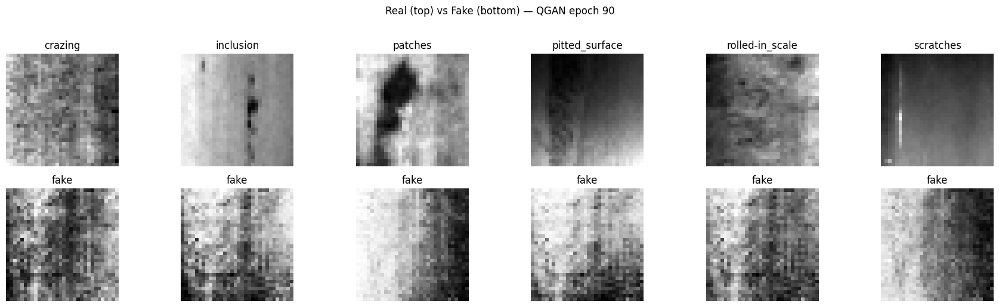

QGAN Epoch 091/250 — D: 0.777 | G: 2.816
QGAN Epoch 092/250 — D: 0.622 | G: 2.573
QGAN Epoch 093/250 — D: 0.895 | G: 1.973
QGAN Epoch 094/250 — D: 0.637 | G: 2.335
QGAN Epoch 095/250 — D: 0.813 | G: 2.816
QGAN Epoch 096/250 — D: 0.587 | G: 2.442
QGAN Epoch 097/250 — D: 0.730 | G: 3.068
QGAN Epoch 098/250 — D: 0.272 | G: 2.103
QGAN Epoch 099/250 — D: 0.551 | G: 2.424
QGAN Epoch 100/250 — D: 0.753 | G: 2.814


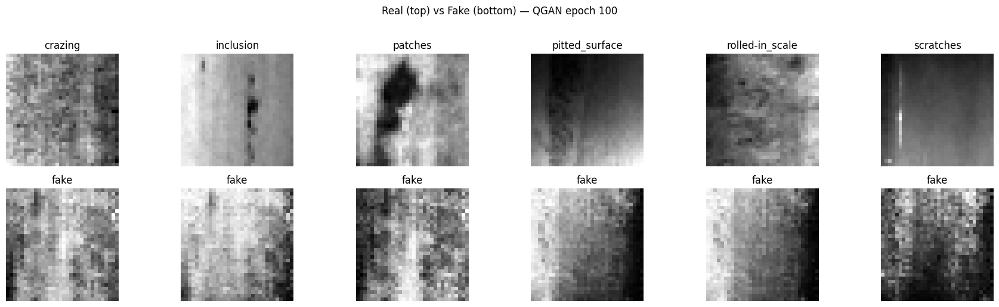

QGAN Epoch 101/250 — D: 0.525 | G: 1.971
QGAN Epoch 102/250 — D: 0.419 | G: 3.051
QGAN Epoch 103/250 — D: 0.326 | G: 2.594
QGAN Epoch 104/250 — D: 0.255 | G: 1.764
QGAN Epoch 105/250 — D: 0.826 | G: 1.715
QGAN Epoch 106/250 — D: 0.462 | G: 2.778
QGAN Epoch 107/250 — D: 0.486 | G: 2.287
QGAN Epoch 108/250 — D: 0.302 | G: 2.361
QGAN Epoch 109/250 — D: 0.522 | G: 2.151
QGAN Epoch 110/250 — D: 0.384 | G: 1.729


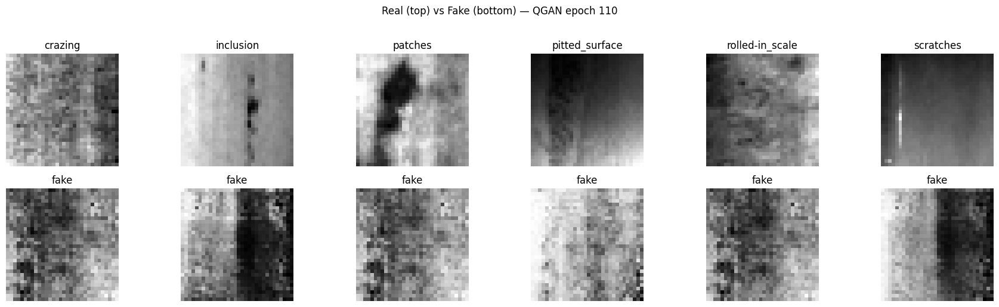

QGAN Epoch 111/250 — D: 0.538 | G: 3.160
QGAN Epoch 112/250 — D: 0.608 | G: 2.704
QGAN Epoch 113/250 — D: 0.590 | G: 2.824
QGAN Epoch 114/250 — D: 0.472 | G: 3.222
QGAN Epoch 115/250 — D: 0.475 | G: 1.960
QGAN Epoch 116/250 — D: 0.679 | G: 1.224
QGAN Epoch 117/250 — D: 0.399 | G: 1.796
QGAN Epoch 118/250 — D: 0.281 | G: 2.569
QGAN Epoch 119/250 — D: 0.804 | G: 1.567
QGAN Epoch 120/250 — D: 0.927 | G: 2.413


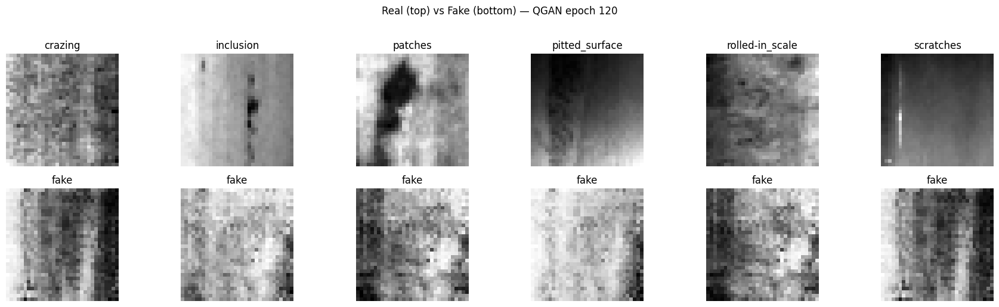

QGAN Epoch 121/250 — D: 0.377 | G: 1.770
QGAN Epoch 122/250 — D: 0.353 | G: 2.558
QGAN Epoch 123/250 — D: 0.329 | G: 2.506
QGAN Epoch 124/250 — D: 0.390 | G: 2.733
QGAN Epoch 125/250 — D: 0.555 | G: 2.098
QGAN Epoch 126/250 — D: 0.764 | G: 1.846
QGAN Epoch 127/250 — D: 0.414 | G: 2.298
QGAN Epoch 128/250 — D: 0.533 | G: 2.420
QGAN Epoch 129/250 — D: 0.404 | G: 2.370
QGAN Epoch 130/250 — D: 0.401 | G: 3.443


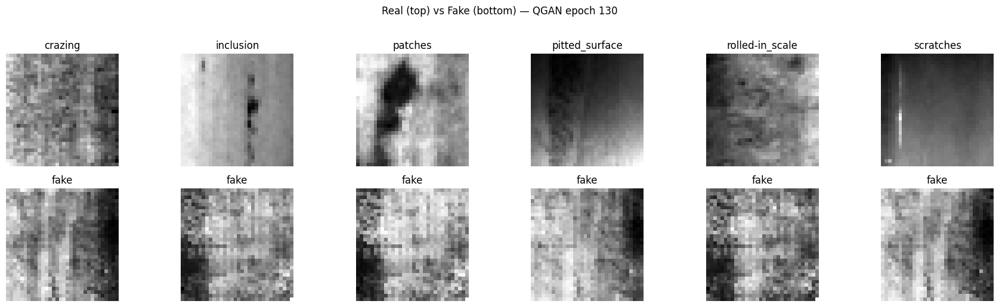

QGAN Epoch 131/250 — D: 0.264 | G: 2.867
QGAN Epoch 132/250 — D: 0.540 | G: 2.630
QGAN Epoch 133/250 — D: 0.373 | G: 2.412
QGAN Epoch 134/250 — D: 0.445 | G: 2.837
QGAN Epoch 135/250 — D: 0.395 | G: 1.969
QGAN Epoch 136/250 — D: 0.475 | G: 3.747
QGAN Epoch 137/250 — D: 0.992 | G: 3.119
QGAN Epoch 138/250 — D: 0.525 | G: 2.175
QGAN Epoch 139/250 — D: 0.496 | G: 1.409
QGAN Epoch 140/250 — D: 0.406 | G: 2.232


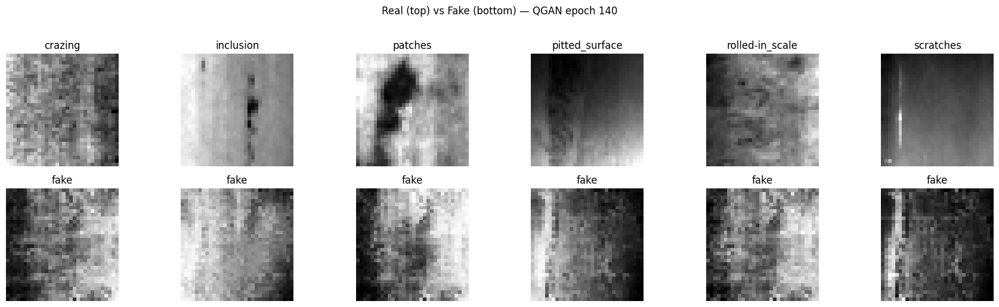

QGAN Epoch 141/250 — D: 0.562 | G: 2.464
QGAN Epoch 142/250 — D: 0.539 | G: 2.816
QGAN Epoch 143/250 — D: 0.553 | G: 2.240
QGAN Epoch 144/250 — D: 0.527 | G: 1.585
QGAN Epoch 145/250 — D: 0.461 | G: 2.943
QGAN Epoch 146/250 — D: 0.306 | G: 2.282
QGAN Epoch 147/250 — D: 0.371 | G: 1.934
QGAN Epoch 148/250 — D: 0.410 | G: 2.359
QGAN Epoch 149/250 — D: 0.828 | G: 2.770
QGAN Epoch 150/250 — D: 0.710 | G: 3.018


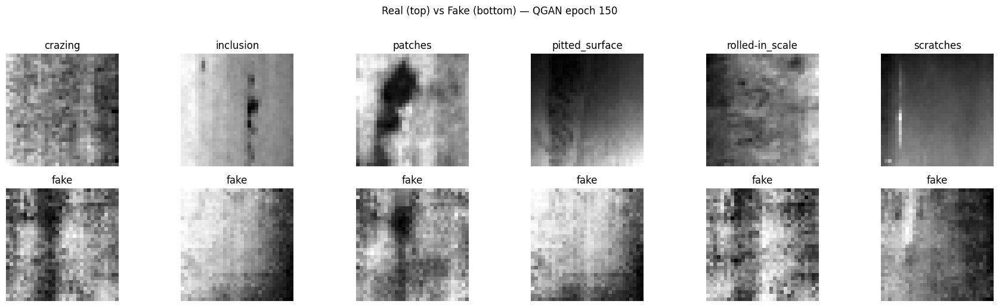

QGAN Epoch 151/250 — D: 0.446 | G: 2.723
QGAN Epoch 152/250 — D: 0.678 | G: 1.619
QGAN Epoch 153/250 — D: 0.496 | G: 2.380
QGAN Epoch 154/250 — D: 0.484 | G: 2.347
QGAN Epoch 155/250 — D: 0.516 | G: 1.848
QGAN Epoch 156/250 — D: 0.409 | G: 2.475
QGAN Epoch 157/250 — D: 0.685 | G: 1.378
QGAN Epoch 158/250 — D: 0.807 | G: 1.509
QGAN Epoch 159/250 — D: 0.476 | G: 1.991
QGAN Epoch 160/250 — D: 0.454 | G: 1.559


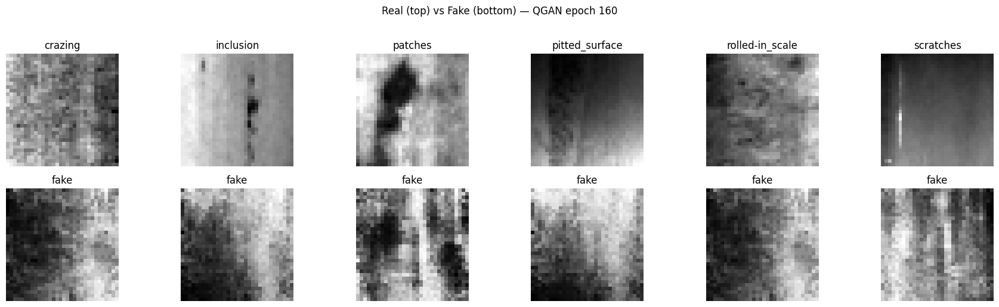

QGAN Epoch 161/250 — D: 0.219 | G: 2.147
QGAN Epoch 162/250 — D: 0.453 | G: 1.771
QGAN Epoch 163/250 — D: 0.502 | G: 1.592
QGAN Epoch 164/250 — D: 0.548 | G: 1.979
QGAN Epoch 165/250 — D: 0.532 | G: 1.056
QGAN Epoch 166/250 — D: 0.902 | G: 1.573
QGAN Epoch 167/250 — D: 0.611 | G: 2.293
QGAN Epoch 168/250 — D: 0.738 | G: 1.518
QGAN Epoch 169/250 — D: 0.659 | G: 2.281
QGAN Epoch 170/250 — D: 0.304 | G: 1.725


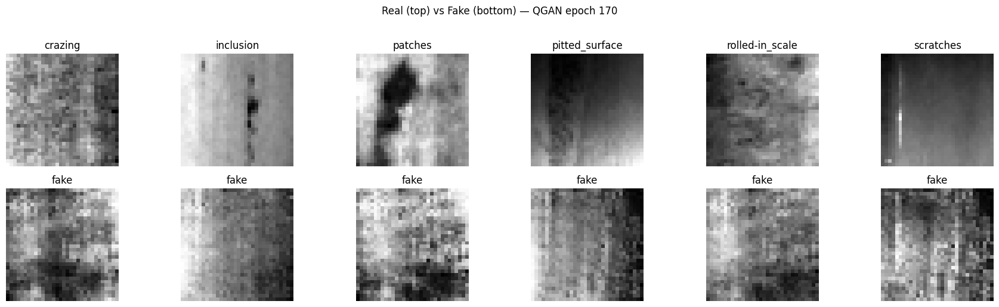

QGAN Epoch 171/250 — D: 0.509 | G: 1.813
QGAN Epoch 172/250 — D: 0.627 | G: 0.738
QGAN Epoch 173/250 — D: 0.371 | G: 2.322
QGAN Epoch 174/250 — D: 0.546 | G: 2.534
QGAN Epoch 175/250 — D: 0.461 | G: 2.094
QGAN Epoch 176/250 — D: 0.532 | G: 1.653
QGAN Epoch 177/250 — D: 0.564 | G: 2.335
QGAN Epoch 178/250 — D: 0.446 | G: 2.158
QGAN Epoch 179/250 — D: 0.539 | G: 1.647
QGAN Epoch 180/250 — D: 0.762 | G: 2.115


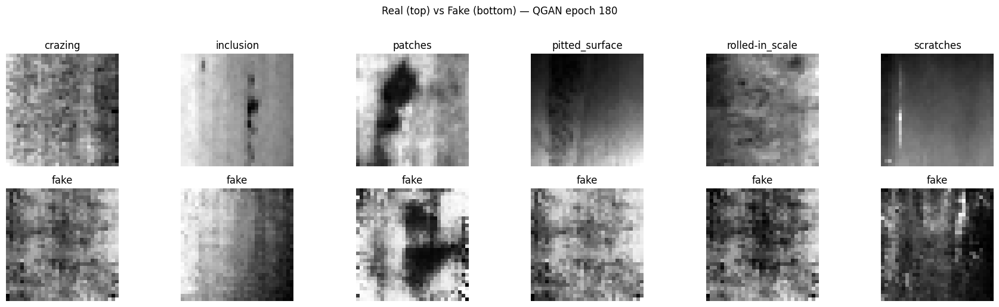

QGAN Epoch 181/250 — D: 0.964 | G: 1.477
QGAN Epoch 182/250 — D: 0.478 | G: 1.541
QGAN Epoch 183/250 — D: 0.943 | G: 2.356
QGAN Epoch 184/250 — D: 0.642 | G: 1.704
QGAN Epoch 185/250 — D: 0.571 | G: 1.848
QGAN Epoch 186/250 — D: 0.678 | G: 1.881
QGAN Epoch 187/250 — D: 0.754 | G: 1.248
QGAN Epoch 188/250 — D: 0.507 | G: 1.862
QGAN Epoch 189/250 — D: 0.548 | G: 1.381
QGAN Epoch 190/250 — D: 1.250 | G: 1.543


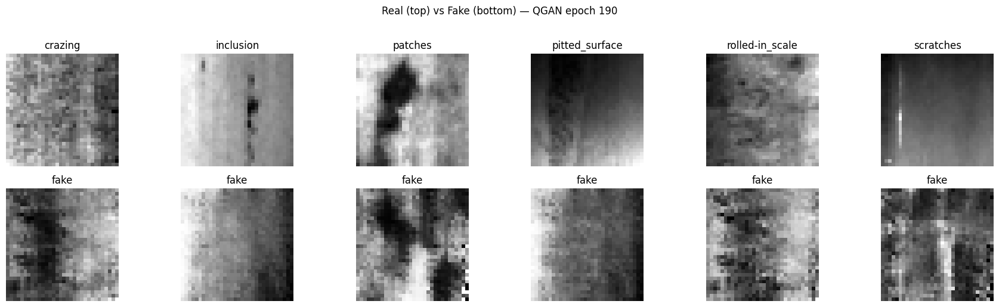

QGAN Epoch 191/250 — D: 0.740 | G: 1.337
QGAN Epoch 192/250 — D: 0.832 | G: 2.225
QGAN Epoch 193/250 — D: 0.796 | G: 2.258
QGAN Epoch 194/250 — D: 0.996 | G: 1.404
QGAN Epoch 195/250 — D: 0.768 | G: 2.085
QGAN Epoch 196/250 — D: 0.563 | G: 2.002
QGAN Epoch 197/250 — D: 0.821 | G: 1.278
QGAN Epoch 198/250 — D: 0.610 | G: 1.824
QGAN Epoch 199/250 — D: 0.789 | G: 1.941
QGAN Epoch 200/250 — D: 0.974 | G: 1.300


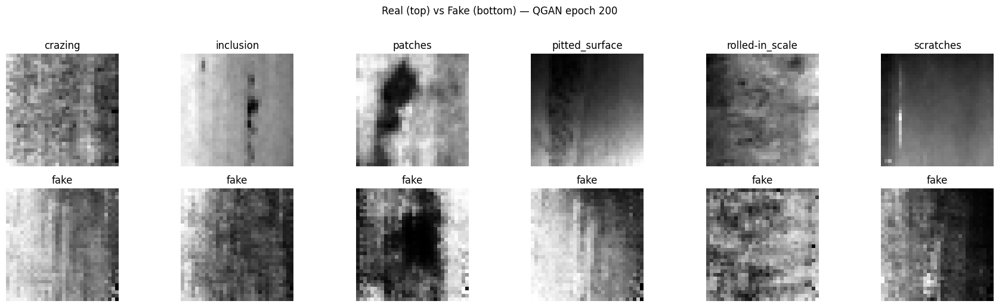

QGAN Epoch 201/250 — D: 0.743 | G: 1.720
QGAN Epoch 202/250 — D: 0.663 | G: 1.264
QGAN Epoch 203/250 — D: 1.083 | G: 1.518
QGAN Epoch 204/250 — D: 0.642 | G: 2.063
QGAN Epoch 205/250 — D: 0.667 | G: 2.363
QGAN Epoch 206/250 — D: 0.646 | G: 1.156
QGAN Epoch 207/250 — D: 0.560 | G: 1.478
QGAN Epoch 208/250 — D: 0.580 | G: 1.848
QGAN Epoch 209/250 — D: 0.575 | G: 1.603
QGAN Epoch 210/250 — D: 0.762 | G: 1.519


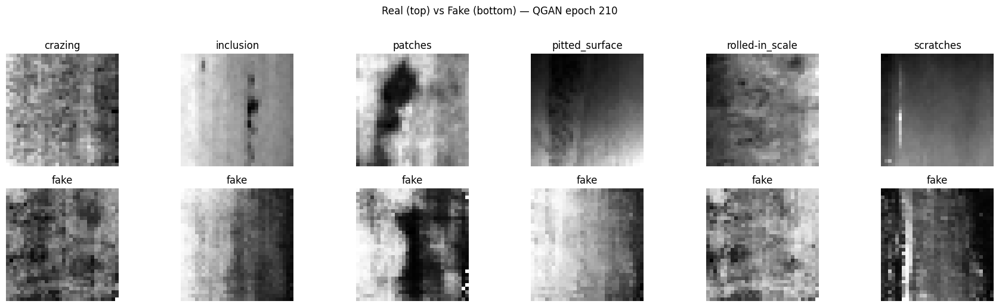

QGAN Epoch 211/250 — D: 0.925 | G: 2.857
QGAN Epoch 212/250 — D: 0.391 | G: 1.567
QGAN Epoch 213/250 — D: 0.567 | G: 1.705
QGAN Epoch 214/250 — D: 0.471 | G: 1.196
QGAN Epoch 215/250 — D: 0.759 | G: 1.420
QGAN Epoch 216/250 — D: 0.659 | G: 1.898
QGAN Epoch 217/250 — D: 0.965 | G: 1.868
QGAN Epoch 218/250 — D: 0.520 | G: 1.945
QGAN Epoch 219/250 — D: 0.785 | G: 2.238
QGAN Epoch 220/250 — D: 0.890 | G: 1.781


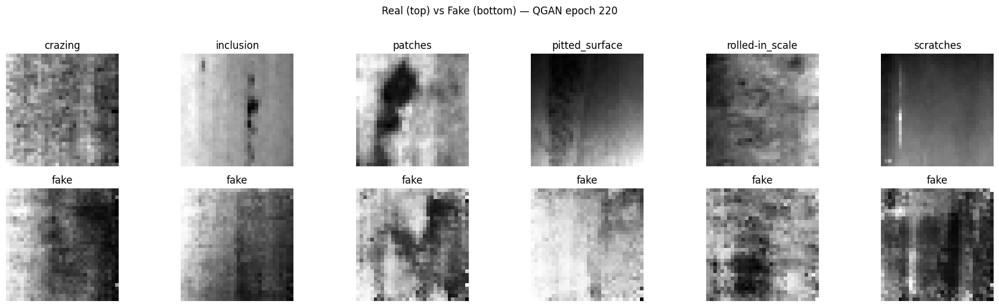

QGAN Epoch 221/250 — D: 0.736 | G: 1.405
QGAN Epoch 222/250 — D: 0.518 | G: 2.097
QGAN Epoch 223/250 — D: 0.503 | G: 1.648
QGAN Epoch 224/250 — D: 0.660 | G: 1.297
QGAN Epoch 225/250 — D: 0.833 | G: 2.953
QGAN Epoch 226/250 — D: 0.912 | G: 1.197
QGAN Epoch 227/250 — D: 0.751 | G: 1.297
QGAN Epoch 228/250 — D: 0.797 | G: 2.161
QGAN Epoch 229/250 — D: 0.782 | G: 2.279
QGAN Epoch 230/250 — D: 0.729 | G: 1.224


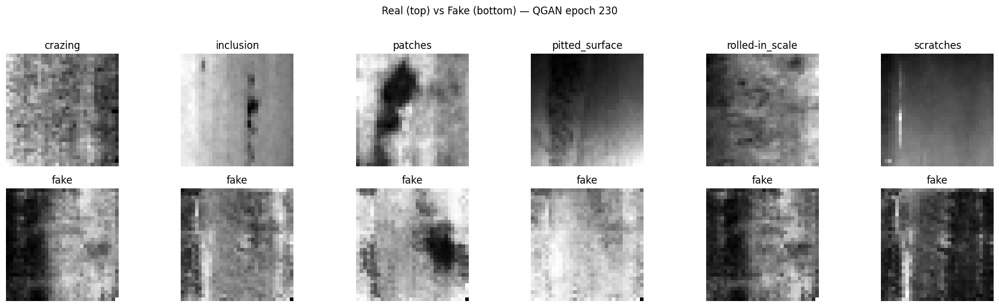

QGAN Epoch 231/250 — D: 1.232 | G: 2.203
QGAN Epoch 232/250 — D: 0.622 | G: 1.219
QGAN Epoch 233/250 — D: 0.847 | G: 1.154
QGAN Epoch 234/250 — D: 0.695 | G: 2.042
QGAN Epoch 235/250 — D: 0.941 | G: 1.056
QGAN Epoch 236/250 — D: 0.976 | G: 1.678
QGAN Epoch 237/250 — D: 0.634 | G: 0.714
QGAN Epoch 238/250 — D: 0.871 | G: 1.999
QGAN Epoch 239/250 — D: 0.484 | G: 2.034
QGAN Epoch 240/250 — D: 0.842 | G: 2.273


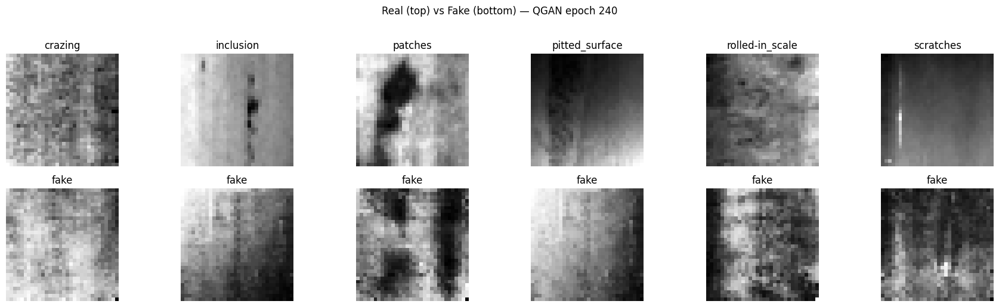

QGAN Epoch 241/250 — D: 0.828 | G: 1.030
QGAN Epoch 242/250 — D: 0.649 | G: 2.097
QGAN Epoch 243/250 — D: 0.764 | G: 1.709
QGAN Epoch 244/250 — D: 0.509 | G: 1.792
QGAN Epoch 245/250 — D: 0.481 | G: 1.408
QGAN Epoch 246/250 — D: 0.926 | G: 1.656
QGAN Epoch 247/250 — D: 0.687 | G: 2.636
QGAN Epoch 248/250 — D: 0.778 | G: 1.743
QGAN Epoch 249/250 — D: 0.633 | G: 1.918
QGAN Epoch 250/250 — D: 1.002 | G: 2.051


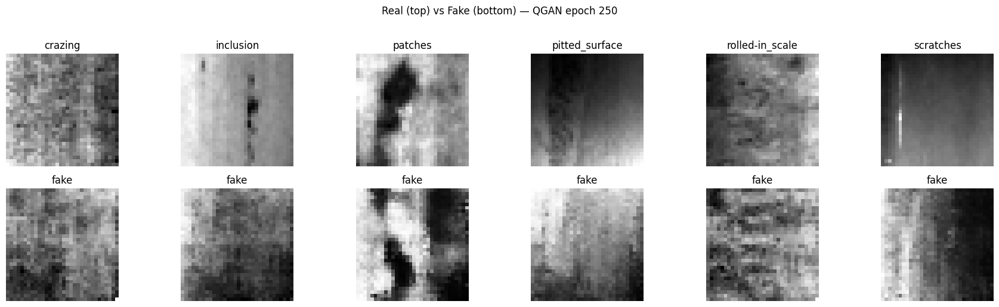

✅ QGAN-Hybrid training finished in 5.2 min.


In [42]:
# ============================================================
# 🚀 Train Quantum-Hybrid GAN
# ============================================================

import time
import torch.optim as optim

# Instantiate QGAN models
G_qgan = QHybridGen(z_dim=Z_DIM, n_classes=NCLS, emb_dim=16, device=device)
D_qgan = ProjectionDiscriminator(n_classes=NCLS, width=64).to(device)

optDq = optim.Adam(D_qgan.parameters(), lr=2e-4, betas=(0.0, 0.9))
optGq = optim.Adam(G_qgan.parameters(), lr=1e-4, betas=(0.0, 0.9))

EPOCHS_Q = 250
t0 = time.perf_counter()
print(f"\n🚀 Starting Quantum-Hybrid GAN training for {EPOCHS_Q} epochs...\n")

for ep in range(1, EPOCHS_Q+1):
    G_qgan.train(); D_qgan.train()
    for xb, yb in dl_gan:
        xb, yb = xb.to(device), yb.to(device)
        b = xb.size(0)

        # D step
        z = torch.randn(b, Z_DIM, device=device)
        with torch.no_grad(): fake = G_qgan(z, yb).detach()
        optDq.zero_grad()
        d_real = D_qgan(xb, yb); d_fake = D_qgan(fake, yb)
        d_loss = d_hinge(d_real, d_fake)
        d_loss.backward(); optDq.step()

        # G step
        z = torch.randn(b, Z_DIM, device=device)
        optGq.zero_grad()
        g_loss = g_hinge(D_qgan(G_qgan(z, yb), yb))
        g_loss.backward(); optGq.step()

    print(f"QGAN Epoch {ep:03d}/{EPOCHS_Q} — D: {d_loss.item():.3f} | G: {g_loss.item():.3f}")

    if ep % 10 == 0 or ep == 1:
        show_real_fake_grid(G_qgan, note=f"QGAN epoch {ep}")

print(f"✅ QGAN-Hybrid training finished in {(time.perf_counter()-t0)/60:.1f} min.")


/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defec

✅ Classical cGAN (EMA): Label Fidelity=0.145 | Diversity=8.868 | RBF-MMD=0.996
✅ Quantum-Hybrid GAN: Label Fidelity=0.145 | Diversity=9.329 | RBF-MMD=1.013
📁 Saved: gan_comparison_plot.png & gan_metrics_summary.csv


/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/ananyakulkarni/Desktop/Quantum Defec

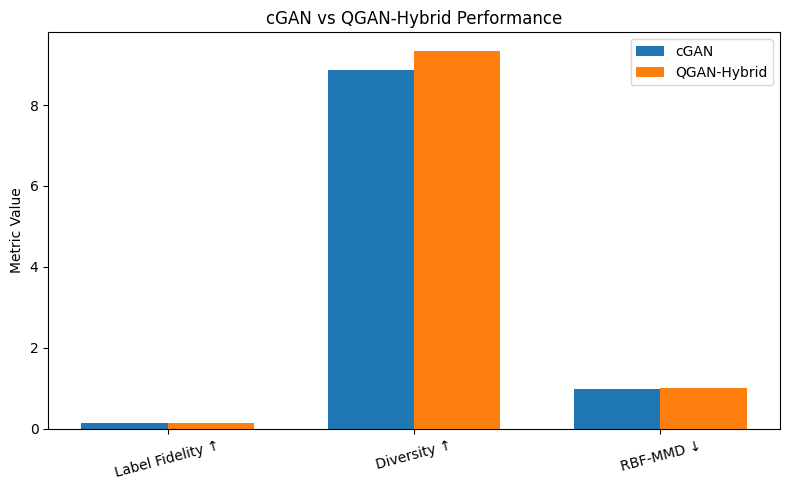

In [43]:
# ============================================================
# 📊 Final GAN Metrics Comparison — Stable + Export Ready
# ============================================================

import numpy as np
import torch
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import pairwise_distances

def safe_pairwise(X):
    """Safely compute pairwise distances (avoids overflow)."""
    X = np.clip(X, 0, 1)  # ensure bounded pixel values
    return np.nan_to_num(pairwise_distances(X, X, metric='euclidean'), nan=0.0, posinf=1e6, neginf=0.0)

@torch.no_grad()
def compute_gan_metrics(G_model, name="Model", n_samples=200):
    G_model.eval()
    all_real, all_fake, all_preds, all_labels = [], [], [], []

    # Small classifier proxy
    cls = models.resnet18(weights=None)
    cls.conv1 = torch.nn.Conv2d(1, 64, kernel_size=3, stride=1, padding=1, bias=False)
    cls.fc = torch.nn.Linear(512, NCLS)
    cls = cls.to(device).eval()

    for i, (xb, yb) in enumerate(dl_gan):
        xb, yb = xb.to(device), yb.to(device)
        b = xb.size(0)
        z = torch.randn(b, Z_DIM, device=device)
        xf = (G_model(z, yb).clamp(-1, 1) + 1) / 2
        all_real.append(xb.cpu())
        all_fake.append(xf.cpu())
        preds = cls(xf).argmax(1)
        all_preds.append(preds.cpu())
        all_labels.append(yb.cpu())
        if len(all_fake) * b >= n_samples:
            break

    real = torch.cat(all_real)[:n_samples].view(n_samples, -1).numpy()
    fake = torch.cat(all_fake)[:n_samples].view(n_samples, -1).numpy()
    y_true = torch.cat(all_labels)[:n_samples]
    y_pred = torch.cat(all_preds)[:n_samples]
    label_fid = (y_pred == y_true).float().mean().item()

    # --- Diversity ---
    D_fake = safe_pairwise(fake)
    diversity = D_fake.mean()

    # --- RBF-MMD ---
    sigma = np.median(D_fake[D_fake > 0])
    if sigma == 0 or np.isnan(sigma): sigma = 1.0
    D_rf = safe_pairwise(np.vstack([real, fake]))
    Kxx = np.exp(-D_fake**2 / (2 * sigma**2)).mean()
    Kyy = Kxx
    Kxy = np.exp(-pairwise_distances(fake, real)**2 / (2 * sigma**2)).mean()
    mmd = float(Kxx + Kyy - 2 * Kxy)

    print(f"✅ {name}: Label Fidelity={label_fid:.3f} | Diversity={diversity:.3f} | RBF-MMD={mmd:.3f}")
    return dict(name=name, fidelity=label_fid, diversity=diversity, mmd=mmd)


# --- Evaluate both models ---
metrics_cgan = compute_gan_metrics(G_ema,  name="Classical cGAN (EMA)")
metrics_qgan = compute_gan_metrics(G_qgan, name="Quantum-Hybrid GAN")

# --- Plot comparison ---
labels = ["Label Fidelity ↑", "Diversity ↑", "RBF-MMD ↓"]
cgan_vals = [metrics_cgan['fidelity'], metrics_cgan['diversity'], metrics_cgan['mmd']]
qgan_vals = [metrics_qgan['fidelity'], metrics_qgan['diversity'], metrics_qgan['mmd']]

x = np.arange(len(labels))
width = 0.35
fig, ax = plt.subplots(figsize=(8,5))
ax.bar(x - width/2, cgan_vals, width, label='cGAN')
ax.bar(x + width/2, qgan_vals, width, label='QGAN-Hybrid')
ax.set_ylabel('Metric Value')
ax.set_title('cGAN vs QGAN-Hybrid Performance')
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation=15)
ax.legend()
plt.tight_layout()

# --- Save plot + metrics ---
plt.savefig("gan_comparison_plot.png", dpi=300)
pd.DataFrame([metrics_cgan, metrics_qgan]).to_csv("gan_metrics_summary.csv", index=False)
print("📁 Saved: gan_comparison_plot.png & gan_metrics_summary.csv")


📊 Relative change (QGAN vs cGAN):
                    Change (%)
Label Fidelity Δ%        0.00
Diversity Δ%             5.20
RBF-MMD Δ%               1.72


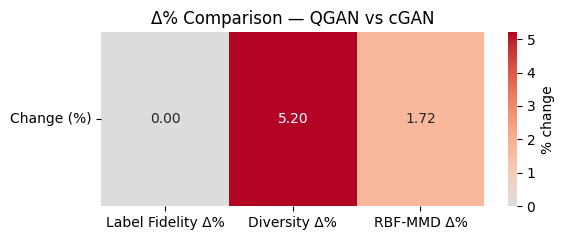

📁 Saved: gan_metrics_delta.csv & gan_metrics_heatmap.png


In [44]:
# ============================================================
# 📈 Extended Comparison — Δ% Improvement + Heatmap Visualization
# ============================================================

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load saved results
df = pd.read_csv("gan_metrics_summary.csv")

# Compute percentage Δ for QGAN vs cGAN
base = df.loc[df['name'] == 'Classical cGAN (EMA)'].iloc[0]
qgan = df.loc[df['name'] == 'Quantum-Hybrid GAN'].iloc[0]

delta = {
    "Label Fidelity Δ%": ((qgan['fidelity'] - base['fidelity']) / base['fidelity']) * 100,
    "Diversity Δ%": ((qgan['diversity'] - base['diversity']) / base['diversity']) * 100,
    "RBF-MMD Δ%": ((qgan['mmd'] - base['mmd']) / base['mmd']) * 100,
}

delta_df = pd.DataFrame([delta]).T.rename(columns={0: "Change (%)"})
print("📊 Relative change (QGAN vs cGAN):\n", delta_df.round(2))

# Save to CSV (append to summary)
delta_df.to_csv("gan_metrics_delta.csv")

# --- Heatmap visualization ---
fig, ax = plt.subplots(figsize=(6, 2.5))
sns.heatmap(
    delta_df.T,
    annot=True,
    cmap="coolwarm",
    center=0,
    fmt=".2f",
    cbar_kws={'label': '% change'},
    ax=ax
)
plt.title("Δ% Comparison — QGAN vs cGAN")
plt.yticks(rotation=0)
plt.tight_layout()
plt.savefig("gan_metrics_heatmap.png", dpi=300)
plt.show()

print("📁 Saved: gan_metrics_delta.csv & gan_metrics_heatmap.png")


/Users/ananyakulkarni/Desktop/Quantum Defect Detection/venv-qdefect/lib/python3.11/site-packages/torch/nn/modules/module.py:1864: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


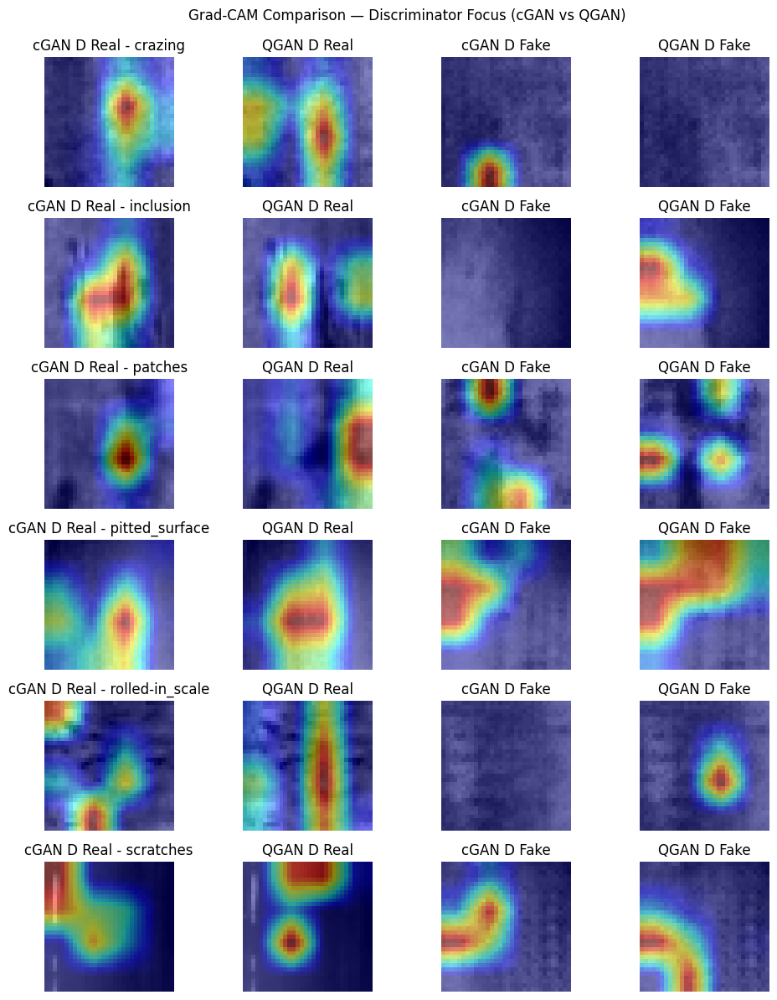

In [45]:
# ============================================================
# 🔍 Grad-CAM Visualization for Discriminators (cGAN vs QGAN)
# ============================================================
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision import transforms
import numpy as np
from PIL import Image

# ensure models exist
assert 'D' in globals() and 'D_qgan' in globals(), "Run training cells first."

# -------- helper to get gradients and activations --------
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model.eval()
        self.gradients = None
        self.activations = None
        self.hook_layers(target_layer)
        
    def hook_layers(self, layer_name):
        def forward_hook(module, inp, out):
            self.activations = out.detach()
        def backward_hook(module, grad_in, grad_out):
            self.gradients = grad_out[0].detach()
        layer = dict(self.model.named_modules())[layer_name]
        layer.register_forward_hook(forward_hook)
        layer.register_backward_hook(backward_hook)

    def generate(self, x, y):
        self.model.zero_grad()
        out = self.model(x, y)
        out.mean().backward()
        grad = self.gradients
        act = self.activations
        weights = grad.mean(dim=(2,3), keepdim=True)
        cam = (weights * act).sum(dim=1, keepdim=True)
        cam = F.relu(cam)
        cam = F.interpolate(cam, size=x.shape[2:], mode='bilinear', align_corners=False)
        cam = cam - cam.min()
        cam = cam / (cam.max() + 1e-8)
        return cam.squeeze().cpu().numpy()

# -------- select a few samples (real + fake per class) --------
@torch.no_grad()
def get_real_fake_per_class(G, dl, n_classes=6, n_samples=1):
    samples = []
    for c in range(n_classes):
        for xb, yb in dl:
            mask = (yb == c)
            if mask.any():
                x_real = xb[mask][0:1].to(device)
                z = torch.randn(1, Z_DIM, device=device)
                x_fake = G(z, torch.tensor([c], device=device))
                samples.append((c, x_real, x_fake))
                break
    return samples

samples = get_real_fake_per_class(G_ema, dl_gan, NCLS)

# -------- visualize Grad-CAM overlays --------
def plot_gradcam_comparison(samples, D1, D2, name1="cGAN D", name2="QGAN D"):
    cam1 = GradCAM(D1, target_layer="features.6")  # adjust layer index if needed
    cam2 = GradCAM(D2, target_layer="features.6")

    fig, axes = plt.subplots(len(samples), 4, figsize=(10, 2*len(samples)))
    for i, (cls, xr, xf) in enumerate(samples):
        cam_real_1 = cam1.generate(xr, torch.tensor([cls], device=device))
        cam_real_2 = cam2.generate(xr, torch.tensor([cls], device=device))
        cam_fake_1 = cam1.generate(xf, torch.tensor([cls], device=device))
        cam_fake_2 = cam2.generate(xf, torch.tensor([cls], device=device))

        def overlay(im, cam):
            im = (im[0,0].detach().cpu().numpy() + 1)/2
            heat = plt.cm.jet(cam)[..., :3]
            overlay = 0.5*heat + 0.5*np.repeat(im[...,None],3,axis=2)
            return np.clip(overlay,0,1)

        axes[i,0].imshow(overlay(xr, cam_real_1)); axes[i,0].set_title(f"{name1} Real - {class_names[cls]}")
        axes[i,1].imshow(overlay(xr, cam_real_2)); axes[i,1].set_title(f"{name2} Real")
        axes[i,2].imshow(overlay(xf, cam_fake_1)); axes[i,2].set_title(f"{name1} Fake")
        axes[i,3].imshow(overlay(xf, cam_fake_2)); axes[i,3].set_title(f"{name2} Fake")
        for a in axes[i,:]: a.axis("off")

    plt.suptitle("Grad-CAM Comparison — Discriminator Focus (cGAN vs QGAN)", y=0.99)
    plt.tight_layout()
    plt.show()

plot_gradcam_comparison(samples, D, D_qgan)


In [13]:
# Shared metrics for any generator: label fidelity (via classifier), diversity, RBF-MMD
import numpy as np, torch

@torch.inference_mode()
def classifier_fidelity(model_cls32, x01, y, device=device):
    """x01 in [0,1], shape (N,1,32,32); y: Long (N,)"""
    logits = model_cls32(x01.to(device))
    preds = logits.argmax(1).cpu().numpy()
    y = y.cpu().numpy()
    return (preds == y).mean()

def diversity_pairwise_l2(x01, max_samp=512, seed=0):
    """mean pairwise L2 in pixel space as a simple diversity proxy."""
    x = x01.detach().cpu().numpy().reshape(len(x01), -1)
    rng = np.random.default_rng(seed)
    idx = rng.choice(len(x), size=min(max_samp, len(x)), replace=False)
    S = x[idx]
    D = np.sqrt(((S[:,None,:]-S[None,:,:])**2).sum(2))
    iu = np.triu_indices(len(S), k=1)
    return float(D[iu].mean())

@torch.inference_mode()
def rbf_mmd(x01, y01, num_subsample=1024, seed=0):
    """RBF-MMD^2 on pixel vectors (x01,y01 in [0,1]). Lower is closer."""
    x = x01.reshape(len(x01), -1).float().cpu()
    y = y01.reshape(len(y01), -1).float().cpu()
    n = min(num_subsample, len(x), len(y))
    g = torch.Generator().manual_seed(seed)
    x = x[torch.randperm(len(x), generator=g)[:n]]
    y = y[torch.randperm(len(y), generator=g)[:n]]
    z = torch.cat([x,y],0)
    d = torch.cdist(z,z,p=2)
    sigma2 = torch.median(d)**2 + 1e-6
    gamma = 1.0 / (2.0*sigma2)
    def k(a,b):
        dd = torch.cdist(a,b,p=2)
        return torch.exp(-gamma*dd**2)
    k_xx, k_yy, k_xy = k(x,x), k(y,y), k(x,y)
    m = n
    mmd = (k_xx.sum()-torch.diag(k_xx).sum())/(m*(m-1)+1e-9) \
        + (k_yy.sum()-torch.diag(k_yy).sum())/(m*(m-1)+1e-9) \
        - 2.0*k_xy.mean()
    return float(mmd.item())


In [15]:
# Classical conditional GAN @32×32 (grayscale), timing + metrics
# --- add near the start of each training script ---
hist = {"ep": [], "D": [], "G": []}
import time, torch, torch.nn as nn, torch.optim as optim
from torch.utils.data import DataLoader
import torchvision.transforms as T
from torchvision.datasets import ImageFolder
from PIL import Image, ImageOps

# data for GAN in [-1,1]
to_tensor = T.ToTensor()
train_tf_gan = T.Compose([
    T.Grayscale(1), T.Resize((32, 32)),
    T.Lambda(lambda im: ImageOps.autocontrast(im)),
    T.Lambda(lambda im: to_tensor(im)*2.0 - 1.0),
])
ds_gan = ImageFolder(TRAIN_IMG_DIR, transform=train_tf_gan)
dl_gan = DataLoader(ds_gan, batch_size=64, shuffle=True, drop_last=True, num_workers=0)
NCLS, Z_DIM = len(class_names), 64

# models
def SN(m): return nn.utils.spectral_norm(m)

class Gen(nn.Module):
    def __init__(self, z_dim=64, n_classes=6, emb_dim=32, width=64):
        super().__init__()
        self.embed = nn.Embedding(n_classes, emb_dim)
        in_dim = z_dim + emb_dim
        self.net = nn.Sequential(
            nn.Linear(in_dim, 4*4*width*4), nn.BatchNorm1d(4*4*width*4), nn.ReLU(True),
            nn.Unflatten(1, (width*4, 4, 4)),
            nn.ConvTranspose2d(width*4, width*2, 4, 2, 1), nn.BatchNorm2d(width*2), nn.ReLU(True),
            nn.ConvTranspose2d(width*2, width,   4, 2, 1), nn.BatchNorm2d(width),   nn.ReLU(True),
            nn.ConvTranspose2d(width,   1,        4, 2, 1), nn.Tanh(),
        )
    def forward(self, z, y):
        yemb = self.embed(y)
        x = torch.cat([z, yemb], dim=1)
        return self.net(x)

class ProjDisc(nn.Module):
    def __init__(self, n_classes=6, width=64):
        super().__init__()
        c = width
        self.f = nn.Sequential(
            SN(nn.Conv2d(1,   c,  3, 2, 1)), nn.LeakyReLU(0.2, True),
            SN(nn.Conv2d(c,   c*2,3, 2, 1)), nn.LeakyReLU(0.2, True),
            SN(nn.Conv2d(c*2, c*4,3, 2, 1)), nn.LeakyReLU(0.2, True),
            SN(nn.Conv2d(c*4, c*4,3, 1, 1)), nn.LeakyReLU(0.2, True),
        )
        self.lin   = SN(nn.Linear(c*4, 1))
        self.embed = nn.Embedding(n_classes, c*4)
    def forward(self, x, y):
        h = self.f(x).sum(dim=(2,3))
        out = self.lin(h).squeeze(1)
        proj = (self.embed(y) * h).sum(dim=1)
        return out + proj

G_cgan = Gen(z_dim=Z_DIM, n_classes=NCLS, emb_dim=32, width=64).to(device)
D_cgan = ProjDisc(n_classes=NCLS, width=64).to(device)

# hinge losses + TTUR
def d_hinge_loss(r, f): return (nn.ReLU()(1.0 - r)).mean() + (nn.ReLU()(1.0 + f)).mean()
def g_hinge_loss(f):     return -f.mean()

optD = optim.Adam(D_cgan.parameters(), lr=2e-4, betas=(0.0, 0.9))
optG = optim.Adam(G_cgan.parameters(), lr=1e-4, betas=(0.0, 0.9))

# training
EPOCHS = 100
def _sync():
    if device == "cuda": torch.cuda.synchronize()
    elif device == "mps": torch.mps.synchronize()

epoch_secs_cgan = []
for ep in range(1, EPOCHS+1):
    t0 = time.perf_counter()
    for xb, yb in dl_gan:
        xb, yb = xb.to(device), yb.to(device)
        b = xb.size(0)

        # D
        z = torch.randn(b, Z_DIM, device=device)
        with torch.no_grad(): fake = G_cgan(z, yb)
        optD.zero_grad()
        d_real = D_cgan(xb, yb); d_fake = D_cgan(fake, yb)
        d_loss = d_hinge_loss(d_real, d_fake); d_loss.backward(); optD.step()

        # G
        z = torch.randn(b, Z_DIM, device=device); y_fake = yb
        optG.zero_grad()
        g_loss = g_hinge_loss(D_cgan(G_cgan(z, y_fake), y_fake)); g_loss.backward(); optG.step()

    _sync(); epoch_secs_cgan.append(time.perf_counter() - t0)
    print(f"cGAN Epoch {ep}/{EPOCHS} — D {d_loss.item():.3f} | G {g_loss.item():.3f} | {epoch_secs_cgan[-1]:.2f}s")

# quick metrics on generated samples
@torch.inference_mode()
def sample_per_class(G, n_per=128):
    xs, ys = [], []
    for cls in range(NCLS):
        y = torch.full((n_per,), cls, dtype=torch.long, device=device)
        z = torch.randn(n_per, Z_DIM, device=device)
        x = (G(z, y).clamp(-1,1) + 1)/2  # [0,1]
        xs.append(x); ys.append(y)
    return torch.cat(xs,0), torch.cat(ys,0)

fake01_cgan, y_cgan = sample_per_class(G_cgan, n_per=128)
# build a real reference set from validation (match count)
real_paths = [p for p,_ in ds_va.samples]
rng = np.random.default_rng(0)
sel = rng.choice(len(real_paths), size=len(fake01_cgan), replace=True)
real01 = torch.stack([val_tf(Image.open(real_paths[i]).convert("L")) for i in sel])

fidelity_cgan = classifier_fidelity(model_cls32, fake01_cgan, y_cgan)
diversity_cgan = diversity_pairwise_l2(fake01_cgan)
mmd_cgan = rbf_mmd(fake01_cgan, real01)

print(f"✅ cGAN label fidelity (cls acc on fakes): {fidelity_cgan:.3f}")
print(f"✅ cGAN diversity (mean pairwise L2):     {diversity_cgan:.4f}")
print(f"✅ cGAN RBF-MMD (↓ better):               {mmd_cgan:.5f}")
print(f"⏱️ cGAN median epoch time: {np.median(epoch_secs_cgan):.2f}s")

hist["ep"].append(ep)
hist["D"].append(float(d_loss.item()))
hist["G"].append(float(g_loss.item()))


cGAN Epoch 1/100 — D 0.000 | G 4.822 | 0.92s
cGAN Epoch 2/100 — D 0.000 | G 4.005 | 0.69s
cGAN Epoch 3/100 — D 0.000 | G 7.184 | 0.69s
cGAN Epoch 4/100 — D 0.000 | G 5.100 | 0.69s
cGAN Epoch 5/100 — D 0.116 | G 7.766 | 0.69s
cGAN Epoch 6/100 — D 0.026 | G 6.416 | 0.70s
cGAN Epoch 7/100 — D 0.429 | G 20.750 | 0.70s
cGAN Epoch 8/100 — D 0.041 | G 4.306 | 0.70s
cGAN Epoch 9/100 — D 3.456 | G 11.750 | 0.69s
cGAN Epoch 10/100 — D 0.000 | G 4.457 | 0.79s
cGAN Epoch 11/100 — D 0.000 | G 7.222 | 0.69s
cGAN Epoch 12/100 — D 0.005 | G 5.220 | 0.69s
cGAN Epoch 13/100 — D 0.000 | G 6.197 | 0.83s
cGAN Epoch 14/100 — D 0.115 | G 10.201 | 0.70s
cGAN Epoch 15/100 — D 0.019 | G 3.857 | 0.81s
cGAN Epoch 16/100 — D 0.097 | G 4.531 | 0.69s
cGAN Epoch 17/100 — D 0.021 | G 2.733 | 0.69s
cGAN Epoch 18/100 — D 0.849 | G 2.100 | 0.69s
cGAN Epoch 19/100 — D 1.274 | G 1.115 | 0.69s
cGAN Epoch 20/100 — D 1.002 | G 0.995 | 0.87s
cGAN Epoch 21/100 — D 1.053 | G 2.965 | 0.71s
cGAN Epoch 22/100 — D 1.222 | G 2.374 | 

In [ ]:
import time, numpy as np, torch, torch.nn as nn, torch.optim as optim

def train_cgan(G, D, dl, epochs=30, z_dim=64, device="cpu"):
    optD = optim.Adam(D.parameters(), lr=2e-4, betas=(0.0, 0.9))
    optG = optim.Adam(G.parameters(), lr=1e-4, betas=(0.0, 0.9))
    def d_hinge(r,f): return (nn.ReLU()(1. - r)).mean() + (nn.ReLU()(1. + f)).mean()
    def g_hinge(f):   return -f.mean()
    hist = {"ep":[], "D":[], "G":[], "sec":[]}
    for ep in range(1, epochs+1):
        t0 = time.perf_counter()
        for xb, yb in dl:
            xb, yb = xb.to(device), yb.to(device)
            b = xb.size(0)
            # D
            z = torch.randn(b, z_dim, device=device)
            with torch.no_grad(): xf = G(z, yb)
            optD.zero_grad(); d_loss = d_hinge(D(xb, yb), D(xf, yb)); d_loss.backward(); optD.step()
            # G
            z = torch.randn(b, z_dim, device=device)
            optG.zero_grad(); g_loss = g_hinge(D(G(z, yb), yb)); g_loss.backward(); optG.step()
        if device == "cuda": torch.cuda.synchronize()
        elif device == "mps": torch.mps.synchronize()
        hist["ep"].append(ep); hist["D"].append(float(d_loss.item()))
        hist["G"].append(float(g_loss.item())); hist["sec"].append(time.perf_counter()-t0)
        print(f"cGAN ep {ep:02d}/{epochs} — D {hist['D'][-1]:.3f} | G {hist['G'][-1]:.3f} | {hist['sec'][-1]:.2f}s")
    print("⏱️ cGAN median epoch sec:", np.median(hist["sec"]).round(3))
    return hist

def train_qgan(Gq, Dq, dl, epochs=30, z_dim=64, device="cpu"):
    optD = optim.Adam(Dq.parameters(), lr=2e-4, betas=(0.0, 0.9))
    optG = optim.Adam(Gq.parameters(), lr=1e-4, betas=(0.0, 0.9))
    def d_hinge(r,f): return (nn.ReLU()(1. - r)).mean() + (nn.ReLU()(1. + f)).mean()
    def g_hinge(f):   return -f.mean()
    hist = {"ep":[], "D":[], "G":[], "sec":[]}
    for ep in range(1, epochs+1):
        t0 = time.perf_counter()
        for xb, yb in dl:
            xb, yb = xb.to(device), yb.to(device)
            b = xb.size(0)
            # D
            z = torch.randn(b, z_dim, device=device)
            with torch.no_grad(): xf = Gq(z, yb).detach()
            optD.zero_grad(); d_loss = d_hinge(Dq(xb, yb), Dq(xf, yb)); d_loss.backward(); optD.step()
            # G
            z = torch.randn(b, z_dim, device=device)
            optG.zero_grad(); g_loss = g_hinge(Dq(Gq(z, yb), yb)); g_loss.backward(); optG.step()
        if device == "cuda": torch.cuda.synchronize()
        elif device == "mps": torch.mps.synchronize()
        hist["ep"].append(ep); hist["D"].append(float(d_loss.item()))
        hist["G"].append(float(g_loss.item())); hist["sec"].append(time.perf_counter()-t0)
        print(f"QGAN ep {ep:02d}/{epochs} — D {hist['D'][-1]:.3f} | G {hist['G'][-1]:.3f} | {hist['sec'][-1]:.2f}s")
    print("⏱️ QGAN median epoch sec:", np.median(hist["sec"]).round(3))
    return hist

# --- Train both (uses your existing dl_gan, NCLS, Z_DIM, device) ---
G_cgan = Gen(z_dim=Z_DIM, n_classes=NCLS, emb_dim=32, width=64).to(device)
D_cgan = ProjDisc(n_classes=NCLS, width=64).to(device)
hist_cgan = train_cgan(G_cgan, D_cgan, dl_gan, epochs=30, z_dim=Z_DIM, device=device)

G_qgan = QHybridGen(z_dim=Z_DIM, n_classes=NCLS, emb_dim=16, device=device)   # NOTE: no .to(device)
D_qgan = ProjDisc(n_classes=NCLS, width=64).to(device)
hist_qgan = train_qgan(G_qgan, D_qgan, dl_gan, epochs=30, z_dim=Z_DIM, device=device)


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def smooth(v, k=7):
    k = max(1,int(k)); pad = k//2
    vv = np.pad(np.array(v,float), (pad,pad), mode="edge")
    return np.convolve(vv, np.ones(k)/k, mode="valid")

plt.figure(figsize=(8,5))
plt.plot(hist_cgan["ep"], smooth(hist_cgan["D"]), label="Disc — baseline")
plt.plot(hist_cgan["ep"], smooth(hist_cgan["G"]), "--", label="Gen — baseline")
plt.plot(hist_qgan["ep"], smooth(hist_qgan["D"]), label="Disc — quantum")
plt.plot(hist_qgan["ep"], smooth(hist_qgan["G"]), "--", label="Gen — quantum")
plt.xlabel("Epoch"); plt.ylabel("Hinge loss"); plt.title("Training loss (smoothed)")
plt.grid(alpha=0.3); plt.legend(); plt.tight_layout(); plt.show()

print("Median epoch seconds — cGAN:", np.median(hist_cgan["sec"]).round(3),
      "| QGAN:", np.median(hist_qgan["sec"]).round(3))


In [ ]:
@torch.inference_mode()
def gen_throughput(G, z_dim, device, batch=512, repeats=50):
    z = torch.randn(batch, z_dim, device=device)
    y = torch.randint(0, NCLS, (batch,), device=device)
    # warmup
    for _ in range(5): _ = G(z, y)
    if device == "cuda": torch.cuda.synchronize()
    elif device == "mps": torch.mps.synchronize()
    t0 = time.perf_counter()
    for _ in range(repeats): _ = G(z, y)
    if device == "cuda": torch.cuda.synchronize()
    elif device == "mps": torch.mps.synchronize()
    dt = time.perf_counter() - t0
    return (batch*repeats)/max(dt,1e-9)

ips_cgan = gen_throughput(G_cgan, Z_DIM, device)
ips_qgan = gen_throughput(G_qgan, Z_DIM, device)
print(f"⚡ Generator throughput — cGAN: {ips_cgan:.1f} imgs/sec | QGAN: {ips_qgan:.1f} imgs/sec")


In [13]:
import torch, torch.nn as nn
import pennylane as qml
from pennylane.qnn import TorchLayer

n_qubits, n_layers = 6, 2
dev_q = qml.device("default.qubit", wires=n_qubits)

@qml.qnode(dev_q, interface="torch")
def qnode(inputs, weights):
    qml.AngleEmbedding(inputs, wires=range(n_qubits))
    qml.templates.StronglyEntanglingLayers(weights, wires=range(n_qubits))
    return [qml.expval(qml.PauliZ(i)) for i in range(n_qubits)]

weight_shapes = {"weights": (n_layers, n_qubits, 3)}

class QHybridGen(nn.Module):
    """
    Conditional QGAN generator:
      [z | y_emb] -> pre_q(CPU) -> quantum(CPU) -> post MLP(device) -> 1x32x32 in [-1,1]
    """
    def __init__(self, z_dim=64, n_classes=6, emb_dim=16, device="cpu"):
        super().__init__()
        self.device_post = device  # where the post-MLP runs
        # CPU-side: embedding + pre-quantum + quantum
        self.embed = nn.Embedding(n_classes, emb_dim).to("cpu")
        self.pre_q = nn.Linear(z_dim + emb_dim, n_qubits).to("cpu")
        self.q     = TorchLayer(qnode, weight_shapes).to("cpu")
        # Device-side: classical decoder
        self.post  = nn.Sequential(
            nn.Linear(n_qubits, 256), nn.LeakyReLU(0.2, True),
            nn.Linear(256, 512),     nn.LeakyReLU(0.2, True),
            nn.Linear(512, 1024),    nn.LeakyReLU(0.2, True),
            nn.Linear(1024, 32*32),  nn.Tanh(),
        ).to(self.device_post)

    def forward(self, z, y):
        # Move inputs to CPU for embedding + quantum
        z_cpu = z.detach().to("cpu")
        y_cpu = y.detach().to("cpu")
        yemb  = self.embed(y_cpu)
        h     = self.pre_q(torch.cat([z_cpu, yemb], dim=1))
        h     = self.q(h)  # CPU tensor
        # Back to device for classical decoder
        h_dev = torch.as_tensor(h, device=self.device_post)
        out   = self.post(h_dev)
        return out.view(-1, 1, 32, 32)


In [14]:
# QGAN-Hybrid generator (conditional) — quantum path on CPU; post-MLP on device
hist = {"ep": [], "D": [], "G": []}

import time, torch, torch.nn as nn
import pennylane as qml
from pennylane.qnn import TorchLayer

n_qubits, n_layers = 6, 2
dev_q = qml.device("default.qubit", wires=n_qubits)

@qml.qnode(dev_q, interface="torch")
def qnode(inputs, weights):
    qml.AngleEmbedding(inputs, wires=range(n_qubits))
    qml.templates.StronglyEntanglingLayers(weights, wires=range(n_qubits))
    return [qml.expval(qml.PauliZ(i)) for i in range(n_qubits)]

weight_shapes = {"weights": (n_layers, n_qubits, 3)}

class QHybridGen(nn.Module):
    """
    Conditional: concat z + class embedding -> pre_q (CPU) -> quantum (CPU) -> post MLP (device).
    """
    def __init__(self, z_dim=64, n_classes=6, emb_dim=16):
        super().__init__()
        self.embed = nn.Embedding(n_classes, emb_dim)
        self.pre_q = nn.Linear(z_dim + emb_dim, n_qubits).to("cpu")
        self.q     = TorchLayer(qnode, weight_shapes).to("cpu")
        self.post  = nn.Sequential(
            nn.Linear(n_qubits, 256), nn.LeakyReLU(0.2, True),
            nn.Linear(256, 512),     nn.LeakyReLU(0.2, True),
            nn.Linear(512, 1024),    nn.LeakyReLU(0.2, True),
            nn.Linear(1024, 32*32),  nn.Tanh(),  # [-1,1]
        ).to(device)
        self.z_dim = z_dim
    def forward(self, z, y):
        yemb = self.embed(y)
        zc = torch.cat([z, yemb], dim=1).to("cpu")
        h = self.pre_q(zc)
        h = self.q(h)
        h = torch.as_tensor(h, device=device, dtype=torch.float32)
        out = self.post(h)
        return out.view(-1,1,32,32)

G_qgan = QHybridGen(z_dim=Z_DIM, n_classes=NCLS, emb_dim=16)  # DO NOT .to(device); quantum lives on CPU

# discriminator can be shared with cGAN for fairness
D_qgan = ProjDisc(n_classes=NCLS, width=64).to(device)

optDq = optim.Adam(D_qgan.parameters(), lr=2e-4, betas=(0.0, 0.9))
optGq = optim.Adam(G_qgan.parameters(), lr=1e-4, betas=(0.0, 0.9))

EPOCHS_Q = 30
epoch_secs_qgan = []

def _sync():
    if device == "cuda": torch.cuda.synchronize()
    elif device == "mps": torch.mps.synchronize()

for ep in range(1, EPOCHS_Q+1):
    t0 = time.perf_counter()
    for xb, yb in dl_gan:
        xb, yb = xb.to(device), yb.to(device)
        b = xb.size(0)

        # D step
        z = torch.randn(b, Z_DIM, device=device)
        with torch.no_grad(): fake = G_qgan(z, yb).detach()
        optDq.zero_grad()
        d_real = D_qgan(xb, yb); d_fake = D_qgan(fake, yb)
        d_loss = d_hinge_loss(d_real, d_fake); d_loss.backward(); optDq.step()

        # G step
        z = torch.randn(b, Z_DIM, device=device)
        optGq.zero_grad()
        g_loss = g_hinge_loss(D_qgan(G_qgan(z, yb), yb)); g_loss.backward(); optGq.step()

    _sync(); epoch_secs_qgan.append(time.perf_counter() - t0)
    print(f"QGAN Epoch {ep}/{EPOCHS_Q} — D {d_loss.item():.3f} | G {g_loss.item():.3f} | {epoch_secs_qgan[-1]:.2f}s")

@torch.inference_mode()
def sample_per_class_q(G, n_per=128):
    xs, ys = [], []
    for cls in range(NCLS):
        y = torch.full((n_per,), cls, dtype=torch.long, device=device)
        z = torch.randn(n_per, Z_DIM, device=device)
        x = (G(z, y).clamp(-1,1) + 1)/2
        xs.append(x); ys.append(y)
    return torch.cat(xs,0), torch.cat(ys,0)

fake01_qgan, y_qgan = sample_per_class_q(G_qgan, n_per=128)
# same real ref as before
sel = np.random.default_rng(0).choice(len(real_paths), size=len(fake01_qgan), replace=True)
real01_q = torch.stack([val_tf(Image.open(real_paths[i]).convert("L")) for i in sel])

fidelity_qgan = classifier_fidelity(model_cls32, fake01_qgan, y_qgan)
diversity_qgan = diversity_pairwise_l2(fake01_qgan)
mmd_qgan = rbf_mmd(fake01_qgan, real01_q)

print(f"✅ QGAN label fidelity: {fidelity_qgan:.3f}")
print(f"✅ QGAN diversity:     {diversity_qgan:.4f}")
print(f"✅ QGAN RBF-MMD:        {mmd_qgan:.5f}")
print(f"⏱️ QGAN median epoch time: {np.median(epoch_secs_qgan):.2f}s")

hist["ep"].append(ep)
hist["D"].append(float(d_loss.item()))
hist["G"].append(float(g_loss.item()))



RuntimeError: Placeholder storage has not been allocated on MPS device!

In [25]:
# Generator throughput (imgs/sec): classical vs quantum-hybrid
import time

@torch.inference_mode()
def gen_throughput(G, cond=True, batch=256, repeats=20):
    if cond:
        yb = torch.randint(0, NCLS, (batch,), device=device)
    z  = torch.randn(batch, Z_DIM, device=device)
    # warmup
    _ = G(z, yb) if cond else G(z)
    if device == "cuda": torch.cuda.synchronize()
    elif device == "mps": torch.mps.synchronize()
    t0 = time.perf_counter()
    for _ in range(repeats):
        _ = G(z, yb) if cond else G(z)
    if device == "cuda": torch.cuda.synchronize()
    elif device == "mps": torch.mps.synchronize()
    dt = time.perf_counter() - t0
    return (batch*repeats)/max(dt,1e-9)

ips_cgan = gen_throughput(G_cgan, cond=True)
ips_qgan = gen_throughput(G_qgan, cond=True)

print(f"⚡ cGAN generator throughput:  {ips_cgan:.1f} imgs/sec")
print(f"⚡ QGAN generator throughput:  {ips_qgan:.1f} imgs/sec")


⚡ cGAN generator throughput:  12080.6 imgs/sec
⚡ QGAN generator throughput:  36557.2 imgs/sec


In [26]:
import pandas as pd, numpy as np

rows = [
    {
        "model": "Classifier (baseline)",
        "val_acc": float(max(hist['val_acc'])) if 'hist' in globals() else np.nan,
        "epoch_time_s (median)": float(np.median(hist['epoch_sec'])) if 'hist' in globals() else np.nan,
        "infer_imgs_per_sec": float(cls_ips) if 'cls_ips' in globals() else np.nan,
        "fidelity_on_fakes": None, "diversity": None, "rbf_mmd": None,
    },
    {
        "model": "cGAN (classical)",
        "val_acc": None,
        "epoch_time_s (median)": float(np.median(epoch_secs_cgan)),
        "infer_imgs_per_sec": float(ips_cgan),
        "fidelity_on_fakes": float(fidelity_cgan),
        "diversity": float(diversity_cgan),
        "rbf_mmd": float(mmd_cgan),
    },
    {
        "model": "QGAN-Hybrid",
        "val_acc": None,
        "epoch_time_s (median)": float(np.median(epoch_secs_qgan)),
        "infer_imgs_per_sec": float(ips_qgan),
        "fidelity_on_fakes": float(fidelity_qgan),
        "diversity": float(diversity_qgan),
        "rbf_mmd": float(mmd_qgan),
    },
]
df = pd.DataFrame(rows)
display(df)


KeyError: 'val_acc'

In [23]:
import matplotlib.pyplot as plt

def plot_gan_losses(hist_cgan, hist_qgan, title="Training loss"):
    plt.figure(figsize=(8,5))
    # Discriminator
    plt.plot(hist_cgan["ep"], hist_cgan["D"], label="D (baseline cGAN)", linewidth=2)
    plt.plot(hist_qgan["ep"], hist_qgan["D"], label="D (QGAN-hybrid)", linewidth=2)
    # Generator
    plt.plot(hist_cgan["ep"], hist_cgan["G"], '--', label="G (baseline cGAN)", linewidth=2)
    plt.plot(hist_qgan["ep"], hist_qgan["G"], '--', label="G (QGAN-hybrid)", linewidth=2)
    plt.xlabel("Epoch"); plt.ylabel("Hinge loss")
    plt.title(title); plt.legend(); plt.grid(True, alpha=0.3)
    plt.tight_layout(); plt.show()

# Example usage after both runs:
plot_gan_losses(hist_cgan, hist_qgan, title="cGAN vs QGAN — hinge losses")


NameError: name 'hist_cgan' is not defined

In [6]:
# ==== Cell 8: Predict one image + small grid preview ====

import torch, numpy as np, matplotlib.pyplot as plt
from PIL import Image

device = "cuda" if torch.cuda.is_available() else "cpu"

# if you restarted, reload:
# model, val_tf, class_names = load_model_for_inference("runs/neu_32fix_YYYYMMDD_HHMMSS")
model = model.to(device)

@torch.inference_mode()
def predict_image(img_path, model, tf, classes, topk=3, device=device):
    pil = Image.open(img_path).convert("L")
    x = tf(pil).unsqueeze(0).to(device)
    logits = model(x)
    probs = torch.softmax(logits, dim=1).flatten().cpu().numpy()
    top_idx = probs.argsort()[::-1][:topk]
    return [(classes[i], float(probs[i])) for i in top_idx], pil, x.squeeze(0).cpu()

def show_pred(img_path):
    top3, pil, x = predict_image(img_path, model, val_tf, class_names, topk=3)
    arr = x.permute(1,2,0).numpy()
    arr = (arr - arr.min())/(arr.max()-arr.min()+1e-8)
    plt.figure(figsize=(6,3))
    plt.subplot(1,2,1); plt.imshow(pil, cmap="gray"); plt.title("Original"); plt.axis("off")
    plt.subplot(1,2,2); plt.imshow(arr, cmap="gray"); plt.title("Transformed 32×32"); plt.axis("off")
    plt.suptitle("Top-3: " + ", ".join([f"{l} {p:.2f}" for l,p in top3]))
    plt.tight_layout(); plt.show()

@torch.inference_mode()
def preview_grid(ds, tf, ncols=6):
    chosen = {}
    for path, y in ds.samples:
        cls = class_names[y]
        if cls not in chosen:
            chosen[cls] = (path, y)
        if len(chosen) == len(class_names): break

    paths = [chosen[c][0] for c in class_names]
    fig, axes = plt.subplots(2, len(class_names), figsize=(3*len(class_names), 6))
    for i, (cls, p) in enumerate(zip(class_names, paths)):
        top3, pil, x = predict_image(p, model, tf, class_names)
        axes[0,i].imshow(pil, cmap="gray"); axes[0,i].set_title(cls); axes[0,i].axis("off")
        arr = x.permute(1,2,0).numpy(); arr = (arr-arr.min())/(arr.max()-arr.min()+1e-8)
        axes[1,i].imshow(arr, cmap="gray")
        axes[1,i].set_title(f"pred→{top3[0][0]} ({top3[0][1]:.2f})")
        axes[1,i].axis("off")
    plt.suptitle("One per class — predictions @ 32×32 fixed", y=1.02)
    plt.tight_layout(); plt.show()


# Usage:
# from torchvision.datasets import ImageFolder
# ds_val_preview = ImageFolder(VAL_IMG_DIR)  # plain listing
# preview_grid(ds_val_preview, val_tf)


NameError: name 'model' is not defined

In [16]:
# ==== Cell 9: Re-train 32×32 fixed with WIDTH=24 (quick) ====
# reuses the same SimpleCNN32, train_tf/val_tf from the fix cell

import torch, torch.nn as nn, torch.optim as optim
from torch.utils.data import DataLoader

WIDTH = 24
model = SimpleCNN32(in_ch=1, num_classes=len(class_names), width=WIDTH, p_drop=0.2).to(device)
opt   = optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-4)
lossf = nn.CrossEntropyLoss(label_smoothing=0.1)

def acc(logits,y): return (logits.argmax(1)==y).float().mean().item()
@torch.no_grad()
def eval_epoch(m, loader):
    m.eval(); tl, ta, n = 0.0, 0.0, 0
    for xb,yb in loader:
        xb,yb = xb.to(device), yb.to(device)
        lo = m(xb); ls = lossf(lo,yb)
        bs = xb.size(0); n+=bs
        tl += ls.item()*bs; ta += acc(lo,yb)*bs
    return tl/n, ta/n

train_loader = DataLoader(ds_tr, batch_size=32, shuffle=True,  num_workers=0)
val_loader   = DataLoader(ds_va, batch_size=32, shuffle=False, num_workers=0)

best, patience = -1, 3
for ep in range(1,13):
    model.train()
    for xb,yb in train_loader:
        xb,yb = xb.to(device), yb.to(device)
        opt.zero_grad(); lo = model(xb); ls = lossf(lo,yb); ls.backward(); opt.step()
    vl, va = eval_epoch(model, val_loader)
    print(f"ep{ep}: val acc {va:.3f}")
    if va > best + 1e-4:
        best, patience = va, 3
        best_state = {k:v.cpu().clone() for k,v in model.state_dict().items()}
    else:
        patience -= 1
        if patience<=0: break
if 'best_state' in globals():
    model.load_state_dict({k:v.to(device) for k,v in best_state.items()})
print("Best val acc (WIDTH=24):", best)


ep1: val acc 0.558
ep2: val acc 0.603
ep3: val acc 0.731
ep4: val acc 0.742
ep5: val acc 0.611
ep6: val acc 0.856
ep7: val acc 0.831
ep8: val acc 0.833
ep9: val acc 0.872
ep10: val acc 0.833
ep11: val acc 0.764
ep12: val acc 0.892
Best val acc (WIDTH=24): 0.8916666666666667


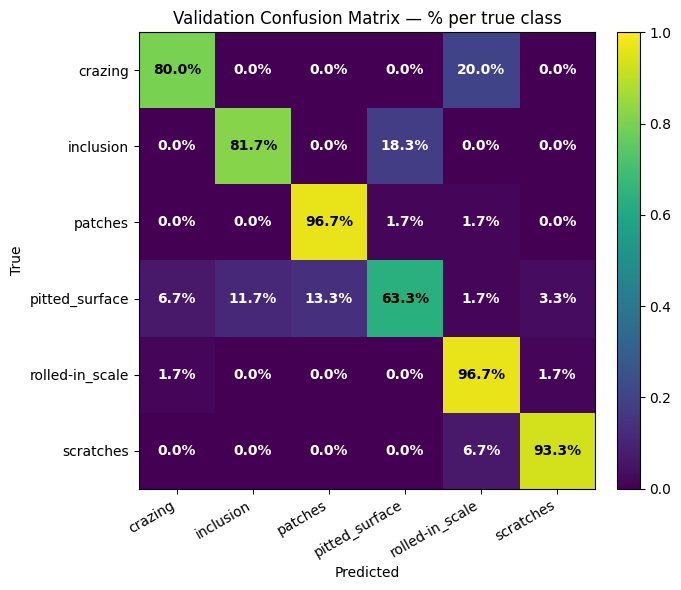

In [17]:
# ==== Annotated confusion matrix (percentages with auto white/black text) ====
# Uses `cm` and `class_names` if already in memory; otherwise computes cm from model + ds_val + val_tf.

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"

def compute_confusion(model, ds, tf, num_classes):
    cm = np.zeros((num_classes, num_classes), dtype=int)
    model.eval()
    with torch.no_grad():
        for path, y in ds.samples:
            x = tf(Image.open(path).convert("L")).unsqueeze(0).to(device)
            p = int(model(x).argmax(1).item())
            cm[y, p] += 1
    return cm

# 1) Get confusion matrix (use existing `cm` if available; else compute)
if 'cm' in globals():
    CM = cm.copy()
else:
    assert all(k in globals() for k in ['model', 'ds_va', 'val_tf', 'class_names']), \
        "Need (model, ds_va, val_tf, class_names) or a precomputed `cm`."
    CM = compute_confusion(model, ds_va, val_tf, len(class_names))

# 2) Row-normalize to percentages
row_sums = CM.sum(axis=1, keepdims=True).clip(min=1)
CMN = CM / row_sums  # values in [0,1]

# 3) Plot with annotations
fig, ax = plt.subplots(figsize=(7, 6))
im = ax.imshow(CMN, cmap="viridis", vmin=0.0, vmax=1.0)
plt.title("Validation Confusion Matrix — % per true class")
plt.colorbar(im, fraction=0.046, pad=0.04)

classes = class_names if 'class_names' in globals() else [str(i) for i in range(CMN.shape[0])]
ax.set_xticks(np.arange(len(classes))); ax.set_xticklabels(classes, rotation=30, ha="right")
ax.set_yticks(np.arange(len(classes))); ax.set_yticklabels(classes)
ax.set_xlabel("Predicted"); ax.set_ylabel("True")

# helper: choose white on dark, black on light (based on luminance of the cell color)
def text_color_for_value(val, im):
    r, g, b, _ = im.cmap(im.norm(val))
    luminance = 0.2126*r + 0.7152*g + 0.0722*b
    return "white" if luminance < 0.5 else "black"

# write percentages
for i in range(CMN.shape[0]):
    for j in range(CMN.shape[1]):
        v = CMN[i, j]
        ax.text(
            j, i, f"{100*v:.1f}%",
            ha="center", va="center",
            color=text_color_for_value(v, im),
            fontsize=10, fontweight="bold"
        )

plt.tight_layout()
plt.show()


GAN train set: 1440 images | classes: ['crazing', 'inclusion', 'patches', 'pitted_surface', 'rolled-in_scale', 'scratches']
Generator params: 1,062,657
Discriminator params: 961,537


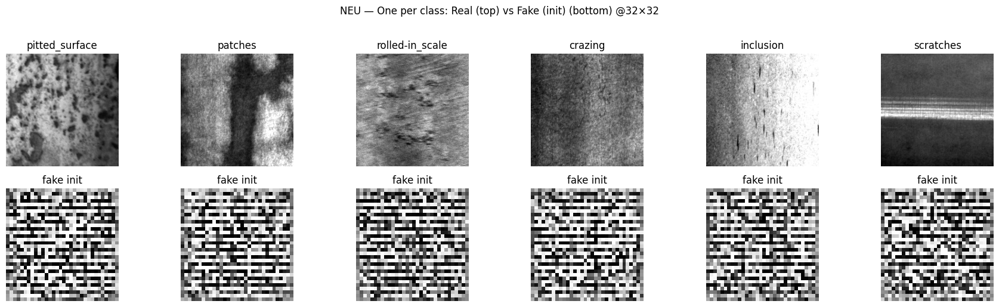

In [18]:
# ==== Cell G1: GAN data + models + samplers (32×32 grayscale) ====
# prereq: TRAIN_IMG_DIR, class_names were defined earlier

import torch, torch.nn as nn
from torch.utils.data import DataLoader
import torchvision.transforms as T
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
from PIL import Image, ImageOps
import numpy as np, random
from pathlib import Path

device = "cuda" if torch.cuda.is_available() else "cpu"
assert 'TRAIN_IMG_DIR' in globals() and 'class_names' in globals()

# ---------- transforms: grayscale + autocontrast, resize 32, map to [-1,1] ----------
to_tensor = T.ToTensor()
train_tf_gan = T.Compose([
    T.Grayscale(1),
    T.Resize((32, 32)),
    T.Lambda(lambda im: ImageOps.autocontrast(im)),
    T.Lambda(lambda im: to_tensor(im)*2.0 - 1.0),   # [0,1] -> [-1,1]
])

ds_gan = ImageFolder(TRAIN_IMG_DIR, transform=train_tf_gan)
dl_gan = DataLoader(ds_gan, batch_size=64, shuffle=True, drop_last=True, num_workers=0)
print("GAN train set:", len(ds_gan), "images | classes:", ds_gan.classes)

# ---------- utils ----------
def denorm(x):  # [-1,1] -> [0,1] for display
    return (x.clamp(-1,1) + 1.0) / 2.0

def one_index_per_class(ds, seed=42):
    rng = random.Random(seed)
    idxs = list(range(len(ds.samples))); rng.shuffle(idxs)
    seen, chosen = set(), []
    for i in idxs:
        _, y = ds.samples[i]
        if y not in seen:
            seen.add(y); chosen.append(i)
        if len(seen) == len(ds.classes): break
    return chosen  # list of indices in class order

# ---------- Generator (cDCGAN-ish) ----------
class Gen(nn.Module):
    def __init__(self, z_dim=64, n_classes=6, emb_dim=32, width=64):
        super().__init__()
        self.embed = nn.Embedding(n_classes, emb_dim)
        in_dim = z_dim + emb_dim
        # 4x4x(4*width) -> 8x8 -> 16x16 -> 32x32
        self.net = nn.Sequential(
            nn.Linear(in_dim, 4*4*width*4),
            nn.BatchNorm1d(4*4*width*4), nn.ReLU(True),
            nn.Unflatten(1, (width*4, 4, 4)),
            nn.ConvTranspose2d(width*4, width*2, 4, 2, 1), nn.BatchNorm2d(width*2), nn.ReLU(True),
            nn.ConvTranspose2d(width*2, width,   4, 2, 1), nn.BatchNorm2d(width),   nn.ReLU(True),
            nn.ConvTranspose2d(width,   1,        4, 2, 1), nn.Tanh(),  # -> 1x32x32 in [-1,1]
        )
    def forward(self, z, y):
        yemb = self.embed(y)
        x = torch.cat([z, yemb], dim=1)
        return self.net(x)

# ---------- Projection Discriminator (Miyato) with spectral norm ----------
def SN(m): return nn.utils.spectral_norm(m)

class ProjDisc(nn.Module):
    def __init__(self, n_classes=6, width=64):
        super().__init__()
        c = width
        self.f = nn.Sequential(
            SN(nn.Conv2d(1,   c,  3, 2, 1)), nn.LeakyReLU(0.2, True),   # 16x16
            SN(nn.Conv2d(c,   c*2,3, 2, 1)), nn.LeakyReLU(0.2, True),   # 8x8
            SN(nn.Conv2d(c*2, c*4,3, 2, 1)), nn.LeakyReLU(0.2, True),   # 4x4
            SN(nn.Conv2d(c*4, c*4,3, 1, 1)), nn.LeakyReLU(0.2, True),   # 4x4
        )
        self.lin   = SN(nn.Linear(c*4, 1))
        self.embed = nn.Embedding(n_classes, c*4)
    def forward(self, x, y):
        h = self.f(x)
        h = h.sum(dim=(2,3))  # global sum pooling -> (B, C)
        out = self.lin(h).squeeze(1)                    # base score
        proj = (self.embed(y) * h).sum(dim=1)           # class projection
        return out + proj                                # scalar score per sample

# instantiate
Z_DIM   = 64
NCLS    = len(class_names)
GWIDTH  = 64  # generator base channels
DWIDTH  = 64  # discriminator base channels

G = Gen(z_dim=Z_DIM, n_classes=NCLS, emb_dim=32, width=GWIDTH).to(device)
D = ProjDisc(n_classes=NCLS, width=DWIDTH).to(device)

# fixed noise for reproducible sampling (one per class)
z_fixed = torch.randn(NCLS, Z_DIM, device=device)
y_fixed = torch.arange(NCLS, device=device)

print(f"Generator params: {sum(p.numel() for p in G.parameters()):,}")
print(f"Discriminator params: {sum(p.numel() for p in D.parameters()):,}")

# ---------- quick real vs fake 2×6 grid ----------
@torch.no_grad()
def show_real_fake_grid():
    idxs = one_index_per_class(ds_gan, seed=42)
    fig, axes = plt.subplots(2, NCLS, figsize=(3*NCLS, 5))
    # top: real (original)
    for col, i in enumerate(idxs):
        path, y = ds_gan.samples[i]
        pil = Image.open(path).convert("L")
        axes[0,col].imshow(pil, cmap="gray"); axes[0,col].set_title(ds_gan.classes[y]); axes[0,col].axis("off")
    # bottom: first fake (untrained G → noise)
    fake = G(z_fixed, y_fixed).cpu()
    for col in range(NCLS):
        axes[1,col].imshow(denorm(fake[col,0]).numpy(), cmap="gray")
        axes[1,col].set_title("fake init"); axes[1,col].axis("off")
    plt.suptitle("NEU — One per class: Real (top) vs Fake (init) (bottom) @32×32", y=1.02)
    plt.tight_layout(); plt.show()

show_real_fake_grid()


Epoch 1/50 — D_loss 1.681 | G_loss 2.318


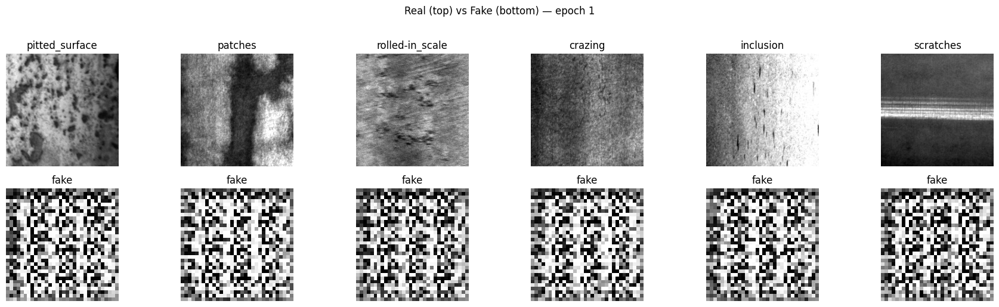

Classifier acc on generated (label fidelity proxy): 0.183
Epoch 2/50 — D_loss 0.079 | G_loss 9.652


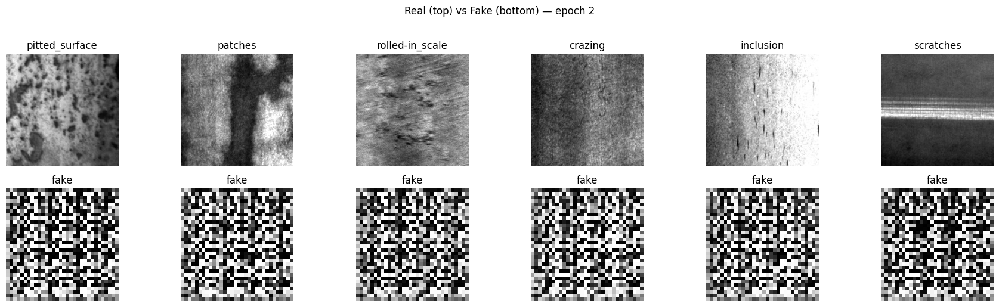

Classifier acc on generated (label fidelity proxy): 0.167
Epoch 3/50 — D_loss 0.000 | G_loss 7.592


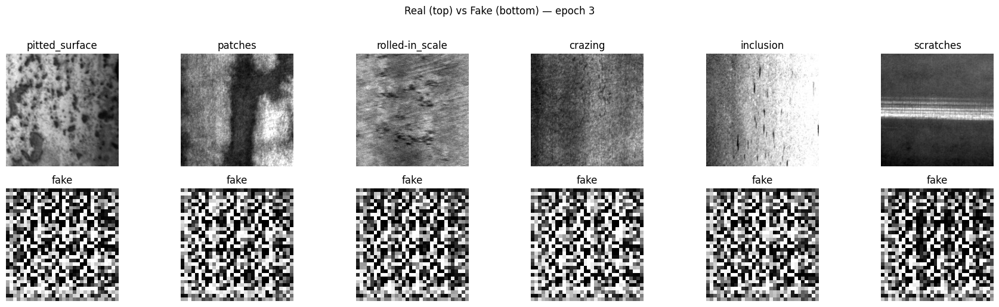

Classifier acc on generated (label fidelity proxy): 0.167
Epoch 4/50 — D_loss 0.007 | G_loss 4.449


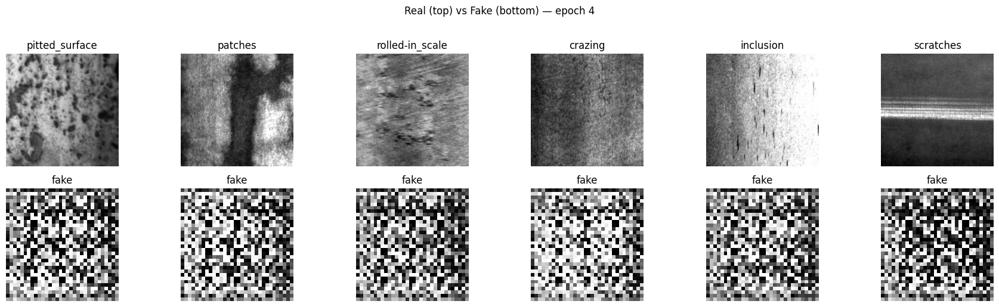

Classifier acc on generated (label fidelity proxy): 0.158
Epoch 5/50 — D_loss 0.026 | G_loss 8.730


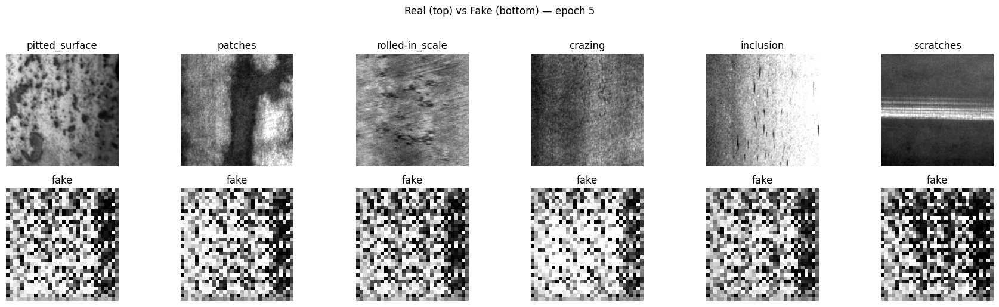

Classifier acc on generated (label fidelity proxy): 0.167
Epoch 6/50 — D_loss 0.000 | G_loss 4.940


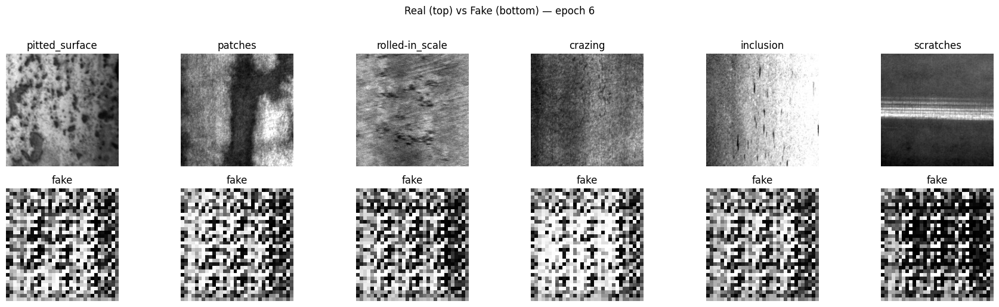

Classifier acc on generated (label fidelity proxy): 0.333
Epoch 7/50 — D_loss 0.000 | G_loss 4.713


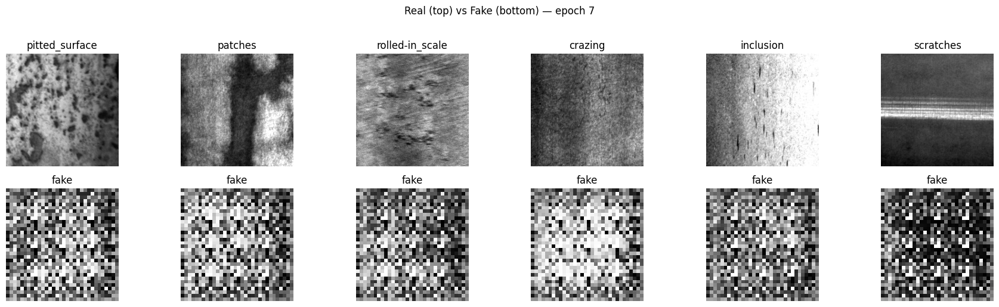

Classifier acc on generated (label fidelity proxy): 0.217
Epoch 8/50 — D_loss 0.322 | G_loss 4.821


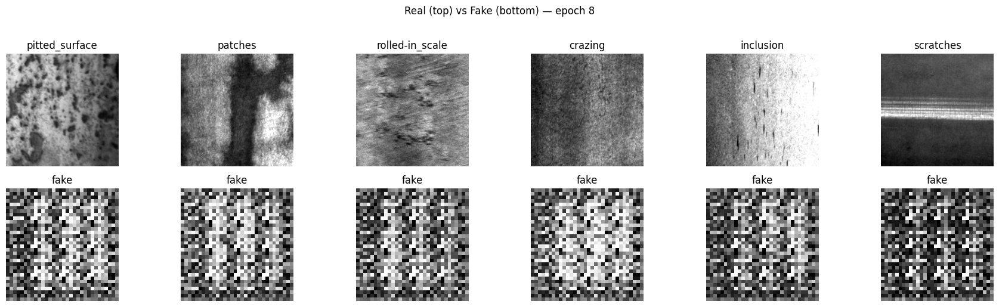

Classifier acc on generated (label fidelity proxy): 0.258
Epoch 9/50 — D_loss 1.684 | G_loss 1.138


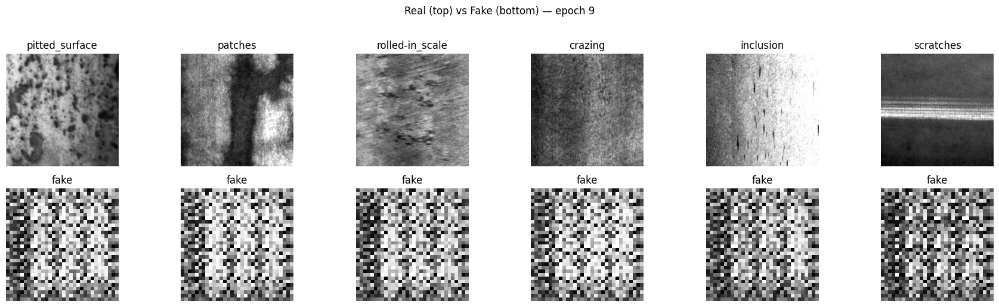

Classifier acc on generated (label fidelity proxy): 0.167
Epoch 10/50 — D_loss 0.000 | G_loss 3.761


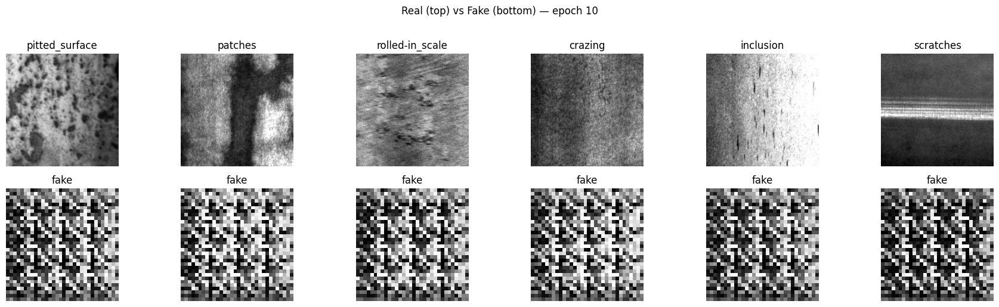

Classifier acc on generated (label fidelity proxy): 0.175
Epoch 11/50 — D_loss 0.000 | G_loss 4.641


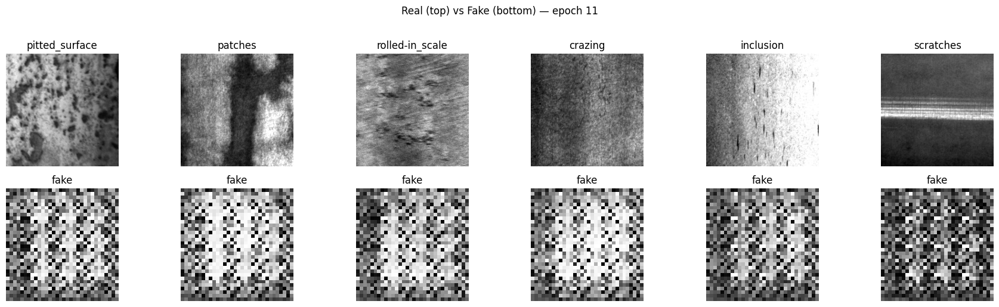

Classifier acc on generated (label fidelity proxy): 0.183
Epoch 12/50 — D_loss 0.000 | G_loss 2.625


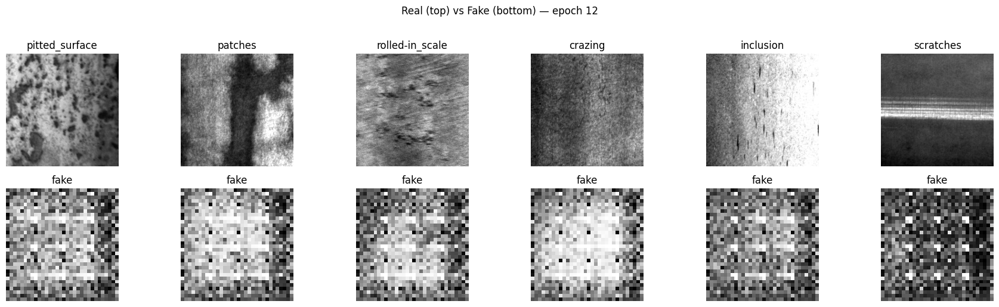

Classifier acc on generated (label fidelity proxy): 0.175
Epoch 13/50 — D_loss 0.007 | G_loss 2.484


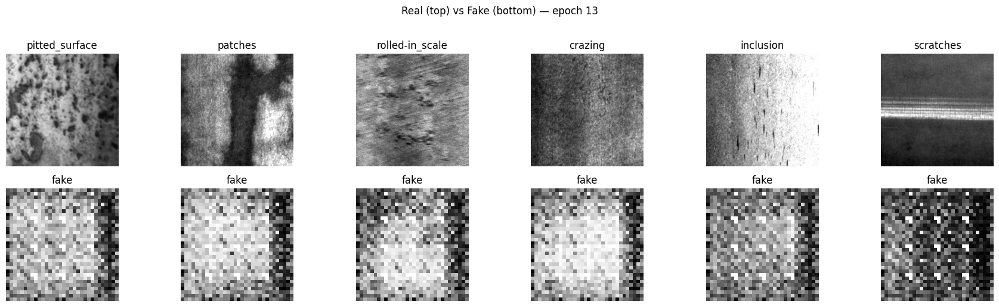

Classifier acc on generated (label fidelity proxy): 0.175
Epoch 14/50 — D_loss 0.423 | G_loss 1.708


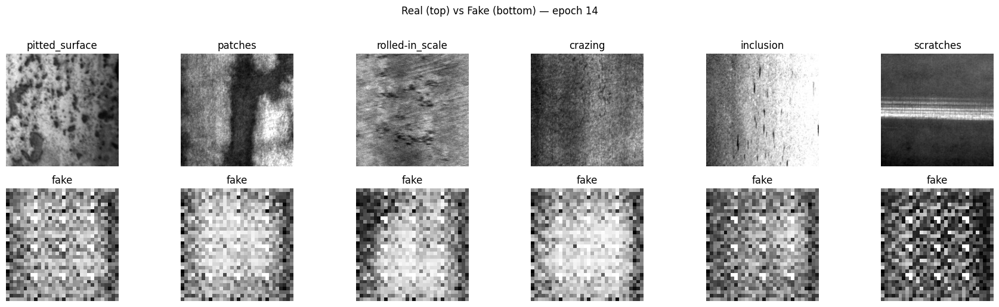

Classifier acc on generated (label fidelity proxy): 0.225
Epoch 15/50 — D_loss 0.000 | G_loss 2.469


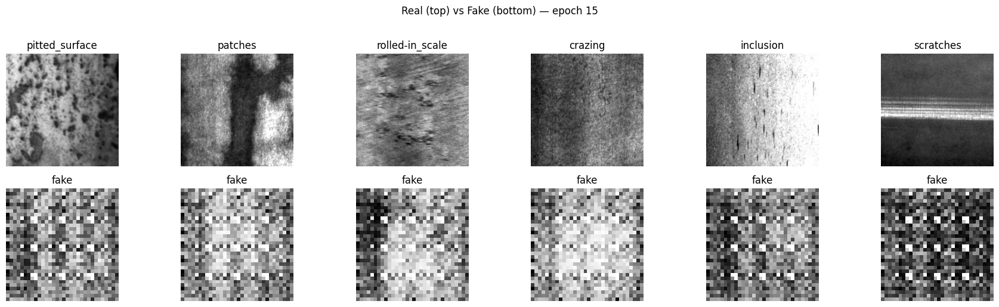

Classifier acc on generated (label fidelity proxy): 0.158
Epoch 16/50 — D_loss 0.184 | G_loss 4.777


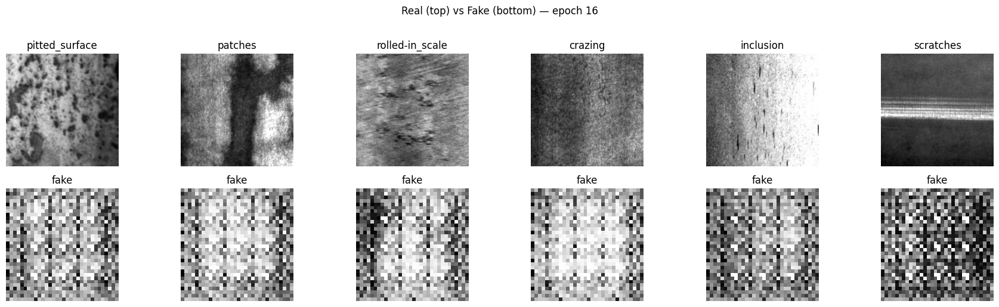

Classifier acc on generated (label fidelity proxy): 0.167
Epoch 17/50 — D_loss 3.531 | G_loss 6.051


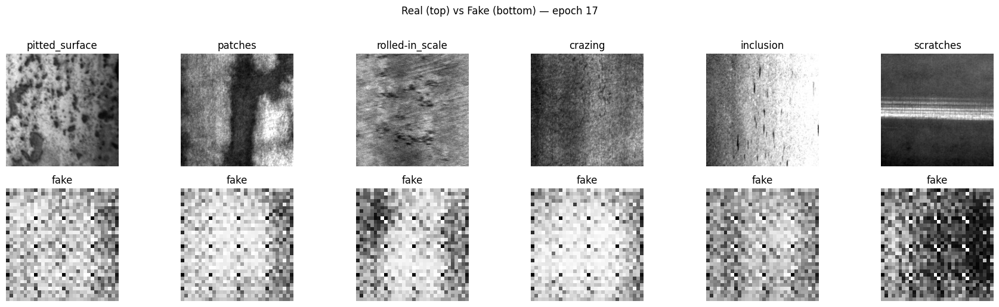

Classifier acc on generated (label fidelity proxy): 0.333
Epoch 18/50 — D_loss 0.234 | G_loss 3.746


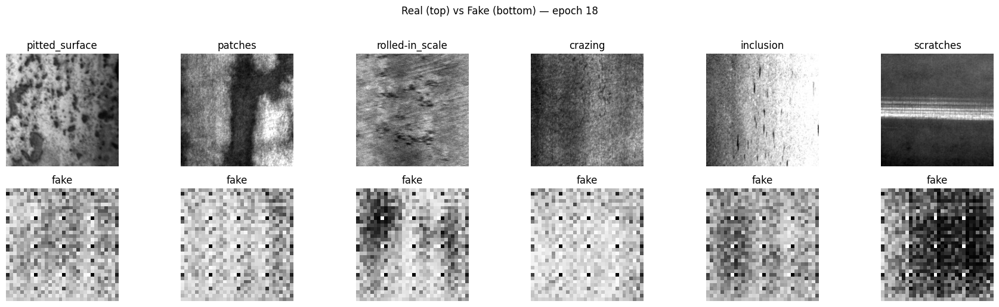

Classifier acc on generated (label fidelity proxy): 0.333
Epoch 19/50 — D_loss 1.153 | G_loss -0.937


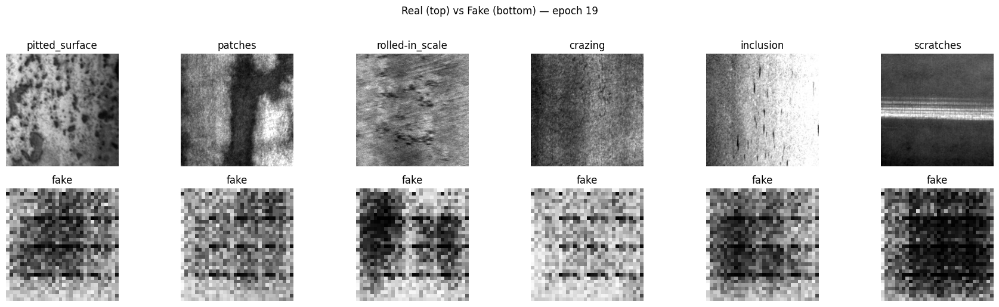

Classifier acc on generated (label fidelity proxy): 0.183
Epoch 20/50 — D_loss 1.265 | G_loss 2.327


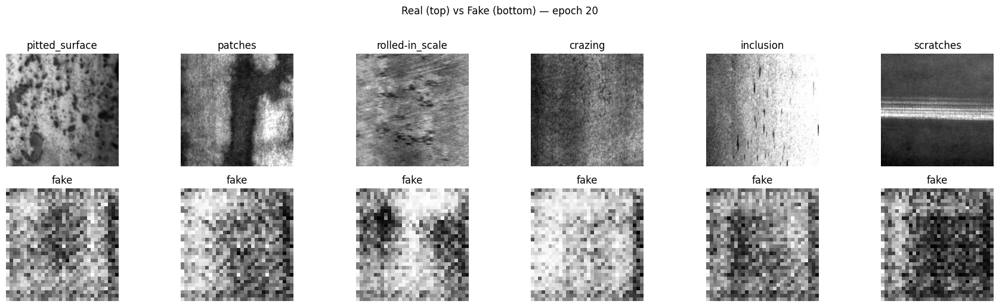

Classifier acc on generated (label fidelity proxy): 0.300
Epoch 21/50 — D_loss 1.130 | G_loss 0.892


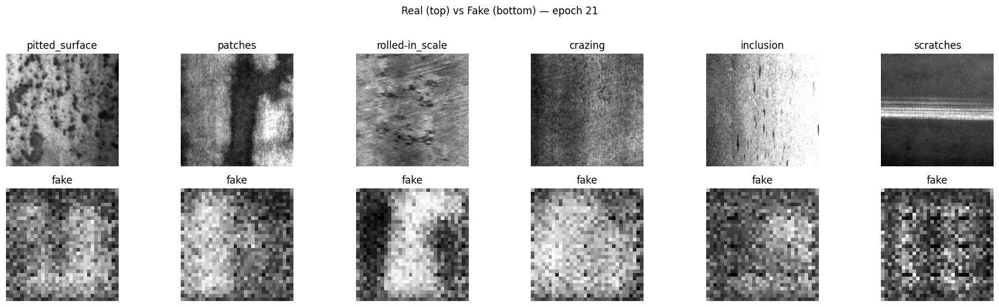

Classifier acc on generated (label fidelity proxy): 0.292
Epoch 22/50 — D_loss 0.640 | G_loss 0.208


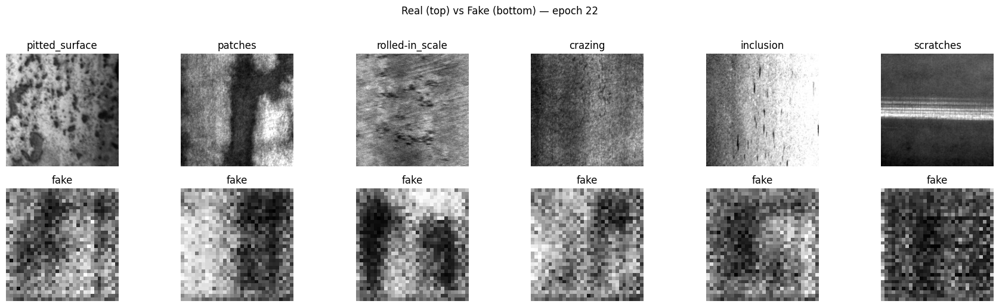

Classifier acc on generated (label fidelity proxy): 0.442
Epoch 23/50 — D_loss 0.690 | G_loss 0.735


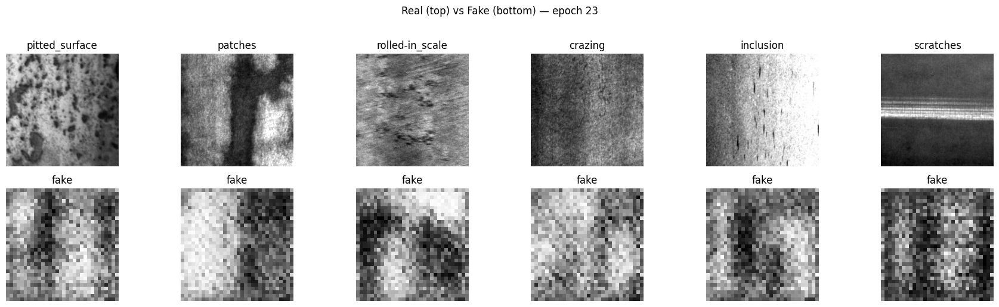

Classifier acc on generated (label fidelity proxy): 0.292
Epoch 24/50 — D_loss 1.001 | G_loss 1.518


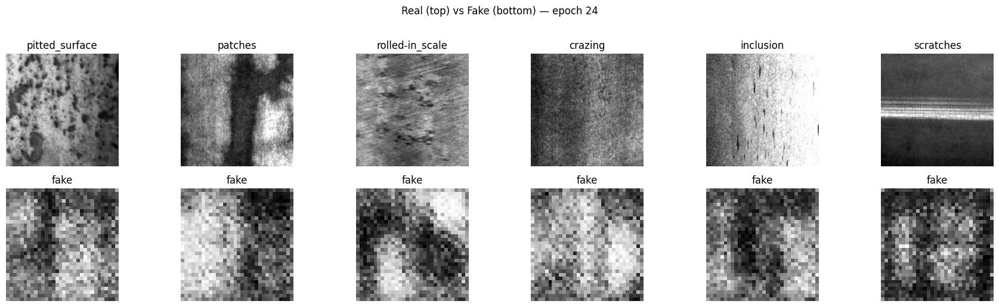

Classifier acc on generated (label fidelity proxy): 0.242
Epoch 25/50 — D_loss 1.036 | G_loss 3.278


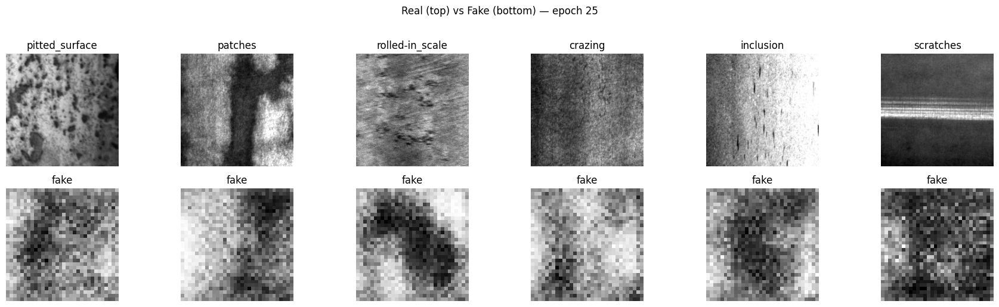

Classifier acc on generated (label fidelity proxy): 0.542
Epoch 26/50 — D_loss 0.479 | G_loss 0.851


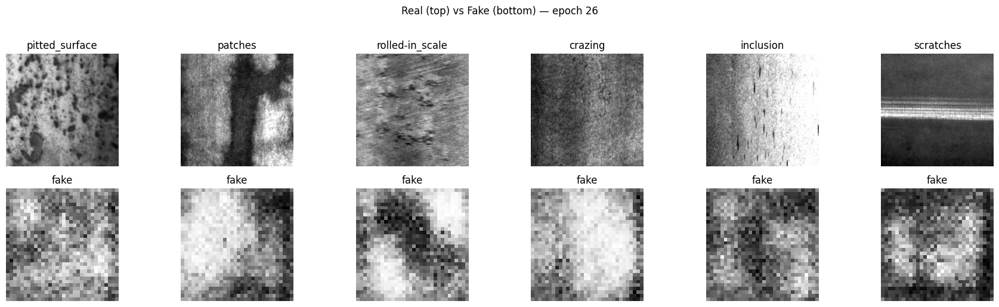

Classifier acc on generated (label fidelity proxy): 0.342
Epoch 27/50 — D_loss 1.238 | G_loss 0.385


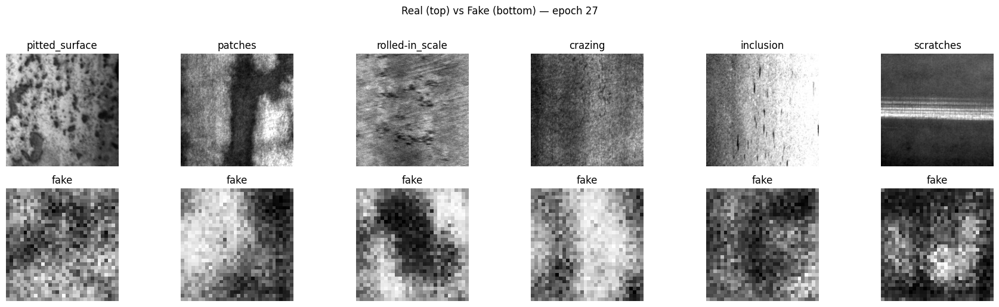

Classifier acc on generated (label fidelity proxy): 0.433
Epoch 28/50 — D_loss 0.823 | G_loss 2.315


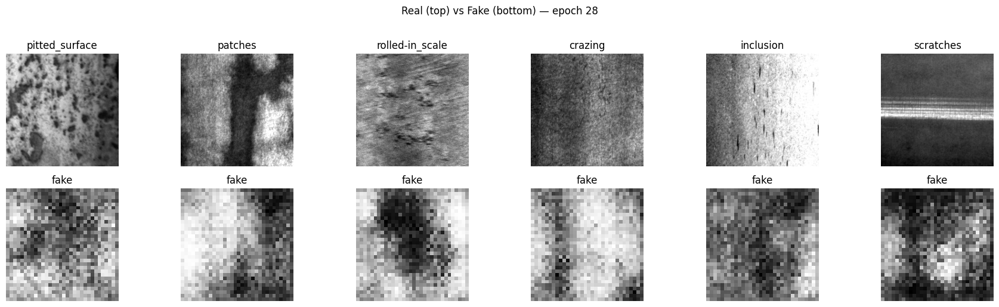

Classifier acc on generated (label fidelity proxy): 0.417
Epoch 29/50 — D_loss 0.366 | G_loss 2.556


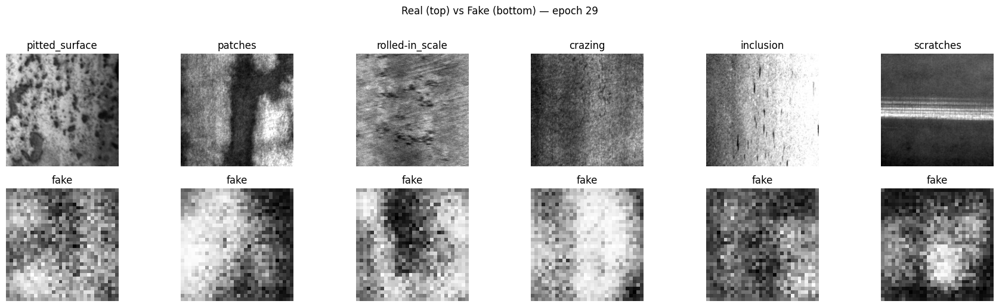

Classifier acc on generated (label fidelity proxy): 0.367
Epoch 30/50 — D_loss 0.835 | G_loss 4.382


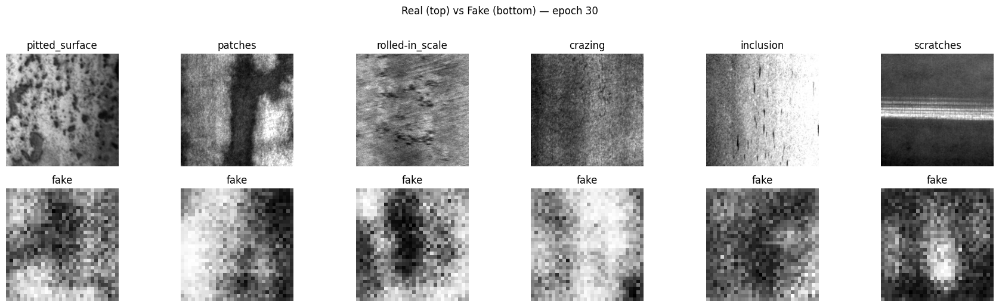

Classifier acc on generated (label fidelity proxy): 0.383
Epoch 31/50 — D_loss 0.487 | G_loss 2.923


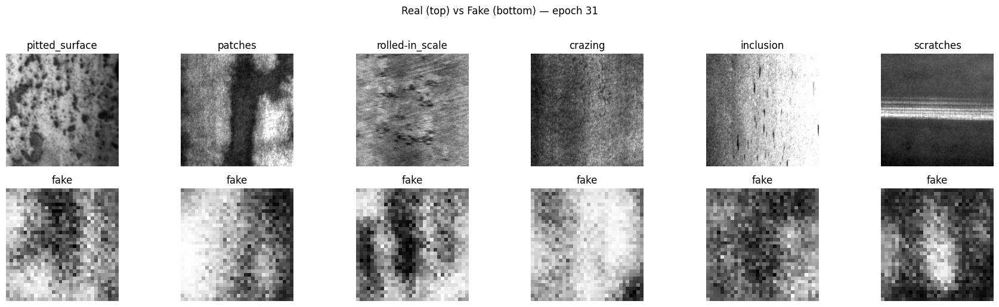

Classifier acc on generated (label fidelity proxy): 0.333
Epoch 32/50 — D_loss 1.277 | G_loss 2.812


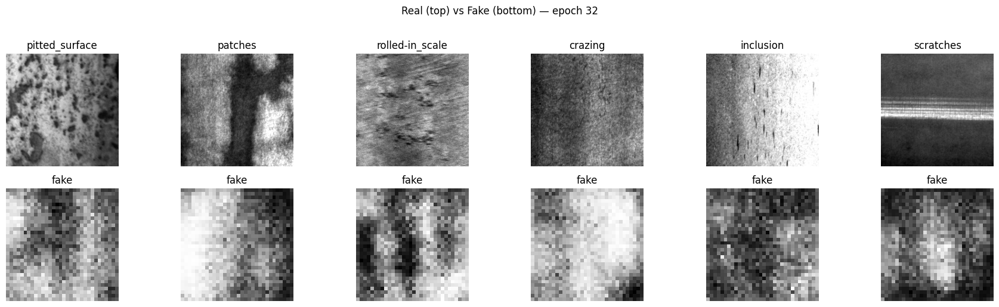

Classifier acc on generated (label fidelity proxy): 0.442
Epoch 33/50 — D_loss 0.393 | G_loss 3.238


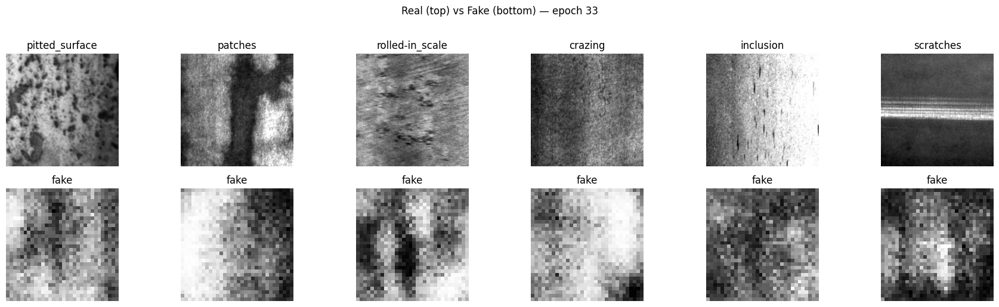

Classifier acc on generated (label fidelity proxy): 0.442
Epoch 34/50 — D_loss 0.196 | G_loss 4.167


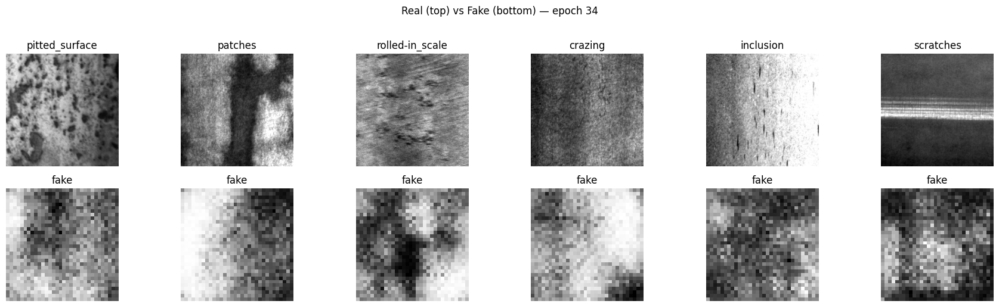

Classifier acc on generated (label fidelity proxy): 0.408
Epoch 35/50 — D_loss 0.943 | G_loss 3.497


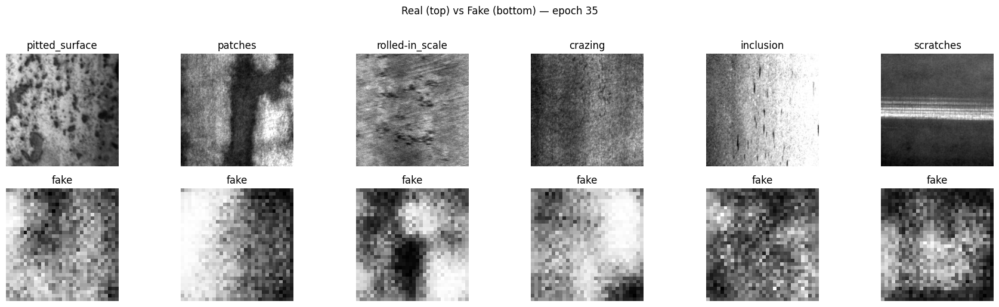

Classifier acc on generated (label fidelity proxy): 0.383
Epoch 36/50 — D_loss 1.461 | G_loss 2.615


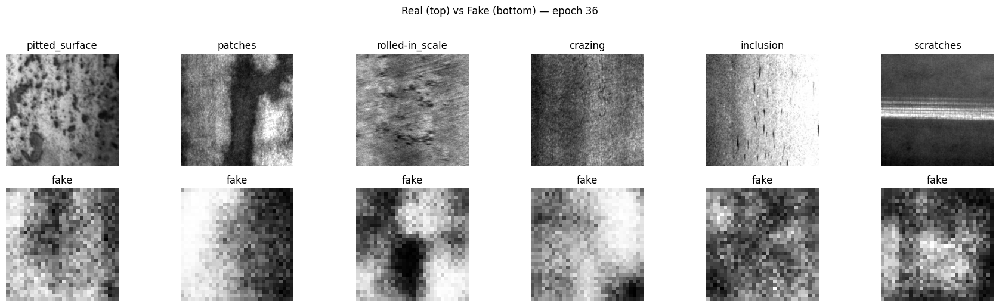

Classifier acc on generated (label fidelity proxy): 0.533
Epoch 37/50 — D_loss 1.335 | G_loss 2.957


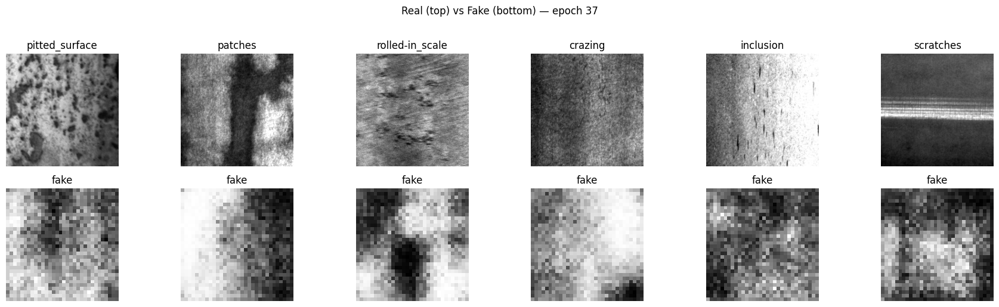

Classifier acc on generated (label fidelity proxy): 0.483
Epoch 38/50 — D_loss 0.490 | G_loss 1.546


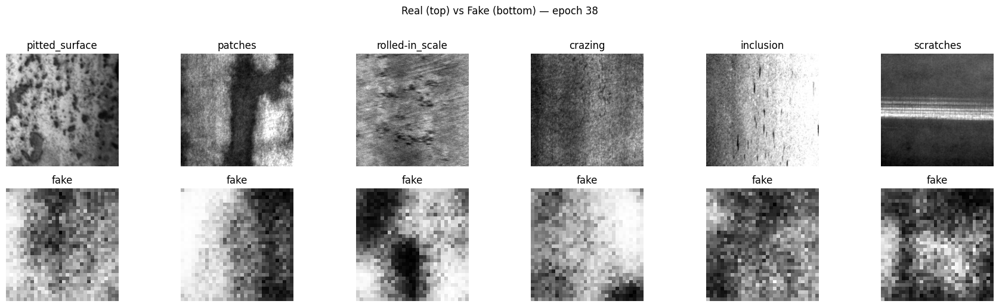

Classifier acc on generated (label fidelity proxy): 0.467
Epoch 39/50 — D_loss 0.806 | G_loss 2.263


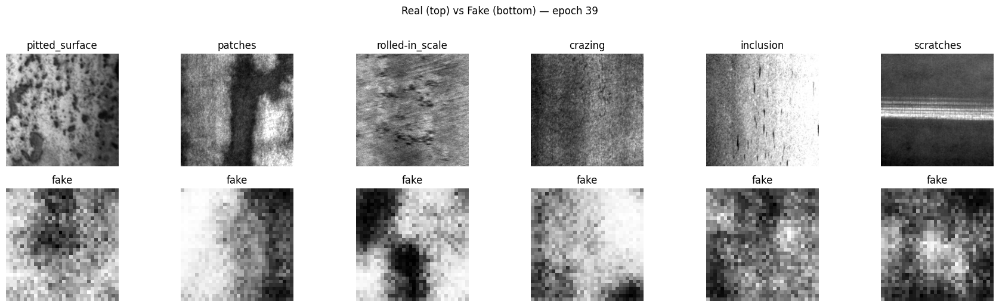

Classifier acc on generated (label fidelity proxy): 0.483
Epoch 40/50 — D_loss 0.615 | G_loss 2.964


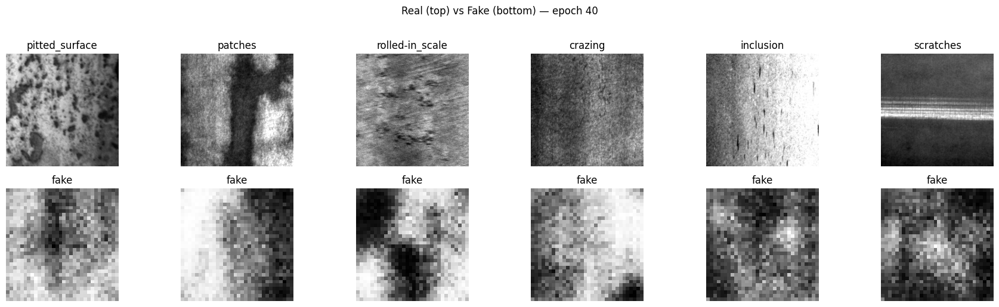

Classifier acc on generated (label fidelity proxy): 0.467
Epoch 41/50 — D_loss 0.358 | G_loss 2.579


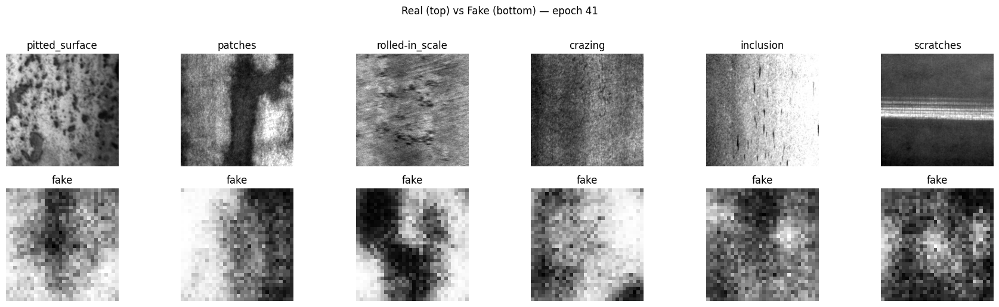

Classifier acc on generated (label fidelity proxy): 0.500
Epoch 42/50 — D_loss 0.870 | G_loss 3.250


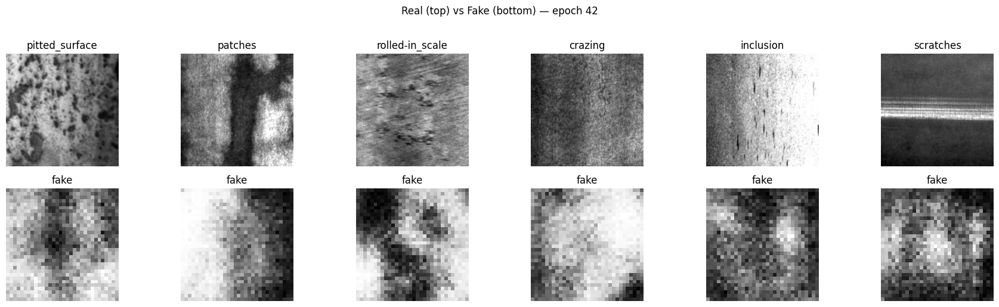

Classifier acc on generated (label fidelity proxy): 0.358
Epoch 43/50 — D_loss 0.315 | G_loss 2.597


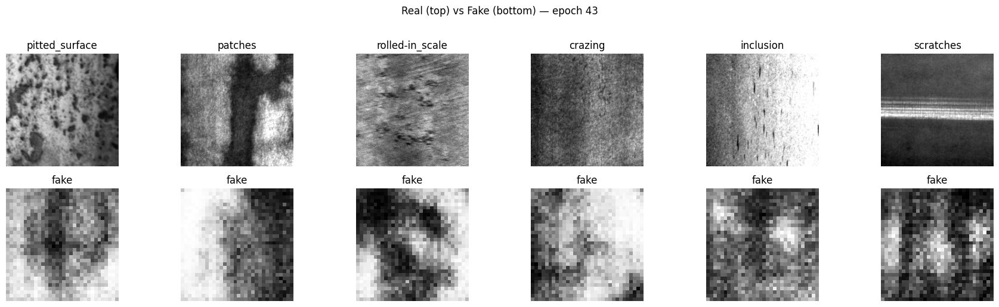

Classifier acc on generated (label fidelity proxy): 0.567
Epoch 44/50 — D_loss 1.066 | G_loss 3.585


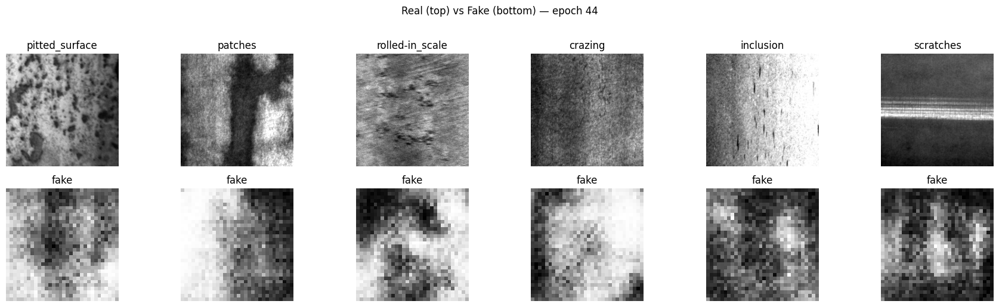

Classifier acc on generated (label fidelity proxy): 0.550
Epoch 45/50 — D_loss 0.117 | G_loss 2.985


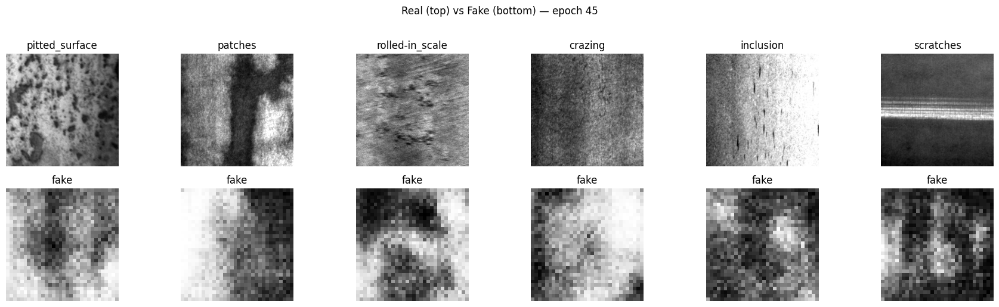

Classifier acc on generated (label fidelity proxy): 0.633
Epoch 46/50 — D_loss 1.115 | G_loss 3.212


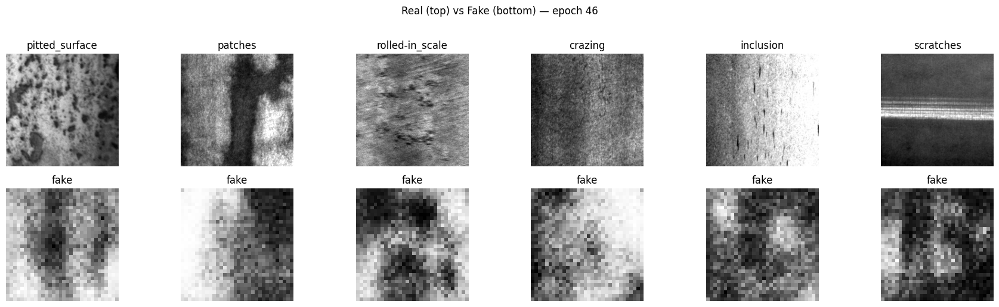

Classifier acc on generated (label fidelity proxy): 0.742
Epoch 47/50 — D_loss 0.557 | G_loss 3.068


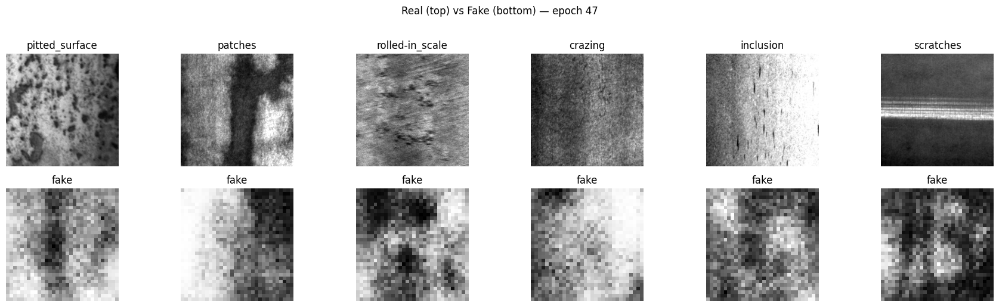

Classifier acc on generated (label fidelity proxy): 0.575
Epoch 48/50 — D_loss 0.305 | G_loss 2.883


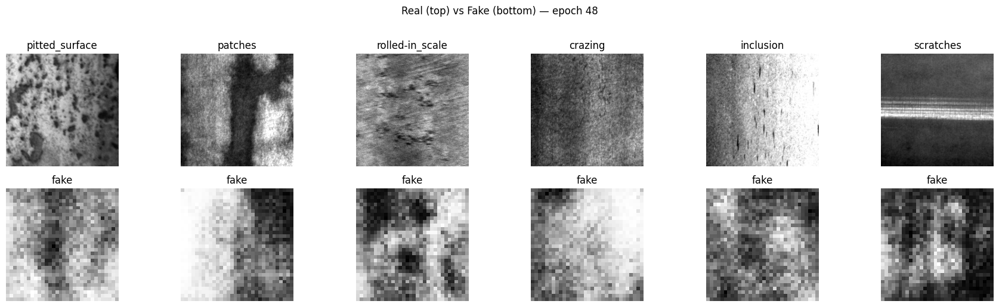

Classifier acc on generated (label fidelity proxy): 0.558
Epoch 49/50 — D_loss 1.241 | G_loss 2.847


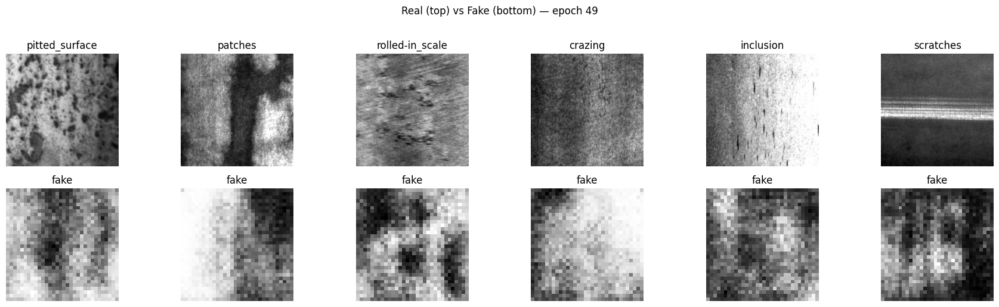

Classifier acc on generated (label fidelity proxy): 0.600
Epoch 50/50 — D_loss 0.782 | G_loss 3.193


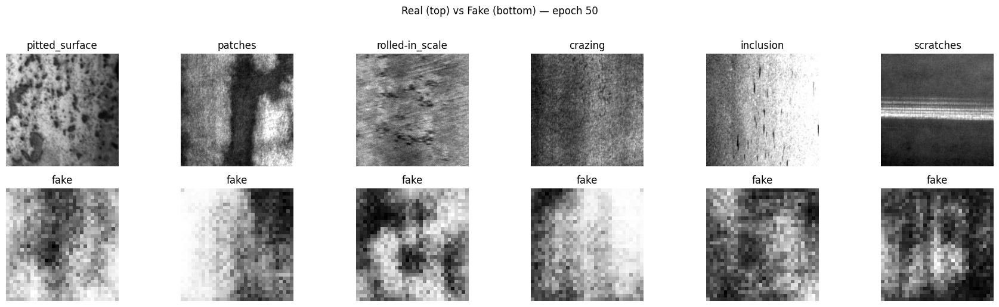

Classifier acc on generated (label fidelity proxy): 0.533


In [19]:
# ==== Cell G2: Train hinge cGAN (projection D) + per-epoch 2x6 grid ====

import torch, torch.nn as nn, torch.optim as optim
import matplotlib.pyplot as plt

# --- losses: hinge GAN ---
def d_hinge_loss(real_scores, fake_scores):
    return (nn.ReLU()(1.0 - real_scores)).mean() + (nn.ReLU()(1.0 + fake_scores)).mean()

def g_hinge_loss(fake_scores):
    return -fake_scores.mean()

# --- opt (TTUR) ---
optD = optim.Adam(D.parameters(), lr=2e-4, betas=(0.0, 0.9))
optG = optim.Adam(G.parameters(), lr=1e-4, betas=(0.0, 0.9))

EPOCHS   = 50          # keep small first; you can bump later
N_CRITIC = 1           # D steps per G step
BATCH    = next(iter(dl_gan))[0].size(0)

@torch.no_grad()
def sample_grid(G, title_note=""):
    G.eval()
    f = G(z_fixed, y_fixed).cpu()
    idxs = one_index_per_class(ds_gan, seed=42)
    fig, axes = plt.subplots(2, NCLS, figsize=(3*NCLS, 5))
    # top: real originals
    for col, i in enumerate(idxs):
        path, y = ds_gan.samples[i]
        pil = Image.open(path).convert("L")
        axes[0,col].imshow(pil, cmap="gray"); axes[0,col].set_title(ds_gan.classes[y]); axes[0,col].axis("off")
    # bottom: fakes
    for col in range(NCLS):
        axes[1,col].imshow(denorm(f[col,0]).numpy(), cmap="gray"); axes[1,col].axis("off")
        axes[1,col].set_title("fake")
    plt.suptitle(f"Real (top) vs Fake (bottom) — {title_note}", y=1.02)
    plt.tight_layout(); plt.show()

# optional: quick realism check via your trained classifier (if available)
HAS_CLS = all(k in globals() for k in ['model','val_tf','class_names'])
@torch.no_grad()
def classifier_acc_on_generated(G, per_class=60):
    if not HAS_CLS: return None
    model.eval()
    total, correct = 0, 0
    for y in range(NCLS):
        yb = torch.full((per_class,), y, dtype=torch.long, device=device)
        zb = torch.randn(per_class, Z_DIM, device=device)
        fake = G(zb, yb)                       # [-1,1]
        # upsample to 32 and convert to classifier input (already 32x32, grayscale)
        x = (fake + 1)/2  # [0,1]
        # val_tf expects PIL -> we bypass by normalizing like it would:
        # our val_tf = Grayscale->Resize->Autocontrast->ToTensor; fake is already tensor 32x32
        # so just feed as-is
        logits = model(x.to(device))
        preds = logits.argmax(1).cpu()
        correct += (preds.numpy() == y).sum()
        total   += per_class
    return correct / total

# --- training loop ---
step = 0
for ep in range(1, EPOCHS+1):
    for xb, yb in dl_gan:
        xb, yb = xb.to(device), yb.to(device)  # xb in [-1,1]
        b = xb.size(0)

        # ---- D step ----
        for _ in range(N_CRITIC):
            z = torch.randn(b, Z_DIM, device=device)
            with torch.no_grad(): fake = G(z, yb)
            D.train(); optD.zero_grad()
            real_scores = D(xb, yb)
            fake_scores = D(fake, yb)
            d_loss = d_hinge_loss(real_scores, fake_scores)
            d_loss.backward(); optD.step()

        # ---- G step ----
        z = torch.randn(b, Z_DIM, device=device)
        y_fake = yb  # condition on same labels for stability
        G.train(); optG.zero_grad()
        fake = G(z, y_fake)
        g_loss = g_hinge_loss(D(fake, y_fake))
        g_loss.backward(); optG.step()

        step += 1

    # ---- epoch end: show grid + (optional) classifier score ----
    print(f"Epoch {ep}/{EPOCHS} — D_loss {d_loss.item():.3f} | G_loss {g_loss.item():.3f}")
    sample_grid(G, title_note=f"epoch {ep}")

    if HAS_CLS:
        cls_acc = classifier_acc_on_generated(G, per_class=20)
        if cls_acc is not None:
            print(f"Classifier acc on generated (label fidelity proxy): {cls_acc:.3f}")


In [20]:
# ==== G4: Export balanced synthetic set + quick scores (FID-lite, fidelity, diversity) ====
# Prereqs: G (generator), ds_gan (train ImageFolder), model (your 32x32 classifier WIDTH=24),
#          val_tf (32x32 gray+autocontrast), class_names, device, Z_DIM.

import os, math, json
from pathlib import Path
import torch, numpy as np
import torchvision.utils as vutils
from PIL import Image
import matplotlib.pyplot as plt

assert all(k in globals() for k in ['G','ds_gan','model','val_tf','class_names','device','Z_DIM']), \
    "Need: G, ds_gan, model, val_tf, class_names, device, Z_DIM"

N_PER_CLASS = 500            # change if you want more/less
OUT_DIR = Path("synthetic_neu_32x32")
OUT_DIR.mkdir(parents=True, exist_ok=True)
for c in class_names: (OUT_DIR/c).mkdir(parents=True, exist_ok=True)

@torch.no_grad()
def synth_dump_per_class(G, cls_idx, n, batch=64):
    saved = 0; k = 0
    while saved < n:
        b = min(batch, n - saved)
        z = torch.randn(b, Z_DIM, device=device)
        y = torch.full((b,), cls_idx, dtype=torch.long, device=device)
        x = (G(z, y).clamp(-1,1) + 1)/2  # [0,1]
        for i in range(b):
            arr = (x[i,0].cpu().numpy()*255).astype(np.uint8)
            Image.fromarray(arr).save(OUT_DIR/class_names[cls_idx]/f"{class_names[cls_idx]}_g_{saved+i:04d}.png")
        saved += b; k += 1

print("Exporting synthetic images...")
for ci, c in enumerate(class_names):
    synth_dump_per_class(G, ci, N_PER_CLASS)
print("Done:", sum(len(list((OUT_DIR/c).glob('*.png'))) for c in class_names), "images saved in", OUT_DIR)

# ---------- Feature extractor from your classifier (penultimate features) ----------
# Your SimpleCNN32 has `f` then head; we’ll tap after the pooling before the head.
def cls_features(model, x):
    with torch.no_grad():
        h = model.f(x)        # (B,C,1,1)
        return h.flatten(1)   # (B,C)

# ---------- Make loaders for REAL (validation) and FAKE (exported) ----------
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import torchvision.transforms as T

real_ds = ImageFolder(VAL_IMG_DIR, transform=val_tf)   # real validation
fake_tf = T.Compose([ T.Grayscale(1), T.Resize((32,32)), T.ToTensor() ])  # our PNGs are already 32x32 gray
fake_ds = ImageFolder(str(OUT_DIR), transform=fake_tf)

real_loader = DataLoader(real_ds, batch_size=128, shuffle=False, num_workers=0)
fake_loader = DataLoader(fake_ds, batch_size=128, shuffle=False, num_workers=0)

# ---------- Collect features + labels ----------
def collect_feats(ds, loader):
    fts, ys = [], []
    for xb, yb in loader:
        xb = xb.to(device)
        f = cls_features(model, xb)
        fts.append(f.cpu().numpy()); ys.append(yb.numpy())
    return np.concatenate(fts,0), np.concatenate(ys,0)

real_F, real_y = collect_feats(real_ds, real_loader)
fake_F, fake_y = collect_feats(fake_ds, fake_loader)

# ---------- FID-lite (classifier feature space) ----------
def fid_from_feats(F1, F2, eps=1e-6):
    m1, m2 = F1.mean(0), F2.mean(0)
    C1 = np.cov(F1, rowvar=False); C2 = np.cov(F2, rowvar=False)
    # sqrt of C1*C2 via eigen
    A = C1.dot(C2)
    vals, vecs = np.linalg.eigh(A)
    vals = np.clip(vals, 0, None)
    sqrtA = vecs.dot(np.diag(np.sqrt(vals))).dot(vecs.T)
    diff = m1 - m2
    return float(diff.dot(diff) + np.trace(C1 + C2 - 2*sqrtA))

FID_overall = fid_from_feats(real_F, fake_F)

# ---------- Per-class fidelity (classifier accuracy on fakes) ----------
@torch.no_grad()
def classifier_fidelity_on_folder(ds, loader):
    model.eval(); total=0; correct=0
    per_class = {c: [0,0] for c in class_names}  # correct, total
    for xb, yb in loader:
        logits = model(xb.to(device))
        preds = logits.argmax(1).cpu().numpy()
        yb = yb.numpy()
        total += len(yb); correct += (preds==yb).sum()
        for p,y in zip(preds, yb):
            name = class_names[y]
            per_class[name][1] += 1
            if p==y: per_class[name][0] += 1
    acc = correct/total
    per = {k: (v[0]/max(1,v[1])) for k,v in per_class.items()}
    return acc, per

fidelity_overall, fidelity_per_class = classifier_fidelity_on_folder(fake_ds, fake_loader)

# ---------- Diversity proxy: mean pairwise distance in feature space (per class) ----------
def mean_pairwise_dist(F):
    if len(F) < 2: return 0.0
    # sample up to 500 pairs for speed
    rng = np.random.default_rng(0)
    idx = rng.choice(len(F), size=min(200, len(F)), replace=False)
    S = F[idx]
    D = np.sqrt(((S[:,None,:]-S[None,:,:])**2).sum(2))
    # upper triangle mean
    iu = np.triu_indices(len(S), k=1)
    return float(D[iu].mean())

diversity_per_class = {}
for ci,c in enumerate(class_names):
    diversity_per_class[c] = mean_pairwise_dist(fake_F[fake_y==ci])

print("\n=== Synthetic set scores (32×32, current G) ===")
print(f"Images exported: {sum((fake_y==i).sum() for i in range(len(class_names)))}  "
      f"({N_PER_CLASS}/class)  ->  Folder: {OUT_DIR}")
print(f"FID-lite (classifier feature space, overall): {FID_overall:.3f}")
print(f"Classifier fidelity on fakes (overall acc):   {fidelity_overall:.3f}")
print("Per-class fidelity:")
for c in class_names:
    print(f"  {c:16s}: {fidelity_per_class[c]:.3f}")
print("Per-class diversity (mean pairwise L2 in feature space):")
for c in class_names:
    print(f"  {c:16s}: {diversity_per_class[c]:.4f}")


Exporting synthetic images...
Done: 3000 images saved in synthetic_neu_32x32

=== Synthetic set scores (32×32, current G) ===
Images exported: 3000  (500/class)  ->  Folder: synthetic_neu_32x32
FID-lite (classifier feature space, overall): -38.557
Classifier fidelity on fakes (overall acc):   0.600
Per-class fidelity:
  crazing         : 0.886
  inclusion       : 0.020
  patches         : 0.688
  pitted_surface  : 0.990
  rolled-in_scale : 0.286
  scratches       : 0.728
Per-class diversity (mean pairwise L2 in feature space):
  crazing         : 2.9954
  inclusion       : 3.8275
  patches         : 3.1655
  pitted_surface  : 2.4704
  rolled-in_scale : 2.8980
  scratches       : 2.2596


In [21]:
# ==== Cell F1: Quality filter synthetic images by classifier confidence ====
import os, shutil
from pathlib import Path
import numpy as np
import torch
from torchvision.datasets import ImageFolder
import torchvision.transforms as T
from PIL import Image

assert all(k in globals() for k in ['model','class_names','device']), "Load your 32×32 classifier first."

SYN_DIR   = Path("synthetic_neu_32x32")
OUT_DIR   = Path("synthetic_neu_32x32_filtered")
THRESH    = 0.90   # keep >= 0.90 confidence

# transforms (synthetic pngs are already 32×32 gray; we still pass through val_tf for consistency)
val_tf = T.Compose([T.Grayscale(1), T.Resize((32,32)), T.ToTensor()])

ds_syn  = ImageFolder(str(SYN_DIR), transform=val_tf)
for c in class_names: (OUT_DIR/c).mkdir(parents=True, exist_ok=True)

@torch.no_grad()
def score_and_copy():
    model.eval()
    kept = {c:0 for c in class_names}
    total= {c:0 for c in class_names}
    for (path, y) in ds_syn.samples:
        total[class_names[y]] += 1
        x = val_tf(Image.open(path).convert("L")).unsqueeze(0).to(device)
        prob = torch.softmax(model(x), dim=1)[0,y].item()
        if prob >= THRESH:
            dest = OUT_DIR/class_names[y]/Path(path).name
            shutil.copy2(path, dest)
            kept[class_names[y]] += 1
    return kept, total

kept, total = score_and_copy()
print(f"Saved filtered set to: {OUT_DIR}\nTHRESH = {THRESH}")
for c in class_names:
    print(f"{c:16s}: kept {kept[c]:4d} / {total[c]:4d}")


Saved filtered set to: synthetic_neu_32x32_filtered
THRESH = 0.9
crazing         : kept  178 /  500
inclusion       : kept    0 /  500
patches         : kept   13 /  500
pitted_surface  : kept  393 /  500
rolled-in_scale : kept    0 /  500
scratches       : kept    0 /  500


In [22]:
# ==== TSTR v2: REAL vs REAL+SYN (per-class filtered, NO CAP) with balanced sampler ====
import torch, torch.nn as nn, torch.optim as optim, numpy as np, random
from torch.utils.data import DataLoader, ConcatDataset, WeightedRandomSampler
from torchvision.datasets import ImageFolder
import torchvision.transforms as T
from PIL import Image, ImageOps
from collections import Counter

device = "cuda" if torch.cuda.is_available() else "cpu"
rng = random.Random(42)

# --- transforms (same as good classifier) ---
train_tf = T.Compose([
    T.Grayscale(1),
    T.Resize((32,32)),
    T.Lambda(lambda im: ImageOps.autocontrast(im)),
    T.RandomHorizontalFlip(0.5),
    T.ToTensor(),
])
val_tf = T.Compose([
    T.Grayscale(1),
    T.Resize((32,32)),
    T.Lambda(lambda im: ImageOps.autocontrast(im)),
    T.ToTensor(),
])

# --- datasets ---
ds_real_train = ImageFolder(TRAIN_IMG_DIR, transform=train_tf)
ds_real_val   = ImageFolder(VAL_IMG_DIR,   transform=val_tf)

# use per-class filtered synthetic set created earlier
from pathlib import Path
SYN_DIR_USE = Path("synthetic_neu_32x32_pcflt")
assert SYN_DIR_USE.exists(), "Run the per-class filter first to create synthetic_neu_32x32_pcflt/."
ds_syn = ImageFolder(str(SYN_DIR_USE), transform=train_tf)

# --- REAL-only loader (baseline) ---
def make_loader_real(bs=64):
    tr = DataLoader(ds_real_train, batch_size=bs, shuffle=True, num_workers=0)
    va = DataLoader(ds_real_val,   batch_size=bs, shuffle=False, num_workers=0)
    return tr, va

# --- REAL+SYN loader with balanced sampler (no capping) ---
def make_loader_mix(bs=64):
    train_mix = ConcatDataset([ds_real_train, ds_syn])

    # gather labels for weights
    y_real = ds_real_train.targets
    y_syn  = ds_syn.targets
    y_all  = list(y_real) + list(y_syn)

    counts = Counter(y_all)             # per-class counts in the union
    weights = [1.0 / counts[y] for y in y_all]  # inverse-frequency weights

    # sampler draws with replacement to balance classes across an epoch
    sampler = WeightedRandomSampler(weights, num_samples=len(y_all), replacement=True)

    tr = DataLoader(train_mix, batch_size=bs, sampler=sampler, num_workers=0)
    va = DataLoader(ds_real_val, batch_size=bs, shuffle=False, num_workers=0)
    return tr, va

# --- model (same as before) ---
class SimpleCNN32(nn.Module):
    def __init__(self, in_ch=1, num_classes=6, width=24, p_drop=0.2):
        super().__init__()
        w=width
        self.f = nn.Sequential(
            nn.Conv2d(in_ch, w, 3, 2, 1), nn.BatchNorm2d(w),   nn.ReLU(True),  # 16
            nn.Conv2d(w, w*2, 3, 2, 1),  nn.BatchNorm2d(w*2), nn.ReLU(True),  # 8
            nn.Conv2d(w*2, w*2, 3, 2, 1),nn.BatchNorm2d(w*2), nn.ReLU(True),  # 4
            nn.Conv2d(w*2, w*4, 3, 1, 1),nn.BatchNorm2d(w*4), nn.ReLU(True),  # 4
            nn.AdaptiveAvgPool2d(1),
        )
        self.drop = nn.Dropout(p_drop)
        self.head = nn.Linear(w*4, num_classes)
    def forward(self, x):
        x = self.f(x).flatten(1)
        x = self.drop(x)
        return self.head(x)

def train_eval(train_loader, val_loader, epochs=10, lr=1e-3, wd=1e-4, ls=0.1, patience=3):
    net = SimpleCNN32(in_ch=1, num_classes=len(class_names), width=24, p_drop=0.2).to(device)
    opt = optim.Adam(net.parameters(), lr=lr, weight_decay=wd)
    lossf = nn.CrossEntropyLoss(label_smoothing=ls)

    best, pat = -1, patience
    for ep in range(1, epochs+1):
        net.train(); n=0; acc=0.0; loss_sum=0.0
        for xb,yb in train_loader:
            xb,yb = xb.to(device), yb.to(device)
            opt.zero_grad(); lo = net(xb); ls = lossf(lo,yb); ls.backward(); opt.step()
            n += xb.size(0); loss_sum += ls.item()*xb.size(0)
            acc += (lo.argmax(1)==yb).float().sum().item()
        tr_acc = acc/n

        net.eval(); n=0; vacc=0.0; vloss=0.0
        with torch.no_grad():
            for xb,yb in val_loader:
                xb,yb = xb.to(device), yb.to(device)
                lo = net(xb); ls = lossf(lo,yb)
                n += xb.size(0); vloss += ls.item()*xb.size(0)
                vacc += (lo.argmax(1)==yb).float().sum().item()
        vacc /= n
        print(f"Epoch {ep}/{epochs} — train {tr_acc:.3f} | val {vacc:.3f}")

        if vacc > best + 1e-4:
            best, pat = vacc, patience
            best_state = {k:v.cpu().clone() for k,v in net.state_dict().items()}
        else:
            pat -= 1
            if pat <= 0: break

    if 'best_state' in locals():
        net.load_state_dict({k:v.to(device) for k,v in best_state.items()})
    return net, best

# ---- run both settings ----
print("\nREAL only:")
tr_real, va_real = make_loader_real()
net_real, best_real = train_eval(tr_real, va_real)

print("\nREAL + SYN (per-class filtered, NO cap) w/ balanced sampler:")
tr_mix, va_mix = make_loader_mix()
net_mix, best_mix = train_eval(tr_mix, va_mix)

print(f"\nTSTR v2 — Val acc on REAL set:")
print(f"  REAL only:      {best_real:.3f}")
print(f"  REAL + SYN:     {best_mix:.3f}")



REAL only:
Epoch 1/10 — train 0.481 | val 0.236
Epoch 2/10 — train 0.690 | val 0.408
Epoch 3/10 — train 0.794 | val 0.686
Epoch 4/10 — train 0.838 | val 0.425
Epoch 5/10 — train 0.867 | val 0.664
Epoch 6/10 — train 0.894 | val 0.578

REAL + SYN (per-class filtered, NO cap) w/ balanced sampler:
Epoch 1/10 — train 0.613 | val 0.311
Epoch 2/10 — train 0.836 | val 0.686
Epoch 3/10 — train 0.897 | val 0.750
Epoch 4/10 — train 0.906 | val 0.800
Epoch 5/10 — train 0.923 | val 0.806
Epoch 6/10 — train 0.934 | val 0.825
Epoch 7/10 — train 0.954 | val 0.831
Epoch 8/10 — train 0.951 | val 0.889
Epoch 9/10 — train 0.964 | val 0.875
Epoch 10/10 — train 0.951 | val 0.919

TSTR v2 — Val acc on REAL set:
  REAL only:      0.686
  REAL + SYN:     0.919


In [23]:
# ==== TSTR v3: REAL vs REAL+SYN with domain-weighted sampler + curriculum ====
import random, numpy as np, torch, torch.nn as nn, torch.optim as optim
from pathlib import Path
from collections import Counter
from torch.utils.data import DataLoader, ConcatDataset, WeightedRandomSampler
from torchvision.datasets import ImageFolder
import torchvision.transforms as T
from PIL import Image, ImageOps

device = "cuda" if torch.cuda.is_available() else "cpu"

# -- reproducibility
def set_seed_all(seed=42):
    random.seed(seed); np.random.seed(seed); torch.manual_seed(seed); torch.cuda.manual_seed_all(seed)
set_seed_all(42)

# -- transforms (same as your good classifier)
train_tf = T.Compose([
    T.Grayscale(1),
    T.Resize((32,32)),
    T.Lambda(lambda im: ImageOps.autocontrast(im)),
    T.RandomHorizontalFlip(0.5),
    T.ToTensor(),
])
val_tf = T.Compose([
    T.Grayscale(1),
    T.Resize((32,32)),
    T.Lambda(lambda im: ImageOps.autocontrast(im)),
    T.ToTensor(),
])

# -- datasets
ds_real_train = ImageFolder(TRAIN_IMG_DIR, transform=train_tf)
ds_real_val   = ImageFolder(VAL_IMG_DIR,   transform=val_tf)
SYN_DIR_USE   = Path("synthetic_neu_32x32_pcflt")  # per-class filtered folder
assert SYN_DIR_USE.exists(), "Run the per-class filter first to create synthetic_neu_32x32_pcflt/"
ds_syn        = ImageFolder(str(SYN_DIR_USE), transform=train_tf)
class_names   = ds_real_train.classes
C             = len(class_names)

# -- domain-weighted sampler (controls real:synthetic ratio & balances classes)
def make_mix_loader(ds_real, ds_syn, batch_size=64, p_syn=0.35, per_class_syn_scale=None):
    """
    p_syn: desired fraction of synthetic samples per epoch (0..1).
    per_class_syn_scale: optional dict {class_name: scale} to down/up-weight synthetic for specific classes.
    """
    mix = ConcatDataset([ds_real, ds_syn])

    # labels per domain
    y_real = ds_real.targets
    y_syn  = ds_syn.targets
    n_real, n_syn = len(y_real), len(y_syn)

    # inverse-frequency class weights *within each domain*
    cnt_real = Counter(y_real)
    cnt_syn  = Counter(y_syn)
    w_real_c = {c: 1.0 / max(1, cnt_real[c]) for c in cnt_real}  # class balance (real)
    w_syn_c  = {c: 1.0 / max(1, cnt_syn[c])  for c in cnt_syn}   # class balance (syn)

    # base weights list aligned with ConcatDataset order
    weights = []
    for y in y_real: weights.append(w_real_c[y])
    for y in y_syn:  weights.append(w_syn_c[y])

    # compute alpha so that expected p_syn is achieved
    sum_real = sum(weights[:n_real])
    sum_syn  = sum(weights[n_real:])
    # alpha multiplies synthetic weights
    alpha = ((p_syn / max(1e-8, 1.0 - p_syn)) * (sum_real / max(1e-8, sum_syn)))

    # optional per-class scaling for synthetic
    per_class_syn_scale = per_class_syn_scale or {}
    def syn_class_scale(y_idx):
        name = class_names[y_idx]
        return float(per_class_syn_scale.get(name, 1.0))

    # apply domain & per-class scaling
    for i in range(n_real, n_real+n_syn):
        y = y_syn[i - n_real]
        weights[i] *= alpha * syn_class_scale(y)

    sampler = WeightedRandomSampler(weights, num_samples=len(weights), replacement=True)
    loader  = DataLoader(mix, batch_size=batch_size, sampler=sampler, num_workers=0)
    # debug info
    eff_p_syn = sum(weights[n_real:]) / (sum(weights))
    print(f"[Sampler] target p_syn={p_syn:.2f} | effective≈{eff_p_syn:.2f} | n_real={n_real} n_syn={n_syn}")
    return loader

# -- model (same as before)
class SimpleCNN32(nn.Module):
    def __init__(self, in_ch=1, num_classes=C, width=24, p_drop=0.2):
        super().__init__()
        w=width
        self.f = nn.Sequential(
            nn.Conv2d(in_ch, w, 3, 2, 1), nn.BatchNorm2d(w),   nn.ReLU(True),  # 16
            nn.Conv2d(w, w*2, 3, 2, 1),  nn.BatchNorm2d(w*2), nn.ReLU(True),  # 8
            nn.Conv2d(w*2, w*2, 3, 2, 1),nn.BatchNorm2d(w*2), nn.ReLU(True),  # 4
            nn.Conv2d(w*2, w*4, 3, 1, 1),nn.BatchNorm2d(w*4), nn.ReLU(True),  # 4
            nn.AdaptiveAvgPool2d(1),
        )
        self.drop = nn.Dropout(p_drop)
        self.head = nn.Linear(w*4, num_classes)
    def forward(self, x):
        x = self.f(x).flatten(1)
        x = self.drop(x)
        return self.head(x)

def eval_epoch(net, loader, lossf):
    net.eval(); n=0; acc=0.0; loss=0.0
    with torch.no_grad():
        for xb,yb in loader:
            xb,yb = xb.to(device), yb.to(device)
            lo = net(xb); ls = lossf(lo,yb)
            n += xb.size(0); acc += (lo.argmax(1)==yb).float().sum().item()
            loss += ls.item()*xb.size(0)
    return loss/n, acc/n

def train_curriculum(p_syn=0.35, per_class_syn_scale=None, epochs=(3,6,2), lr=1e-3, wd=1e-4, ls=0.1):
    warm_e, mix_e, ft_e = epochs
    net = SimpleCNN32().to(device)
    opt = optim.Adam(net.parameters(), lr=lr, weight_decay=wd)
    lossf = nn.CrossEntropyLoss(label_smoothing=ls)

    # loaders
    tr_real = DataLoader(ds_real_train, batch_size=64, shuffle=True,  num_workers=0)
    va_real = DataLoader(ds_real_val,   batch_size=64, shuffle=False, num_workers=0)
    tr_mix  = make_mix_loader(ds_real_train, ds_syn, batch_size=64, p_syn=p_syn,
                              per_class_syn_scale=per_class_syn_scale)

    # phase 1: REAL warm-up
    for ep in range(1, warm_e+1):
        net.train()
        for xb,yb in tr_real:
            xb,yb = xb.to(device), yb.to(device)
            opt.zero_grad(); lo = net(xb); ls = lossf(lo,yb); ls.backward(); opt.step()
        _, va = eval_epoch(net, va_real, lossf); print(f"[Warm {ep}/{warm_e}] val {va:.3f}")

    # phase 2: MIX (REAL+SYN)
    for ep in range(1, mix_e+1):
        net.train()
        for xb,yb in tr_mix:
            xb,yb = xb.to(device), yb.to(device)
            opt.zero_grad(); lo = net(xb); ls = lossf(lo,yb); ls.backward(); opt.step()
        _, va = eval_epoch(net, va_real, lossf); print(f"[Mix  {ep}/{mix_e}]  val {va:.3f}")

    # phase 3: REAL fine-tune
    for ep in range(1, ft_e+1):
        net.train()
        for xb,yb in tr_real:
            xb,yb = xb.to(device), yb.to(device)
            opt.zero_grad(); lo = net(xb); ls = lossf(lo,yb); ls.backward(); opt.step()
        _, va = eval_epoch(net, va_real, lossf); print(f"[FT   {ep}/{ft_e}]  val {va:.3f}")

    # final score
    _, final_acc = eval_epoch(net, va_real, lossf)
    print("\nFinal REAL-val acc:", round(final_acc,3))
    return net, final_acc

# ---- run: try 35% synthetic overall; down-weight synthetic for weak class if needed
# example per-class scaling (optional): make synthetic for pitted_surface count less influential
pcs = {'pitted_surface': 0.8}   # tweak as needed; or use {} to disable
net_mix_v3, acc_v3 = train_curriculum(p_syn=0.35, per_class_syn_scale=pcs, epochs=(3,6,2))


[Sampler] target p_syn=0.35 | effective≈0.34 | n_real=1440 n_syn=696
[Warm 1/3] val 0.181
[Warm 2/3] val 0.583
[Warm 3/3] val 0.742
[Mix  1/6]  val 0.492
[Mix  2/6]  val 0.600
[Mix  3/6]  val 0.731
[Mix  4/6]  val 0.703
[Mix  5/6]  val 0.844
[Mix  6/6]  val 0.839
[FT   1/2]  val 0.828
[FT   2/2]  val 0.886

Final REAL-val acc: 0.886


In [24]:
# Save best TSTR v3 model + config + quick figures
import json, os, torch, matplotlib.pyplot as plt
from pathlib import Path

RUN_DIR = Path("runs/rq1_tstrv3_best"); RUN_DIR.mkdir(parents=True, exist_ok=True)

# 1) Save model
torch.save(net_mix_v3.state_dict(), RUN_DIR/"classifier_32x32_tstrv3.pt")

# 2) Save config that produced 0.886
cfg = {
    "img_size": 32,
    "classifier_width": 24,
    "physics_losses": {"spectrum": True, "orientation": True},
    "synthetic_source": "synthetic_neu_32x32_pcflt",
    "tstr": {
        "p_syn": 0.35,
        "per_class_syn_scale": {"pitted_surface": 0.8},
        "curriculum": {"warm_real": 3, "mix_epochs": 6, "finetune_real": 2},
        "val_acc_real": 0.886
    }
}
json.dump(cfg, open(RUN_DIR/"config.json","w"), indent=2)

print("Saved:", RUN_DIR)


Saved: runs/rq1_tstrv3_best



Per-class recall on REAL val set:
class               REAL   REAL+SYN       Δ
crazing            0.783      0.950   0.167
inclusion          0.717      0.800   0.083
patches            0.650      0.983   0.333
pitted_surface     0.500      0.833   0.333
rolled-in_scale    0.500      1.000   0.500
scratches          0.967      0.950  -0.017

Overall accuracy — REAL-only: 0.686 | REAL+SYN: 0.919


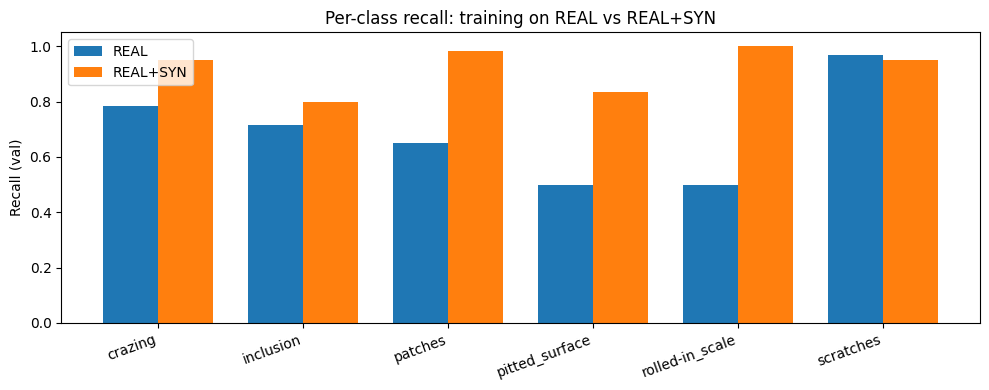

In [25]:
# ==== Compare per-class recall: REAL-only vs REAL+SYN ====
import numpy as np, torch, matplotlib.pyplot as plt
from PIL import Image

assert all(k in globals() for k in ['net_real','net_mix','ds_real_val','val_tf','class_names']), \
    "Run the TSTR cell first so net_real, net_mix, ds_real_val exist."

device = "cuda" if torch.cuda.is_available() else "cpu"
C = len(class_names)

def collect_preds(model, ds, tf):
    y_true, y_pred = [], []
    model.eval()
    with torch.no_grad():
        for path, y in ds.samples:
            x = tf(Image.open(path).convert("L")).unsqueeze(0).to(device)
            p = int(model(x).argmax(1).item())
            y_true.append(y); y_pred.append(p)
    return np.array(y_true), np.array(y_pred)

# REAL-only
y_t_r, y_p_r = collect_preds(net_real, ds_real_val, val_tf)
# REAL+SYN
y_t_m, y_p_m = collect_preds(net_mix,  ds_real_val, val_tf)

def per_class_recall(y_true, y_pred, C):
    rec = []
    for i in range(C):
        tp = ((y_true==i) & (y_pred==i)).sum()
        fn = ((y_true==i) & (y_pred!=i)).sum()
        rec.append(tp / max(1, tp+fn))
    return np.array(rec, dtype=float)

rec_R = per_class_recall(y_t_r, y_p_r, C)
rec_M = per_class_recall(y_t_m, y_p_m, C)

print("\nPer-class recall on REAL val set:")
print(f"{'class':16s}  {'REAL':>6s}  {'REAL+SYN':>9s}  {'Δ':>6s}")
for i,c in enumerate(class_names):
    print(f"{c:16s}  {rec_R[i]:6.3f}  {rec_M[i]:9.3f}  {rec_M[i]-rec_R[i]:6.3f}")

print(f"\nOverall accuracy — REAL-only: { (y_t_r==y_p_r).mean():.3f} | REAL+SYN: { (y_t_m==y_p_m).mean():.3f}")

# bar chart
x = np.arange(C)
w = 0.38
plt.figure(figsize=(10,4))
plt.bar(x-w/2, rec_R, width=w, label="REAL")
plt.bar(x+w/2, rec_M, width=w, label="REAL+SYN")
plt.xticks(x, class_names, rotation=20, ha="right")
plt.ylabel("Recall (val)")
plt.title("Per-class recall: training on REAL vs REAL+SYN")
plt.legend()
plt.tight_layout(); plt.show()


In [26]:
# Per-class quality filter -> synthetic_neu_32x32_pcflt/, then cap to target per class
import shutil, os
from pathlib import Path
import torch
from PIL import Image
import torchvision.transforms as T

assert all(k in globals() for k in ['model','class_names','device'])
SYN_DIR   = Path("synthetic_neu_32x32")
OUT_DIR   = Path("synthetic_neu_32x32_pcflt"); OUT_DIR.mkdir(exist_ok=True)
for c in class_names: (OUT_DIR/c).mkdir(parents=True, exist_ok=True)

# choose thresholds (tune freely)
PC_THR = {c:0.90 for c in class_names}
PC_THR['crazing']   = 0.82
PC_THR['inclusion'] = 0.86

val_tf_simple = T.Compose([T.Grayscale(1), T.Resize((32,32)), T.ToTensor()])

@torch.no_grad()
def filter_copy():
    model.eval()
    kept = {c:0 for c in class_names}
    for c in class_names:
        src = SYN_DIR/c
        files = sorted(list(src.glob("*.png")))
        for f in files:
            x = val_tf_simple(Image.open(f).convert("L")).unsqueeze(0).to(device)
            probs = torch.softmax(model(x), dim=1)[0]
            y = class_names.index(c)
            if probs[y].item() >= PC_THR[c]:
                shutil.copy2(f, OUT_DIR/c/f.name)
                kept[c]+=1
    return kept

kept = filter_copy()
print("Kept per class:", kept)

# Optional: cap per class to the same number (balanced sampler later)
TARGET = min(200, *(kept[c] for c in class_names))  # choose 200 or lower if some classes small
for c in class_names:
    files = sorted((OUT_DIR/c).glob("*.png"))
    for f in files[TARGET:]:
        f.unlink()
print("Balanced cap per class:", TARGET, "-> final counts:",
      {c: len(list((OUT_DIR/c).glob('*.png'))) for c in class_names})


Kept per class: {'crazing': 299, 'inclusion': 0, 'patches': 13, 'pitted_surface': 393, 'rolled-in_scale': 0, 'scratches': 0}
Balanced cap per class: 0 -> final counts: {'crazing': 0, 'inclusion': 0, 'patches': 0, 'pitted_surface': 0, 'rolled-in_scale': 0, 'scratches': 0}


## Q1 — Quantum Latent + Generator + Discriminator

Idea (simple):
z (noise) → PQC (AngleEmbedding + 2 entangling layers) → 8-D latent → concat class embedding → linear → 4×4×C → ConvT decoder → 32×32 image.

In [27]:
# ==== Q1 (updated): Multi-PQC Quantum-latent Generator + Discriminator + Sanity ====
import torch, torch.nn as nn
import pennylane as qml

# -------- setup --------
device = "cuda" if torch.cuda.is_available() else "cpu"
try:
    NCLS = len(class_names)
except NameError:
    class_names = ['crazing','inclusion','patches','pitted_surface','rolled-in_scale','scratches']
    NCLS = len(class_names)

# -------- PQC config (wider latent) --------
N_WIRES  = 6      # qubits per PQC
N_LAYERS = 2      # entangling layers per PQC
REPS     = 3      # number of parallel PQCs on different z slices
QL_OUT   = N_WIRES * REPS  # quantum latent size before the small linear head

# backend
try:
    base_dev = qml.device("lightning.qubit", wires=N_WIRES)
except Exception:
    base_dev = qml.device("default.qubit", wires=N_WIRES)

def q_circuit(inputs, weights):
    qml.AngleEmbedding(inputs, wires=range(N_WIRES), rotation="Y")
    qml.templates.StronglyEntanglingLayers(weights, wires=range(N_WIRES))
    return [qml.expval(qml.PauliZ(w)) for w in range(N_WIRES)]

w_shape = qml.templates.StronglyEntanglingLayers.shape(n_layers=N_LAYERS, n_wires=N_WIRES)

def make_torchlayer():
    qnode = qml.QNode(q_circuit, base_dev, interface="torch", diff_method="parameter-shift")
    return qml.qnn.TorchLayer(qnode, weight_shapes={"weights": w_shape})

# -------- Multi-PQC latent mapper --------
class QLatentMapper(nn.Module):
    """z -> split into REPS chunks of size N_WIRES -> REPS PQCs -> concat -> linear+tanh -> (QL_OUT)."""
    def __init__(self, z_dim=64, out_dim=QL_OUT):
        super().__init__()
        assert z_dim >= REPS*N_WIRES, "z_dim must be >= REPS*N_WIRES"
        self.pqcs = nn.ModuleList([make_torchlayer() for _ in range(REPS)])
        self.post = nn.Sequential(nn.Linear(QL_OUT, out_dim), nn.Tanh())
    def forward(self, z):
        z = z[:, :REPS*N_WIRES].to(torch.float32)              # (B, REPS*N_WIRES)
        z = torch.tanh(z) * 3.14159265                         # map to [-pi, pi]
        parts = []
        for r in range(REPS):
            zin = z[:, r*N_WIRES:(r+1)*N_WIRES]                # (B, N_WIRES)
            parts.append(self.pqcs[r](zin))                    # -> (B, N_WIRES)
        qcat = torch.cat(parts, dim=1)                         # (B, QL_OUT)
        return self.post(qcat)                                 # (B, QL_OUT)

# -------- Q-augmented Generator --------
class QGen(nn.Module):
    def __init__(self, z_dim=64, n_classes=NCLS, emb_dim=16, q_out=QL_OUT, width=64):
        super().__init__()
        self.embed = nn.Embedding(n_classes, emb_dim)
        self.qmap  = QLatentMapper(z_dim=z_dim, out_dim=q_out)
        in_dim = q_out + emb_dim
        self.net = nn.Sequential(
            nn.Linear(in_dim, 4*4*width*4),
            nn.BatchNorm1d(4*4*width*4), nn.ReLU(True),
            nn.Unflatten(1, (width*4, 4, 4)),
            nn.ConvTranspose2d(width*4, width*2, 4, 2, 1), nn.BatchNorm2d(width*2), nn.ReLU(True),  # 8x8
            nn.ConvTranspose2d(width*2, width,   4, 2, 1), nn.BatchNorm2d(width),   nn.ReLU(True),  # 16x16
            nn.ConvTranspose2d(width,   1,        4, 2, 1), nn.Tanh(),                               # 32x32
        )
    def forward(self, z, y):
        yemb = self.embed(y)          # (B, emb_dim)
        qlat = self.qmap(z)           # (B, QL_OUT)
        x = torch.cat([qlat, yemb], dim=1)
        return self.net(x)

# -------- Discriminator (same as before) --------
class ProjDiscR1(nn.Module):
    def __init__(self, n_classes=NCLS, width=48):
        super().__init__()
        c = width
        self.f = nn.Sequential(
            nn.Conv2d(1,   c,   3, 2, 1), nn.LeakyReLU(0.2, True),  # 16x16
            nn.Conv2d(c,   c*2, 3, 2, 1), nn.LeakyReLU(0.2, True),  # 8x8
            nn.Conv2d(c*2, c*4, 3, 2, 1), nn.LeakyReLU(0.2, True),  # 4x4
            nn.Conv2d(c*4, c*4, 3, 1, 1), nn.LeakyReLU(0.2, True),  # 4x4
        )
        self.lin   = nn.Linear(c*4, 1)
        self.embed = nn.Embedding(n_classes, c*4)
    def forward(self, x, y):
        h = self.f(x).sum(dim=(2,3))                    # (B, C)
        return self.lin(h).squeeze(1) + (self.embed(y)*h).sum(1)

# -------- instantiate + sanity --------
Z_DIM = 64
GQ    = QGen(z_dim=Z_DIM, width=64).to(device)
DQ    = ProjDiscR1(width=48).to(device)

print("QGen params:", f"{sum(p.numel() for p in GQ.parameters()):,}")
print("Disc  params:", f"{sum(p.numel() for p in DQ.parameters()):,}")

with torch.no_grad():
    zt = torch.randn(4, Z_DIM, device=device)
    yt = torch.tensor([0,1,2,3], device=device)
    xt = GQ(zt, yt)
    print("Sanity sample shape:", tuple(xt.shape))  # expect (4, 1, 32, 32)


QGen params: 809,059
Disc  params: 541,441
Sanity sample shape: (4, 1, 32, 32)


Epoch 1/20 — D 1.379 | G 3.319 | sigma 0.100 | cls_fakes 0.16666666666666666


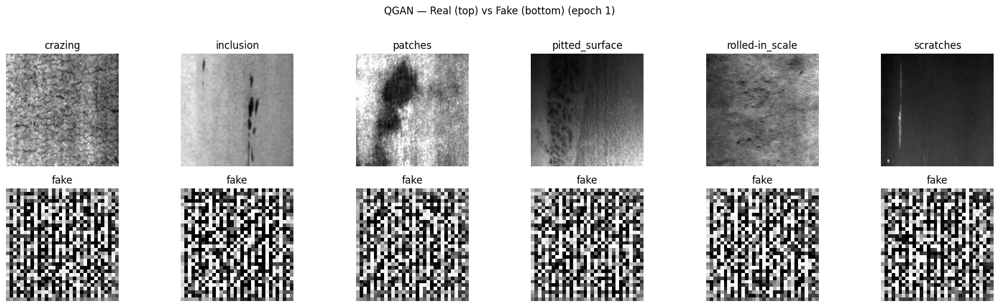

Epoch 2/20 — D 2.285 | G 1.056 | sigma 0.095 | cls_fakes 0.14166666666666666


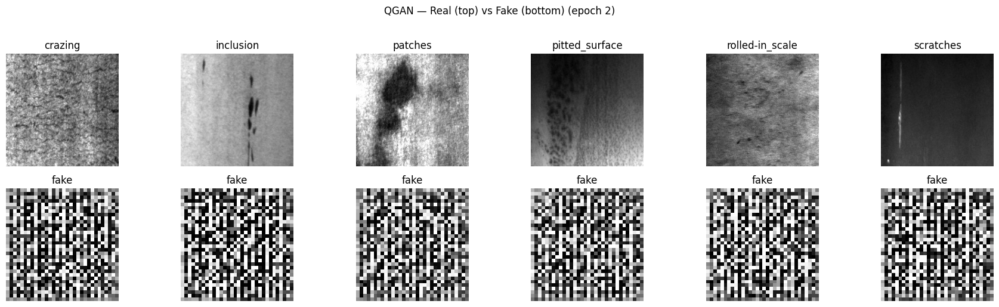

Epoch 3/20 — D 0.527 | G 5.205 | sigma 0.089 | cls_fakes 0.15


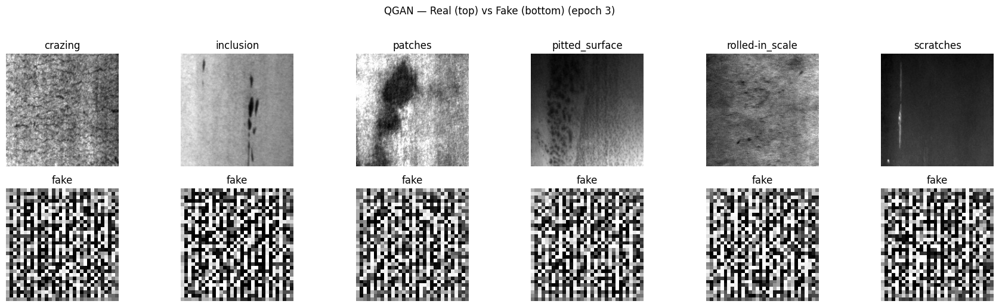

Epoch 4/20 — D 0.807 | G 6.745 | sigma 0.084 | cls_fakes 0.15


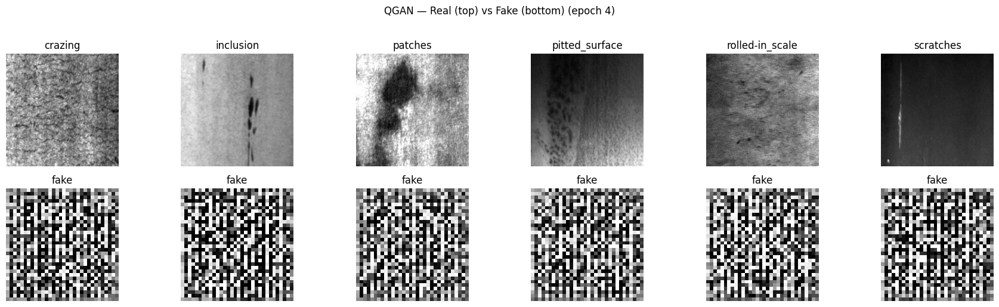

Epoch 5/20 — D 0.498 | G 5.999 | sigma 0.079 | cls_fakes 0.16666666666666666


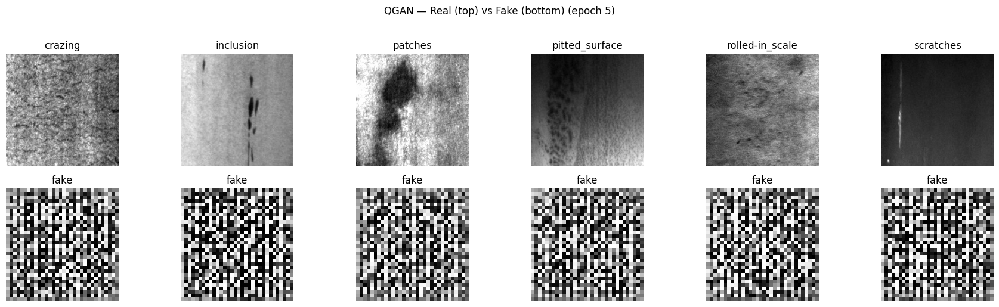

Epoch 6/20 — D 0.372 | G 1.544 | sigma 0.074 | cls_fakes 0.15


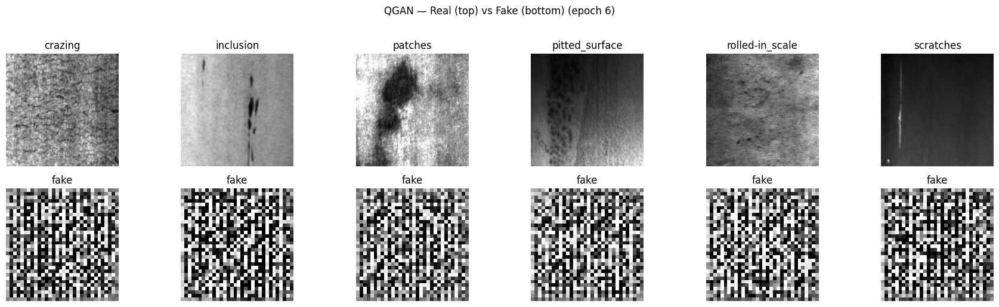

Epoch 7/20 — D 0.379 | G 2.725 | sigma 0.068 | cls_fakes 0.18333333333333332


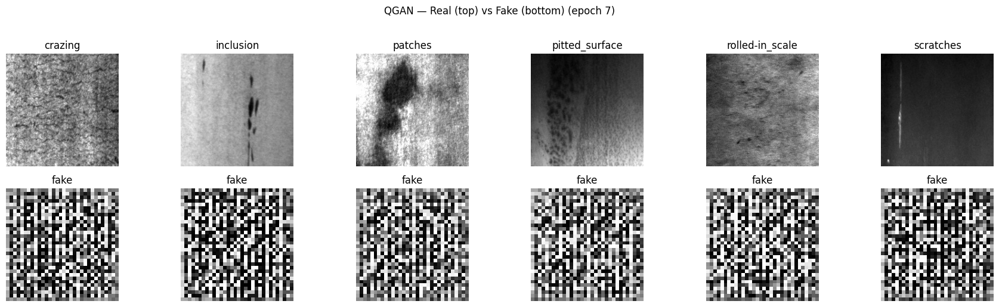

Epoch 8/20 — D 0.336 | G 3.748 | sigma 0.063 | cls_fakes 0.20833333333333334


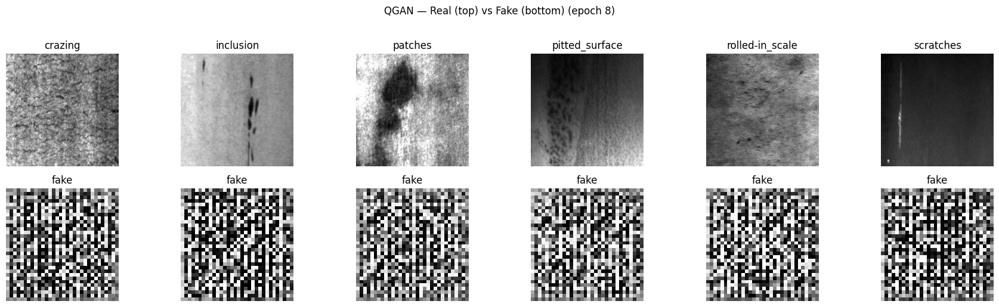

In [ ]:
# ==== Q2_train (patched): Train QGAN (hinge + R1 + instance noise + EMA) ====
import torch, torch.nn as nn, torch.optim as optim, torch.autograd as autograd
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

device = "cuda" if torch.cuda.is_available() else "cpu"
assert 'GQ' in globals() and 'DQ' in globals(), "Run Q1 cell first."

# dataloader fallback
if 'dl_gan' not in globals():
    import torchvision.transforms as T
    from torchvision.datasets import ImageFolder
    from PIL import ImageOps
    to_tensor = T.ToTensor()
    train_tf_gan = T.Compose([
        T.Grayscale(1), T.Resize((32,32)),
        T.Lambda(lambda im: ImageOps.autocontrast(im)),
        T.Lambda(lambda im: to_tensor(im)*2.0 - 1.0),
    ])
    ds_gan = ImageFolder(TRAIN_IMG_DIR, transform=train_tf_gan)
    from torch.utils.data import DataLoader
    dl_gan = DataLoader(ds_gan, batch_size=64, shuffle=True, drop_last=True, num_workers=0)

class_names = ds_gan.classes
NCLS, Z_DIM = len(class_names), 64

# losses & helpers
def d_hinge(rs, fs): return (nn.ReLU()(1-rs)).mean() + (nn.ReLU()(1+fs)).mean()
def g_hinge(fs):     return -fs.mean()
def add_noise(x, s): return (x + s*torch.randn_like(x)).clamp(-1,1) if s>0 else x
def denorm(x):       return (x.clamp(-1,1)+1)/2

# physics-informed losses (optional, ON)
USE_PHYS_LOSSES = True
if USE_PHYS_LOSSES:
    import torch.fft as fft
    H=W=32
    yy, xx = torch.meshgrid(torch.arange(H), torch.arange(W), indexing="ij")
    center = torch.tensor([(H-1)/2.0, (W-1)/2.0])
    rr = torch.sqrt((yy-center[0])**2 + (xx-center[1])**2)
    bin_edges = torch.linspace(0, rr.max()+1e-6, steps=17)
    bin_ids = (torch.bucketize(rr.reshape(-1), bin_edges)-1).reshape(H,W)

    def radial_power(imgs):
        B = imgs.size(0)
        x = imgs.squeeze(1) - imgs.squeeze(1).mean(dim=(1,2), keepdim=True)
        F = fft.fftshift(fft.fft2(x), dim=(1,2))
        P = (F.real**2 + F.imag**2).reshape(B, -1)
        bins = bin_ids.flatten().to(P.device)
        outs=[]
        for b in range(16):
            m = (bins==b).float(); denom = m.sum().clamp(min=1.)
            outs.append((P*m).sum(1)/denom)
        out = torch.stack(outs,1)
        return out/(out.sum(1,keepdim=True)+1e-8)

    def spectrum_match_loss(fake, real):
        return (radial_power(fake)-radial_power(real)).abs().mean()

    kx = torch.tensor([[-1,0,1],[-2,0,2],[-1,0,1]],dtype=torch.float32).view(1,1,3,3).to(device)
    ky = torch.tensor([[-1,-2,-1],[0,0,0],[1,2,1]],dtype=torch.float32).view(1,1,3,3).to(device)
    name2idx = {c:i for i,c in enumerate(class_names)}
    SCR = name2idx.get('scratches', None)
    INC = name2idx.get('inclusion', None)
    def vertical_streak_loss(fake, y):
        if SCR is None and INC is None: return fake.new_zeros(())
        mask = ((y==SCR) | (y==INC))
        if mask.sum()==0: return fake.new_zeros(())
        x = fake[mask]
        gx = nn.functional.conv2d(x, kx, padding=1)
        gy = nn.functional.conv2d(x, ky, padding=1)
        ratio = (gx.abs().mean((1,2,3)) / (gy.abs().mean((1,2,3)) + 1e-6))
        return ratio.mean()

# EMA
def ema_update(dst, src, decay=0.999):
    with torch.no_grad():
        for p,q in zip(dst.parameters(), src.parameters()):
            p.copy_(decay*p + (1-decay)*q)

GQ_ema = QGen(z_dim=Z_DIM, width=64).to(device)
GQ_ema.load_state_dict(GQ.state_dict())

# optim
optD = optim.Adam(DQ.parameters(), lr=1e-4, betas=(0.0,0.9))
optG = optim.Adam(GQ.parameters(),  lr=2e-4, betas=(0.0,0.9))

# fixed sampler + optional classifier proxy
z_fixed = torch.randn(NCLS, Z_DIM, device=device)
y_fixed = torch.arange(NCLS, device=device)
HAS_CLS = all(k in globals() for k in ['model','class_names'])

@torch.no_grad()
def cls_acc_on_fakes(Gshow, per_class=20):
    if not HAS_CLS: return None
    model.eval(); tot=ok=0
    for y in range(NCLS):
        yb = torch.full((per_class,), y, dtype=torch.long, device=device)
        zb = torch.randn(per_class, Z_DIM, device=device)
        x  = (Gshow(zb,yb)+1)/2
        pred = model(x).argmax(1).cpu().numpy()
        ok += (pred==y).sum(); tot += per_class
    return ok/tot

@torch.no_grad()
def sample_grid_Q(Gshow, note=""):
    idxs=[]; seen=set()
    for i,(p,y) in enumerate(ds_gan.samples):
        if y not in seen: seen.add(y); idxs.append(i)
        if len(seen)==NCLS: break
    f = Gshow(z_fixed, y_fixed).cpu()
    fig,ax=plt.subplots(2,NCLS,figsize=(3*NCLS,5))
    for c,i in enumerate(idxs):
        path,y = ds_gan.samples[i]
        pil = Image.open(path).convert("L")
        ax[0,c].imshow(pil,cmap="gray"); ax[0,c].set_title(class_names[y]); ax[0,c].axis("off")
        ax[1,c].imshow(denorm(f[c,0]).numpy(),cmap="gray"); ax[1,c].set_title("fake"); ax[1,c].axis("off")
    plt.suptitle(f"QGAN — Real (top) vs Fake (bottom) {note}", y=1.02); plt.tight_layout(); plt.show()

# train
EPOCHS   = 20
gamma_R1 = 1.0
sigma0   = 0.1
L_SPECT  = 5e-3
L_ORI    = 1e-2

for ep in range(1, EPOCHS+1):
    sigma = sigma0 * max(0.0, 1 - (ep-1)/(EPOCHS-1))
    for xb,yb in dl_gan:
        xb,yb = xb.to(device), yb.to(device)
        b = xb.size(0)

        # ---- D step with R1 (PATCHED: make xr require grad) ----
        z  = torch.randn(b, Z_DIM, device=device)
        with torch.no_grad():
            xf = GQ(z,yb)
        xr = add_noise(xb, sigma).detach().requires_grad_(True)  # <-- important
        xf = add_noise(xf, sigma)

        optD.zero_grad()
        rs = DQ(xr,yb)
        fs = DQ(xf,yb)
        d_main = d_hinge(rs, fs)

        r1 = autograd.grad(rs.sum(), xr, create_graph=True)[0]
        r1 = r1.pow(2).flatten(1).sum(1).mean()
        d_loss = d_main + 0.5 * gamma_R1 * r1
        d_loss.backward(); optD.step()

        # ---- G step ----
        z  = torch.randn(b, Z_DIM, device=device)
        fake = GQ(z,yb)
        g_loss = g_hinge(DQ(add_noise(fake, sigma), yb))
        if USE_PHYS_LOSSES:
            g_loss = g_loss + L_SPECT*spectrum_match_loss(fake, xb) + L_ORI*vertical_streak_loss(fake, yb)
        optG.zero_grad(); g_loss.backward(); optG.step()

        # EMA
        ema_update(GQ_ema, GQ, 0.999)

    acc = cls_acc_on_fakes(GQ_ema, 20)
    print(f"Epoch {ep}/{EPOCHS} — D {d_loss.item():.3f} | G {g_loss.item():.3f} | sigma {sigma:.3f} | cls_fakes {acc if acc is not None else 'NA'}")
    sample_grid_Q(GQ_ema, note=f"(epoch {ep})")

print("QGAN training done.")



In [ ]:
# === Cell: Quick QGAN sanity metrics (32x32) ===
import torch, torch.nn.functional as F
import numpy as np, matplotlib.pyplot as plt
from torchvision.utils import make_grid

device = next(GQ.parameters()).device  # your QGen
CLF = baseline_model_32.eval().to(device)  # <- your trained 32x32 classifier
CLASS_NAMES = ['crazing','inclusion','patches','pitted_surface','rolled-in_scale','scratches']

@torch.no_grad()
def sample_qgan(G, per_class=64, z_dim=64):
    xs, ys = [], []
    for c in range(len(CLASS_NAMES)):
        z = torch.randn(per_class, z_dim, device=device)
        y = torch.full((per_class,), c, device=device, dtype=torch.long)
        x = G(z, y).clamp(-1,1)
        xs.append(x); ys.append(y)
    return torch.cat(xs), torch.cat(ys)

def psd_radial(x_np):
    # x_np: (H,W) in [-1,1]
    fx = np.fft.fftshift(np.fft.fft2(x_np))
    pwr = np.abs(fx)**2
    H,W = pwr.shape; cy, cx = H//2, W//2
    R = min(cy, cx)
    bins = np.arange(R)
    acc = np.zeros(R); cnt = np.zeros(R)
    for y in range(H):
        for x in range(W):
            r = int(np.hypot(y-cy, x-cx))
            if r<R: acc[r]+=pwr[y,x]; cnt[r]+=1
    return acc/(cnt+1e-9)

def vert_streak_ratio(x_np):
    # energy in vertical edges vs total
    ky = np.array([[1,0,-1],[2,0,-2],[1,0,-1]], dtype=np.float32)
    kx = ky.T
    gy = F.conv2d(torch.from_numpy(x_np)[None,None], torch.from_numpy(ky)[None,None], padding=1).abs().sum().item()
    gx = F.conv2d(torch.from_numpy(x_np)[None,None], torch.from_numpy(kx)[None,None], padding=1).abs().sum().item()
    return gy / (gx + gy + 1e-9)

def score_set(G, per_class=200):
    Xf, Yf = sample_qgan(G, per_class=per_class)
    probs = CLF(Xf).softmax(1)
    pred  = probs.argmax(1)
    acc   = (pred==Yf).float().mean().item()

    # PSD & orientation: compare class means (real vs fake)
    import random, os, glob
    from PIL import Image
    def load_one_real(c):
        # expects your real images; adjust path if needed
        p = glob.glob(f"Data/NEU-DET/train/images/{CLASS_NAMES[c]}/*.jpg")[0]
        im = np.array(Image.open(p).convert("L").resize((32,32)), np.float32)/255.0
        im = (im*2-1)
        return im
    psd_real = []; psd_fake = []; ori_real=[]; ori_fake=[]
    for c in range(len(CLASS_NAMES)):
        xr = load_one_real(c)
        xf = Xf[Yf==c][0,0].cpu().numpy()
        psd_real.append(psd_radial(xr)); psd_fake.append(psd_radial(xf))
        ori_real.append(vert_streak_ratio(xr)); ori_fake.append(vert_streak_ratio(xf))
    return acc, psd_real, psd_fake, ori_real, ori_fake, (Xf, Yf)

acc, pr, pf, orr, of, (Xf, Yf) = score_set(GQ, per_class=64)
print(f"Classifier fidelity on fakes (overall): {acc:.3f}")

# quick grid
grid = make_grid(Xf[:48], nrow=12, normalize=True, value_range=(-1,1)).permute(1,2,0).cpu().numpy()
plt.figure(figsize=(10,4)); plt.imshow(grid, cmap="gray"); plt.axis("off"); plt.title("QGAN samples (first 48)"); plt.show()

# orientation check (scratches & inclusion)
scr_i = CLASS_NAMES.index("scratches"); inc_i = CLASS_NAMES.index("inclusion")
print("Vertical-streak ratio (real vs fake):")
print(f"  inclusion: {orr[inc_i]:.3f}  vs  {of[inc_i]:.3f}")
print(f"  scratches: {orr[scr_i]:.3f}  vs  {of[scr_i]:.3f}")


In [ ]:
# ==== Q3_export_score: Export quantum fakes + fidelity/diversity scores ====
from pathlib import Path
from PIL import Image
import numpy as np, torch
import torchvision.transforms as T
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader

assert 'GQ_ema' in globals(), "Train QGAN first."
SYN_DIR_Q = Path("synthetic_neu_q_32x32")
for c in class_names: (SYN_DIR_Q/c).mkdir(parents=True, exist_ok=True)

@torch.no_grad()
def dump_q_per_class(Gshow, cls_idx, n=200, batch=64):
    saved=0
    while saved<n:
        b=min(batch,n-saved)
        z=torch.randn(b,Z_DIM,device=device)
        y=torch.full((b,),cls_idx,dtype=torch.long,device=device)
        x=(Gshow(z,y).clamp(-1,1)+1)/2
        for i in range(b):
            arr=(x[i,0].cpu().numpy()*255).astype(np.uint8)
            Image.fromarray(arr).save(SYN_DIR_Q/class_names[cls_idx]/f"{class_names[cls_idx]}_q_{saved+i:04d}.png")
        saved+=b

print("Exporting quantum fakes…")
for ci,_ in enumerate(class_names): dump_q_per_class(GQ_ema, ci, n=200)
print("Done.")

# ---- reuse classifier features to score (FID-lite / fidelity / diversity) ----
def cls_features(model, x):
    with torch.no_grad():
        h = model.f(x); return h.flatten(1)

val_tf_32 = T.Compose([T.Grayscale(1), T.Resize((32,32)), T.ToTensor()])
real_ds = ImageFolder(VAL_IMG_DIR, transform=val_tf)
fake_ds = ImageFolder(str(SYN_DIR_Q), transform=val_tf_32)
real_loader = DataLoader(real_ds, batch_size=128, shuffle=False, num_workers=0)
fake_loader = DataLoader(fake_ds, batch_size=128, shuffle=False, num_workers=0)

def collect_feats(ds, loader):
    Fs, ys = [], []
    for xb,yb in loader:
        xb = xb.to(device)
        Fs.append(cls_features(model, xb).cpu().numpy()); ys.append(yb.numpy())
    return np.concatenate(Fs,0), np.concatenate(ys,0)

real_F, real_y = collect_feats(real_ds, real_loader)
fake_F, fake_y = collect_feats(fake_ds, fake_loader)

def fid_from_feats(F1, F2, eps=1e-6):
    m1, m2 = F1.mean(0), F2.mean(0)
    C1, C2 = np.cov(F1, rowvar=False), np.cov(F2, rowvar=False)
    A = C1.dot(C2); vals, vecs = np.linalg.eigh(A); vals = np.clip(vals,0,None)
    sqrtA = vecs.dot(np.diag(np.sqrt(vals))).dot(vecs.T)
    d = m1-m2
    return float(d.dot(d) + np.trace(C1 + C2 - 2*sqrtA))

FID_overall = fid_from_feats(real_F, fake_F)

@torch.no_grad()
def classifier_fidelity_on_folder(ds, loader):
    model.eval(); total=0; correct=0; per={c:[0,0] for c in class_names}
    for xb,yb in loader:
        logits = model(xb.to(device)); preds = logits.argmax(1).cpu().numpy(); yb = yb.numpy()
        total += len(yb); correct += (preds==yb).sum()
        for p,y in zip(preds,yb):
            name = class_names[y]; per[name][1]+=1; per[name][0]+=int(p==y)
    acc = correct/total; per = {k:(v[0]/max(1,v[1])) for k,v in per.items()}
    return acc, per

def mean_pairwise_dist(F):
    if len(F)<2: return 0.0
    rng = np.random.default_rng(0)
    idx = rng.choice(len(F), size=min(200,len(F)), replace=False)
    S = F[idx]; D = np.sqrt(((S[:,None,:]-S[None,:,:])**2).sum(2))
    iu = np.triu_indices(len(S),1); return float(D[iu].mean())

fidelity_overall, fidelity_per_class = classifier_fidelity_on_folder(fake_ds, fake_loader)
diversity_per_class = {class_names[i]: mean_pairwise_dist(fake_F[fake_y==i]) for i in range(len(class_names))}

print("\n=== Quantum synthetic (32×32) scores ===")
print(f"FID-lite (overall): {FID_overall:.3f}")
print(f"Classifier fidelity (overall): {fidelity_overall:.3f}")
print("Per-class fidelity:")
for c in class_names: print(f"  {c:16s}: {fidelity_per_class[c]:.3f}")
print("Per-class diversity:")
for c in class_names: print(f"  {c:16s}: {diversity_per_class[c]:.4f}")


In [ ]:
# ==== QF_filter: Per-class confidence filter for quantum fakes ====
import shutil
from pathlib import Path
import torchvision.transforms as T
from PIL import Image
import torch

SYN_DIR_Q   = Path("synthetic_neu_q_32x32")
SYN_DIR_QF  = Path("synthetic_neu_q_32x32_filtered"); SYN_DIR_QF.mkdir(exist_ok=True)
for c in class_names: (SYN_DIR_QF/c).mkdir(parents=True, exist_ok=True)

# thresholds (tune as you like)
PC_THR_Q = {c:0.90 for c in class_names}
PC_THR_Q['crazing']   = 0.85
PC_THR_Q['inclusion'] = 0.88

val_tf_simple = T.Compose([T.Grayscale(1), T.Resize((32,32)), T.ToTensor()])

@torch.no_grad()
def filter_copy_q():
    model.eval()
    kept = {c:0 for c in class_names}
    for c in class_names:
        for f in sorted((SYN_DIR_Q/c).glob("*.png")):
            x = val_tf_simple(Image.open(f).convert("L")).unsqueeze(0).to(device)
            probs = torch.softmax(model(x), dim=1)[0]
            y = class_names.index(c)
            if probs[y].item() >= PC_THR_Q[c]:
                shutil.copy2(f, SYN_DIR_QF/c/f.name); kept[c]+=1
    return kept

kept_q = filter_copy_q()
print("Quantum kept per class:", kept_q)


In [ ]:
# ==== TSTR_Q_v3 + Group Eval ====
import random, numpy as np, torch, torch.nn as nn, torch.optim as optim
from pathlib import Path
from collections import Counter
from torch.utils.data import DataLoader, ConcatDataset, WeightedRandomSampler
from torchvision.datasets import ImageFolder
import torchvision.transforms as T
from PIL import Image, ImageOps

device = "cuda" if torch.cuda.is_available() else "cpu"
random.seed(42); np.random.seed(42); torch.manual_seed(42)

# transforms
train_tf = T.Compose([
    T.Grayscale(1), T.Resize((32,32)),
    T.Lambda(lambda im: ImageOps.autocontrast(im)),
    T.RandomHorizontalFlip(0.5), T.ToTensor(),
])
val_tf = T.Compose([
    T.Grayscale(1), T.Resize((32,32)),
    T.Lambda(lambda im: ImageOps.autocontrast(im)), T.ToTensor(),
])

# datasets
ds_real_train = ImageFolder(TRAIN_IMG_DIR, transform=train_tf)
ds_real_val   = ImageFolder(VAL_IMG_DIR,   transform=val_tf)
SYN_DIR_USE   = Path("synthetic_neu_q_32x32_filtered")
ds_syn_q      = ImageFolder(str(SYN_DIR_USE), transform=train_tf)

# domain-weighted, class-balanced sampler
def make_mix_loader(ds_real, ds_syn, batch_size=64, p_syn=0.35, per_class_syn_scale=None):
    mix = ConcatDataset([ds_real, ds_syn])
    y_real, y_syn = ds_real.targets, ds_syn.targets
    n_real, n_syn = len(y_real), len(y_syn)
    cnt_real, cnt_syn = Counter(y_real), Counter(y_syn)
    w_real_c = {c: 1.0/max(1,cnt_real[c]) for c in cnt_real}
    w_syn_c  = {c: 1.0/max(1,cnt_syn[c])  for c in cnt_syn}
    weights = [w_real_c[y] for y in y_real] + [w_syn_c[y] for y in y_syn]
    sum_real, sum_syn = sum(weights[:n_real]), sum(weights[n_real:])
    alpha = ((p_syn/(1-p_syn)) * (sum_real/max(1e-8,sum_syn)))
    pc = per_class_syn_scale or {}
    def syn_scale(y_idx): return float(pc.get(class_names[y_idx], 1.0))
    for i in range(n_real, n_real+n_syn):
        y = y_syn[i-n_real]
        weights[i] *= alpha * syn_scale(y)
    sampler = WeightedRandomSampler(weights, num_samples=len(weights), replacement=True)
    return DataLoader(mix, batch_size=batch_size, sampler=sampler, num_workers=0)

# classifier
class SimpleCNN32(nn.Module):
    def __init__(self, in_ch=1, num_classes=len(class_names), width=24, p_drop=0.2):
        super().__init__()
        w=width
        self.f = nn.Sequential(
            nn.Conv2d(in_ch, w, 3, 2, 1), nn.BatchNorm2d(w), nn.ReLU(True),
            nn.Conv2d(w, w*2, 3, 2, 1),  nn.BatchNorm2d(w*2), nn.ReLU(True),
            nn.Conv2d(w*2, w*2, 3, 2, 1),nn.BatchNorm2d(w*2), nn.ReLU(True),
            nn.Conv2d(w*2, w*4, 3, 1, 1),nn.BatchNorm2d(w*4), nn.ReLU(True),
            nn.AdaptiveAvgPool2d(1),
        )
        self.drop = nn.Dropout(p_drop)
        self.head = nn.Linear(w*4, num_classes)
    def forward(self, x):
        x = self.f(x).flatten(1); x = self.drop(x); return self.head(x)

def eval_acc(net, loader):
    net.eval(); n=0; ok=0
    with torch.no_grad():
        for xb,yb in loader:
            xb,yb = xb.to(device), yb.to(device)
            ok += (net(xb).argmax(1)==yb).float().sum().item()
            n  += xb.size(0)
    return ok/n

def train_curriculum_mix(ds_syn, p_syn=0.35, pcs=None, epochs=(3,6,2)):
    net = SimpleCNN32().to(device)
    opt = optim.Adam(net.parameters(), lr=1e-3, weight_decay=1e-4)
    lossf = nn.CrossEntropyLoss(label_smoothing=0.1)
    tr_real = DataLoader(ds_real_train, batch_size=64, shuffle=True, num_workers=0)
    va_real = DataLoader(ds_real_val,   batch_size=64, shuffle=False, num_workers=0)
    # warmup
    for ep in range(1,epochs[0]+1):
        net.train()
        for xb,yb in tr_real:
            xb,yb = xb.to(device), yb.to(device)
            opt.zero_grad(); ls = lossf(net(xb), yb); ls.backward(); opt.step()
        print(f"[Warm {ep}/{epochs[0]}] val {eval_acc(net, va_real):.3f}")
    # mix
    tr_mix = make_mix_loader(ds_real_train, ds_syn, batch_size=64, p_syn=p_syn, per_class_syn_scale=pcs)
    for ep in range(1,epochs[1]+1):
        net.train()
        for xb,yb in tr_mix:
            xb,yb = xb.to(device), yb.to(device)
            opt.zero_grad(); ls = lossf(net(xb), yb); ls.backward(); opt.step()
        print(f"[Mix  {ep}/{epochs[1]}] val {eval_acc(net, va_real):.3f}")
    # finetune real
    for ep in range(1,epochs[2]+1):
        net.train()
        for xb,yb in tr_real:
            xb,yb = xb.to(device), yb.to(device)
            opt.zero_grad(); ls = lossf(net(xb), yb); ls.backward(); opt.step()
        print(f"[FT   {ep}/{epochs[2]}] val {eval_acc(net, va_real):.3f}")
    final = eval_acc(net, va_real)
    print("Final REAL-val acc:", round(final,3))
    return net, final

# Train with quantum synthetic
pcs_q = {'pitted_surface': 0.8}  # downweight if needed
net_qmix_v3, acc_qmix_v3 = train_curriculum_mix(ds_syn_q, p_syn=0.35, pcs=pcs_q, epochs=(3,6,2))

# ---- Grouped evaluation (All, G1, G2) ----
G1 = ['crazing','patches','pitted_surface','rolled-in_scale']
G2 = ['inclusion','scratches']
name2idx = {c:i for i,c in enumerate(class_names)}
idxG1 = sorted([name2idx[c] for c in G1])
idxG2 = sorted([name2idx[c] for c in G2])

def eval_group_acc(model, ds_val, tf, idx_subset):
    model.eval(); ok=tot=0
    with torch.no_grad():
        for path,y in ds_val.samples:
            if y not in idx_subset: continue
            x = tf(Image.open(path).convert("L")).unsqueeze(0).to(device)
            ok += int(model(x).argmax(1).item()==y); tot+=1
    return ok/max(1,tot)

all_loader = DataLoader(ds_real_val, batch_size=64, shuffle=False, num_workers=0)
print("\nQuantum TSTR v3 — Accuracies on REAL val:")
print("All :", eval_acc(net_qmix_v3, all_loader))
print("G1  :", eval_group_acc(net_qmix_v3, ds_real_val, val_tf, idxG1))
print("G2  :", eval_group_acc(net_qmix_v3, ds_real_val, val_tf, idxG2))

# If classical TSTR v3 model exists, show side-by-side
if 'net_mix_v3' in globals():
    print("\nClassical TSTR v3 — Accuracies on REAL val:")
    print("All :", eval_acc(net_mix_v3, all_loader))
    print("G1  :", eval_group_acc(net_mix_v3, ds_real_val, val_tf, idxG1))
    print("G2  :", eval_group_acc(net_mix_v3, ds_real_val, val_tf, idxG2))


In [ ]:
# ==== Cell 5B: 64x64 with Grayscale + Autocontrast + Dropout + Weight Decay ====

import torch, numpy as np, random
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import torchvision.transforms as T
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
from PIL import Image, ImageOps
from pathlib import Path

assert 'TRAIN_IMG_DIR' in globals() and 'VAL_IMG_DIR' in globals() and 'class_names' in globals()

device = "cuda" if torch.cuda.is_available() else "cpu"
IMG_SIZE  = 64
BATCH_SIZE= 32
LR        = 1e-3
WEIGHT_DECAY = 1e-4
MAX_EPOCHS= 12
PATIENCE  = 3
N_CLASSES = len(class_names)

# --- Grayscale + Autocontrast transforms ---
train_tfms = T.Compose([
    T.Grayscale(num_output_channels=1),
    T.Resize((IMG_SIZE, IMG_SIZE)),
    T.Lambda(lambda im: ImageOps.autocontrast(im)),  # normalize contrast per-image
    T.ToTensor(),
])

val_tfms = T.Compose([
    T.Grayscale(num_output_channels=1),
    T.Resize((IMG_SIZE, IMG_SIZE)),
    T.Lambda(lambda im: ImageOps.autocontrast(im)),
    T.ToTensor(),
])

ds_train = ImageFolder(TRAIN_IMG_DIR, transform=train_tfms)
ds_val   = ImageFolder(VAL_IMG_DIR,   transform=val_tfms)
train_loader = DataLoader(ds_train, batch_size=BATCH_SIZE, shuffle=True,  num_workers=0)
val_loader   = DataLoader(ds_val,   batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

# --- Model (dropout before head) ---
class SimpleCNNDo(nn.Module):
    def __init__(self, in_ch=1, num_classes=6, width=16, p_drop=0.2):
        super().__init__()
        c1, c2, c3, c4 = width, width*2, width*2, width*4
        self.features = nn.Sequential(
            nn.Conv2d(in_ch, c1, 3, stride=2, padding=1), nn.BatchNorm2d(c1), nn.ReLU(inplace=True),
            nn.Conv2d(c1, c2, 3, stride=2, padding=1), nn.BatchNorm2d(c2), nn.ReLU(inplace=True),
            nn.Conv2d(c2, c3, 3, stride=2, padding=1), nn.BatchNorm2d(c3), nn.ReLU(inplace=True),
            nn.Conv2d(c3, c4, 3, stride=2, padding=1), nn.BatchNorm2d(c4), nn.ReLU(inplace=True),
            nn.AdaptiveAvgPool2d((1,1)),
        )
        self.dropout = nn.Dropout(p_drop)
        self.head = nn.Linear(c4, num_classes)
    def forward(self, x):
        x = self.features(x).flatten(1)
        x = self.dropout(x)
        return self.head(x)

model = SimpleCNNDo(in_ch=1, num_classes=N_CLASSES, width=16, p_drop=0.2).to(device)

# --- Helpers ---
def batch_accuracy(logits, y): return (logits.argmax(1) == y).float().mean().item()
@torch.no_grad()
def evaluate(model, loader, lossf, device):
    model.eval()
    total_loss, total_acc, n = 0.0, 0.0, 0
    for x,y in loader:
        x,y = x.to(device), y.to(device)
        logits = model(x); loss = lossf(logits, y)
        bs = x.size(0); n += bs
        total_loss += loss.item()*bs
        total_acc  += batch_accuracy(logits, y)*bs
    return total_loss/n, total_acc/n

def pick_one_index_per_class(ds, class_names, seed=42):
    rng = random.Random(seed); idxs = list(range(len(ds.samples))); rng.shuffle(idxs)
    chosen = {}
    for i in idxs:
        _, y = ds.samples[i]; cls = class_names[y]
        if cls not in chosen: chosen[cls] = i
        if len(chosen) == len(class_names): break
    return [chosen[c] for c in class_names]

def to_display_np(t): 
    a = t.permute(1,2,0).cpu().numpy(); 
    return (a - a.min())/(a.max()-a.min()+1e-8)

@torch.no_grad()
def show_pred_grid(model, ds_val, idxs, class_names, title_note=""):
    fig, axes = plt.subplots(2, len(class_names), figsize=(3*len(class_names), 6))
    for col, i in enumerate(idxs):
        path, gt_idx = ds_val.samples[i]
        pil = Image.open(path).convert("L")
        x_t = val_tfms(pil).unsqueeze(0).to(device)
        pred_idx = int(model(x_t).argmax(1).item())
        axes[0,col].imshow(pil, cmap="gray"); axes[0,col].set_title(class_names[gt_idx]); axes[0,col].axis("off")
        axes[1,col].imshow(to_display_np(x_t.squeeze(0).cpu()), cmap="gray")
        axes[1,col].set_title(f"gt→{class_names[gt_idx]} | pred→{class_names[pred_idx]}"); axes[1,col].axis("off")
    plt.suptitle(f"Val predictions — one per class {title_note}", y=1.02); plt.tight_layout(); plt.show()

# --- Train ---
opt   = optim.Adam(model.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)
lossf = nn.CrossEntropyLoss()
best_acc, pat_left = -1, PATIENCE
val_idxs_6 = pick_one_index_per_class(ds_val, class_names, seed=42)
train_hist, val_hist = {"loss": [], "acc": []}, {"loss": [], "acc": []}

for ep in range(1, MAX_EPOCHS+1):
    model.train(); tl, ta, n = 0.0, 0.0, 0
    for xb, yb in train_loader:
        xb, yb = xb.to(device), yb.to(device)
        opt.zero_grad(); logits = model(xb); loss = lossf(logits, yb)
        loss.backward(); opt.step()
        bs = xb.size(0); n += bs
        tl += loss.item()*bs; ta += batch_accuracy(logits, yb)*bs
    tl, ta = tl/n, ta/n
    vl, va = evaluate(model, val_loader, lossf, device)
    train_hist["loss"].append(tl); train_hist["acc"].append(ta)
    val_hist["loss"].append(vl);   val_hist["acc"].append(va)
    print(f"Epoch {ep}/{MAX_EPOCHS} — Train: {ta:.3f} | Val: {va:.3f}")

    show_pred_grid(model, ds_val, val_idxs_6, class_names, title_note=f"(64×64 gray+AC ep{ep})")

    if va > best_acc + 1e-4:
        best_acc, pat_left = va, PATIENCE
        best_state = {k: v.cpu().clone() for k,v in model.state_dict().items()}
        print(f"  ↑ New best val acc: {best_acc:.3f}")
    else:
        pat_left -= 1
        print(f"  no improvement, patience left: {pat_left}")
        if pat_left <= 0: print("Early stopping."); break

if 'best_state' in globals():
    model.load_state_dict({k: v.to(device) for k,v in best_state.items()})


In [ ]:
# ==== Side-by-side: Original vs 64x64 vs 32x32 (one per class) ====

from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import torchvision.transforms as T
import random

assert 'VAL_IMG_DIR' in globals() and 'class_names' in globals(), "Run the path + dataset cells first."

# Use current color mode (RGB=3 or Gray=1)
IN_CH = 3 if 'IN_CH' not in globals() else IN_CH
color_mode = "RGB" if IN_CH == 3 else "L"

# Transforms for display
tf64 = T.Compose([
    (T.Lambda(lambda im: im.convert("RGB")) if IN_CH==3 else T.Grayscale(num_output_channels=1)),
    T.Resize((64, 64)),
    T.ToTensor(),
])
tf32 = T.Compose([
    (T.Lambda(lambda im: im.convert("RGB")) if IN_CH==3 else T.Grayscale(num_output_channels=1)),
    T.Resize((32, 32)),
    T.ToTensor(),
])

# Build a plain ImageFolder (no transform) just to list files/class indices
from torchvision.datasets import ImageFolder
ds_val_plain = ImageFolder(VAL_IMG_DIR)  # no transform

def pick_one_index_per_class(ds, class_names, seed=42):
    rng = random.Random(seed)
    idxs = list(range(len(ds.samples)))
    rng.shuffle(idxs)
    chosen = {}
    for i in idxs:
        _, y = ds.samples[i]
        name = class_names[y]
        if name not in chosen:
            chosen[name] = i
        if len(chosen) == len(class_names):
            break
    return [chosen[c] for c in class_names]

def to_disp_np(t):
    a = t.permute(1,2,0).numpy()
    return (a - a.min()) / (a.max() - a.min() + 1e-8)

idxs = pick_one_index_per_class(ds_val_plain, class_names, seed=42)

# Collect originals + transformed
orig_imgs, imgs64, imgs32, names = [], [], [], []
for i in idxs:
    path, y = ds_val_plain.samples[i]
    names.append(Path(path).name)
